In [10]:
import numpy as np
import fipy as fp
from fipy import Gmsh2D
import pandas as pd
from matplotlib import pyplot as plt
from matplotlib import cm
import os
import re
import pdb
import h5py
import pdb

## Create Mesh for all the simulations

In [11]:
def create_circular_mesh(radius,cellSize):
    """
    Function creates circular 2D mesh

    **Input**

    -   radius   =   Radius of mesh
    -   cellSize    =   Size of unit cell

    *Note* : No support for 3D meshes currently and **requires GMSH**
    """

    mesh = Gmsh2D('''
                     cellSize = %g;
                     radius = %g;
                     Point(1) = {0, 0, 0, cellSize};
                     Point(2) = {-radius, 0, 0, cellSize};
                     Point(3) = {0, radius, 0, cellSize};
                     Point(4) = {radius, 0, 0, cellSize};
                     Point(5) = {0, -radius, 0, cellSize};
                     Circle(6) = {2, 1, 3};


                    Circle(7) = {3, 1, 4};
                    Circle(8) = {4, 1, 5};
                    Circle(9) = {5, 1, 2};
                    Line Loop(10) = {6, 7, 8, 9};
                    Plane Surface(11) = {10};

       '''%(cellSize,radius)) # doctest: +GMSH


    return(mesh)

In [12]:
nx = 300
dx = 0.1
mesh = create_circular_mesh(radius=float(nx)*dx/2,cellSize=dx*1.5)

In [4]:
phi = fp.CellVariable(mesh=mesh, value = 1.0)

In [9]:
b = np.divide(phi,0.5-phi)
print(b[1:10])

[-2. -2. -2. -2. -2. -2. -2. -2. -2.]


## Variables to track when studying dynamics:

### Dynamical variables:
1. Avg. protein concentration in condensate (set some threshold for protein concentration)
2. Area of condensate
3. Avg. concentration of lncRNA in condensate (make sure that any negative values of lncRNA are set to 0)
4. Avg. concentration of mRNA in condensate 
5. Molar rate of production of mRNA (simply the integral(production rate dv))
6. Net rate of mRNA increase integral(production - degradation)dv
7. Amount of mRNA in the system
8. Rates of change of protein concentration in condensate vs. time
9. Rate of change of area of condensate vs. time 
10. Rate of change of lncRNA concentration in condensate vs. time
11. Avg. protein concentration in lncrna locus 
12. Avg. concentration of lncRNA in lncrna locus 
13. Avg. concentration of mRNA in lncrna locus
14. Rates of change of above three quantities
15. Flux of protein into condensate
16. Flux of lncrna into condensate
17. Flux of mrna into condensate
18. Production rate of mrna in condensate
19. Degradation rate of mrna in condensate
20. Flux of protein into lncrna well
21. Flux of lncrna into lncrna well
22. Flux of mrna into lncrna well

### Steady state values: (as a function of one parameter, with legends for other parameters)

1. Avg. protein concentration in condensate (set some threshold for protein concentration)
2. Area of condensate
3. Avg. concentration of lncRNA in condensate (make sure that any negative values of lncRNA are set to 0)
4. Amount of mRNA in the system
5. Molar rate of production of mRNA (simply the integral(production rate dv))
6. Avg. protein concentration in lncrna locus 
7. Avg. concentration of lncRNA in lncrna locus 
8. Avg. concentration of mRNA in lncrna locus

### Characteristics of the dynamics:

**Peak values of:**
1. Avg. protein concentration in condensate (set some threshold for protein concentration)
2. Area of condensate
3. Avg. concentration of lncRNA in condensate (make sure that any negative values of lncRNA are set to 0)
4. Molar rate of production of mRNA (simply the integral(production rate dv))
5. Rate of change of condensate area vs. time
6. Rate of change of protein concentration in condensate vs. time

**Time to reach peak value**

1. Avg. protein concentration in condensate (set some threshold for protein concentration)
2. Area of condensate
3. Avg. concentration of lncRNA in condensate (make sure that any negative values of lncRNA are set to 0)
4. Molar rate of production of mRNA (simply the integral(production rate dv))
5. Rate of change of condensate area vs. time
6. Rate of change of protein concentration in condensate vs. time

**Initiation time (time taken to form a condensate)**

### Note: The best approach is to:

1. Generate time trajectories for all the above dynamical variables for all the simulations, and then store it somewhere. This probably requires writing a python script and run it as a job. The trajectories of the dyanmical variables can in fact be stored in the same directory as we read the data from.

2. Interrogate this data repository using this Jupyter notebook

### Python script

In [4]:
import ast

def input_parse(filename):
    """
    Parses input files (filename is path to input parameters or param_list file)

    params_flag toggles between input_params vs param_list
    """

    input_parameters  ={}
    with open(filename, 'r') as f:
        count = 0

        for line in f:
            line=line.strip()
            if line:
                if line.find('#') == -1:
                    var_name,var_value = line.split(',')[0],",".join(line.split(',')[1:]) # handle lines with more than 1 comma
                    if var_name != 'output_dir':
                        try:
                            input_parameters[var_name] = float(var_value)
                        except ValueError: # This occurs when python cannot convert list into a float.
                            # Evaluate the python expression as a list
                            input_parameters[var_name] = ast.literal_eval(var_value)
    return input_parameters

In [34]:
def generate_dynamical_trajectories(target_directory, file_name_pattern, condensate_concentration_cutoff = 0.2):

    dynamical_trajectory_file_name = 'dynamical_trajectories.hdf5'
    dynamical_variables = ['steps', 't', 'average_protein_in_condensate', 'average_lncrna_in_condensate', 
                                   'average_mrna_in_condensate', 'molar_rate_of_mrna_production', 'net_rate_of_mrna_increase', 
                                   'condensate_area', 'total_amount_of_mrna']
    
    for root, dirs, files in os.walk(target_directory):

        regex = re.compile(file_name_pattern)
        match = re.search(regex, root)

        if match != None:
            
            stats_file_name = root + '/stats.txt'
            df_stats = pd.read_csv(stats_file_name, '\t')

            times = df_stats['t']
            steps = df_stats['step']

            param_file = root + '/input_params.txt'
            input_parameters = input_parse(param_file) 

            with h5py.File(os.path.join(root + '/' + dynamical_trajectory_file_name), 'w') as dt_f:
                for dv in dynamical_variables:
                    dt_f.create_dataset(dv, shape=(len(steps),1))

            spatial_variable_hdf5_file_name = root + '/spatial_variables.hdf5'

            with h5py.File(spatial_variable_hdf5_file_name) as sp_f:      
                with h5py.File(os.path.join(root + '/' + dynamical_trajectory_file_name), 'a') as dt_f:
                    
                    dt_f['steps'][:,0] = steps
                    dt_f['t'][:,0] = times
                    
                    indices_enhancer_region = (mesh.x-0.5*input_parameters['rna_nucleus_distance_to_protein'])**2 + mesh.y**2 - 1.0*input_parameters['sigma']**2 < 0
                    indices_lncrna_region = (mesh.x+0.5*input_parameters['rna_nucleus_distance_to_protein'])**2 + mesh.y**2 - 1.0*input_parameters['L_R']**2 < 0
                    
                    for s in range(len(steps)):

                        phi_p = fp.CellVariable(mesh=mesh, value = sp_f['phi_p'][s])
                        phi_m = fp.CellVariable(mesh=mesh, value = sp_f['phi_m'][s])
                        phi_r = fp.CellVariable(mesh=mesh, value = sp_f['phi_r'][s])

                        indices = phi_p.value > condensate_concentration_cutoff                    

                        if np.any(indices):
                            dt_f['average_protein_in_condensate'][s] = np.sum(phi_p.value[indices]*mesh.cellVolumes[indices])/np.sum(mesh.cellVolumes[indices])
                            dt_f['condensate_area'][s] = np.sum(mesh.cellVolumes[indices])
                            dt_f['average_mrna_in_condensate'][s] = np.sum(phi_m.value[indices]*mesh.cellVolumes[indices])/np.sum(mesh.cellVolumes[indices])
                            dt_f['average_lncrna_in_condensate'][s] = np.sum(phi_r.value[indices]*mesh.cellVolumes[indices])/np.sum(mesh.cellVolumes[indices])
                            if dt_f['average_lncrna_in_condensate'][s] < 0.0:
                                dt_f['average_lncrna_in_condensate'][s] = 0.0
                        else:
                            dt_f['average_protein_in_condensate'][s] = 0.0
                            dt_f['condensate_area'][s] = 0.0
                            dt_f['average_mrna_in_condensate'][s] = 0.0
                            dt_f['average_lncrna_in_condensate'][s] = 0.0
                        
#                         dt_f['average_lncrna_in_condensate'][s] = np.sum(phi_r.value[indices_enhancer_region]*mesh.cellVolumes[indices_enhancer_region])/np.sum(mesh.cellVolumes[indices_enhancer_region])
#                         if dt_f['average_lncrna_in_condensate'][s] < 0.0:
#                             dt_f['average_lncrna_in_condensate'][s] = 0.0
                        
                        dt_f['average_protein_in_lncrna_well'][s] = np.sum(phi_p.value[indices_lncrna_region]*mesh.cellVolumes[indices_lncrna_region])/np.sum(mesh.cellVolumes[indices_lncrna_region])
                        dt_f['average_mrna_in_lncrna_well'][s] = np.sum(phi_m.value[indices_lncrna_region]*mesh.cellVolumes[indices_lncrna_region])/np.sum(mesh.cellVolumes[indices_lncrna_region])
                        dt_f['average_lncrna_in_lncrna_well'][s] = np.sum(phi_r.value[indices_lncrna_region]*mesh.cellVolumes[indices_lncrna_region])/np.sum(mesh.cellVolumes[indices_lncrna_region])
                        dt_f['total_amount_of_mrna'][s] = np.sum(phi_m.value*mesh.cellVolumes)
                        
                        if input_parameters['reaction_rate'] == 0.0:
                            dt_f['molar_rate_of_mrna_production'][s] =  np.sum((input_parameters['k_p_max']*(phi_p - input_parameters['protein_threshold_mRNA_production'])*(phi_p > input_parameters['protein_threshold_mRNA_production'])).value*mesh.cellVolumes)
                            dt_f['net_rate_of_mrna_increase'][s] =  np.sum((input_parameters['k_p_max']*(phi_p - input_parameters['protein_threshold_mRNA_production'])*(phi_p > input_parameters['protein_threshold_mRNA_production'])-input_parameters['k_degradation']*phi_m).value*mesh.cellVolumes)
                        elif input_parameters['reaction_rate'] == 1.0:
                            dt_f['molar_rate_of_mrna_production'][s] =  np.sum((input_parameters['k_p_max']*(phi_p > input_parameters['protein_threshold_mRNA_production'])).value*mesh.cellVolumes)
                            dt_f['net_rate_of_mrna_increase'][s] =  np.sum((input_parameters['k_p_max']*(phi_p > input_parameters['protein_threshold_mRNA_production'])-input_parameters['k_degradation']*phi_m).value*mesh.cellVolumes)
                        elif input_parameters['reaction_rate'] == 2.0:
                            kpx = input_parameters['k_p_max']*np.exp(-((mesh.cellCenters[0]+0.5*input_parameters['rna_nucleus_distance_to_protein'])**2 + (mesh.cellCenters[1])**2)/input_parameters['spread_kp']**2)
                            dt_f['molar_rate_of_mrna_production'][s] =  np.sum(kpx.value*phi_p.value*mesh.cellVolumes)
                            dt_f['net_rate_of_mrna_increase'][s] =  np.sum((kpx*phi_p-input_parameters['k_degradation']*phi_m).value*mesh.cellVolumes)

### Generate trajectories for condensates with activity

In [ ]:
only_activity_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/LINEAR_0.0"
only_activity_file_name_pattern = r'.*phi_r_.*_L_P_.*_k_p_.*_reactiontype_.*_thresh_.*_FE_.*_rhoc_2.0$'

generate_dynamical_trajectories(only_activity_directory, only_activity_file_name_pattern, condensate_concentration_cutoff = 0.2)

In [61]:
only_activity_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/LINEAR_0.4"
only_activity_file_name_pattern = r'.*phi_r_.*_L_P_.*_k_p_.*_reactiontype_.*_thresh_.*_FE_.*_rhoc_2.0$'

generate_dynamical_trajectories(only_activity_directory, only_activity_file_name_pattern, condensate_concentration_cutoff = 0.4)

In [6]:
only_activity_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/STEP_0.4"
only_activity_file_name_pattern = r'.*phi_r_.*_L_P_.*_k_p_.*_reactiontype_.*_thresh_.*_FE_.*_rhoc_2.0$'

generate_dynamical_trajectories(only_activity_directory, only_activity_file_name_pattern, condensate_concentration_cutoff = 0.2)

In [26]:
only_activity_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/"
only_activity_file_name_pattern = r'.*k_p_.*_reactiontype_.*_thresh_.*_FE_.*_rhoc_.*Mmrna_0.01$'

generate_dynamical_trajectories(only_activity_directory, only_activity_file_name_pattern, condensate_concentration_cutoff = 0.2)

In [36]:
only_activity_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/LOCALIZED_MRNA_PRODUCTION/phi_p_0_0.1_kappa_0.5_sigma_5.0_T_150/"
only_activity_file_name_pattern = r'.*k_p_.*_reactiontype_.*_thresh_.*_FE_.*_rhoc_.*Mmrna_0.01$'

generate_dynamical_trajectories(only_activity_directory, only_activity_file_name_pattern, condensate_concentration_cutoff = 0.2)

In [6]:
only_activity_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/LOCALIZED_MRNA_PRODUCTION/"
only_activity_file_name_pattern = r'.*k_p_.*_reactiontype_.*_thresh_.*_FE_.*_rhoc_.*Mmrna_0.01$'

generate_dynamical_trajectories(only_activity_directory, only_activity_file_name_pattern, condensate_concentration_cutoff = 0.2)

In [35]:
only_activity_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/LOCALIZED_MRNA_PRODUCTION/"
only_activity_file_name_pattern = r'.*k_p_.*_reactiontype_.*_thresh_.*_FE_.*_rhoc_.*Mmrna_0.01_M_rna_2.0$'

generate_dynamical_trajectories(only_activity_directory, only_activity_file_name_pattern, condensate_concentration_cutoff = 0.2)

In [38]:
only_activity_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/LINEAR_0.0/"
only_activity_file_name_pattern = r'.*k_p_.*_reactiontype_.*_thresh_.*_FE_.*_rhoc_.*Mmrna_0.01_M_rna_2.0$'

generate_dynamical_trajectories(only_activity_directory, only_activity_file_name_pattern, condensate_concentration_cutoff = 0.2)

### Generate dynamical trajectories for condensates wit lncRNA and activity

In [119]:
activity_and_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/K_RNA_1_LR_RNA_2.5/"
activity_and_lncrna_file_name_pattern = r'.*phi_r_.*_L_P_.*_k_p_.*_reactiontype_.*_thresh_.*_FE_.*_rhoc_2.0$'
generate_dynamical_trajectories(activity_and_lncrna_directory, activity_and_lncrna_file_name_pattern, condensate_concentration_cutoff = 0.4)

EmptyDataError: No columns to parse from file

In [128]:
activity_and_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/K_RNA_1_LR_RNA_2.5/"
activity_and_lncrna_file_name_pattern = r'.*phi_r_6.0_L_P_.*_k_p_10.0_reactiontype_.*_thresh_.*_FE_.*_rhoc_2.0$'
generate_dynamical_trajectories(activity_and_lncrna_directory, activity_and_lncrna_file_name_pattern, condensate_concentration_cutoff = 0.4)

In [42]:
activity_and_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/K_RNA_1_LR_RNA_2.5/"
activity_and_lncrna_file_name_pattern = r'.*phi_r_10.0_L_P_7.0_k_p_.*_reactiontype_.*_thresh_.*_FE_.*_rhoc_0.0$'
generate_dynamical_trajectories(activity_and_lncrna_directory, activity_and_lncrna_file_name_pattern, condensate_concentration_cutoff = 0.4)

activity_and_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/K_RNA_1_LR_RNA_2.5/"
activity_and_lncrna_file_name_pattern = r'.*phi_r_10.0_L_P_7.0_k_p_.*_reactiontype_.*_thresh_.*_FE_.*_rhoc_5.0$'
generate_dynamical_trajectories(activity_and_lncrna_directory, activity_and_lncrna_file_name_pattern, condensate_concentration_cutoff = 0.4)

activity_and_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/K_RNA_1_LR_RNA_2.5/"
activity_and_lncrna_file_name_pattern = r'.*phi_r_10.0_L_P_7.0_k_p_.*_reactiontype_.*_thresh_.*_FE_.*_rhoc_10.0$'
generate_dynamical_trajectories(activity_and_lncrna_directory, activity_and_lncrna_file_name_pattern, condensate_concentration_cutoff = 0.4)

##  Dynamics of condensate in the absence of activity and lncRNA

## Dynamics of condensate in the presence of activity and no lncRNA

#### Note: 
1. Have plots for only condensate with the above plots to help compare dynamics
2. Perform this analysis for the three different forms of rate laws that I have studied

### Rate = $k_p*\phi_p$

In [ ]:
sigma = 3

base_path = "/data/hschede/Output/VACUOLES_013/"
KP_list = [1.0,20.0,70.0]

# base_path = "/data/hschede/Output/OLD/SINGLE_CONDENSATE/ALTERING_KPX/LOCALIZED/"
# KP_list = [0.001,0.01,0.1,1.0]

text_log = 500
total_steps = 15000

output_dir = './'

fig, ax = plt.subplots(1,3,figsize=(20,6))

for KP in KP_list:
    
    for root, dirs, files in os.walk(base_path):
        
        regex = re.compile(r'.*k_production_{}_.*_std_\[{}\].*/Mesh'.format(KP, sigma))
        match = re.search(regex, root)
        
        if match != None:
            
            df = pd.read_csv(root + '/' + files[-1], '\t')
            x = df.values[:,0]
            y = df.values[:,1]
            phi_p = df.values[:,2]
            phi_r = df.values[:,3]
            
            r = np.sqrt(x**2 + y**2)
            
            ax[0].scatter(r, phi_p, s=10, label='{}'.format(KP))
            ax[1].scatter(r, phi_r, s=10, label='{}'.format(KP))
            
            with h5py.File(root[:-4] + 'spatial_variables.hdf5', 'r') as f:
                det_J = f['det_J'][-1]
            
            # print(det_J.shape)
            ax[2].scatter(r, det_J, s=10, label='{}'.format(KP))
            
        counter = counter + 1

ax[0].set_xlim([0.0,np.max(r)])
ax[0].set_ylim([0,0.8])
ax[0].set_xlabel(r'$r$')
ax[0].set_ylabel(r'$\phi_p$')
ax[0].legend()

ax[1].set_xlim([0.0,np.max(r)])
ax[1].set_ylim([0,0.35])
ax[1].set_xlabel(r'$r$')
ax[1].set_ylabel(r'$\phi_r$')
ax[1].legend()

r_line = np.linspace(0,int(np.max(r)),10)
L = len(r_line)
ax[2].plot(r_line, np.zeros(L), '--k')
ax[2].set_xlim([0.0,np.max(r)])
ax[2].set_ylim([-10,50])
ax[2].set_xlabel(r'$r$')
ax[2].set_ylabel(r'$det(J)$')
ax[2].legend()

fig.savefig(fname=output_dir + 'Images/Vacuole_SteadyState_Plots/consolidated_radial.png',dpi=600,format='png')
fig.savefig(fname=output_dir + 'Images/Vacuole_SteadyState_Plots/consolidated_radial.svg',dpi=600,format='svg')

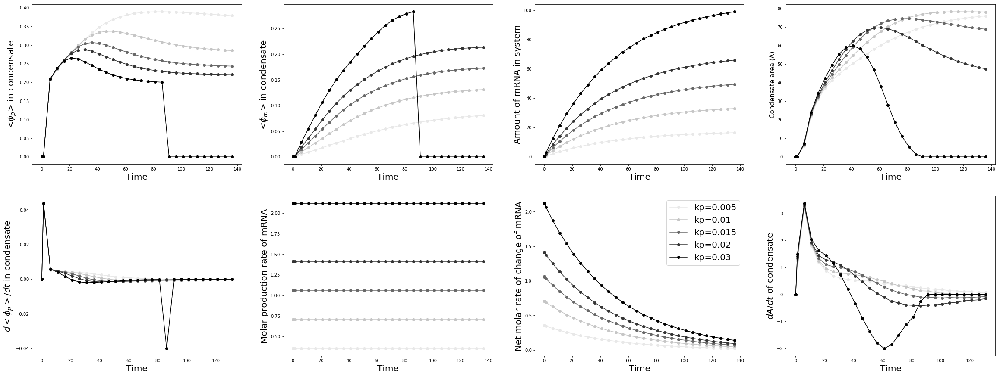

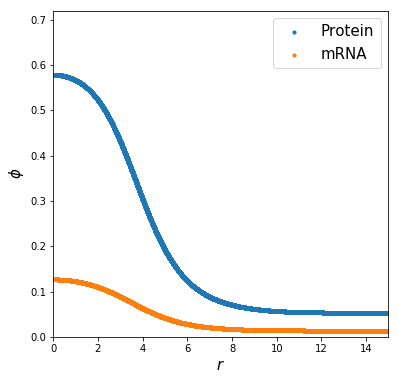

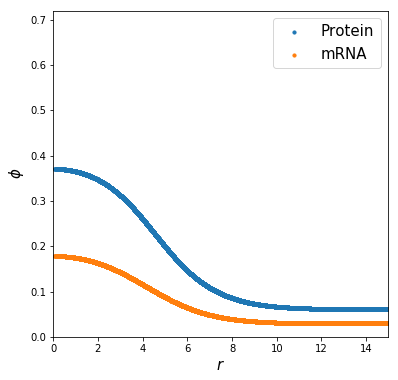

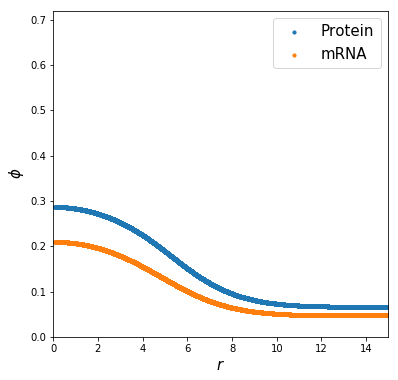

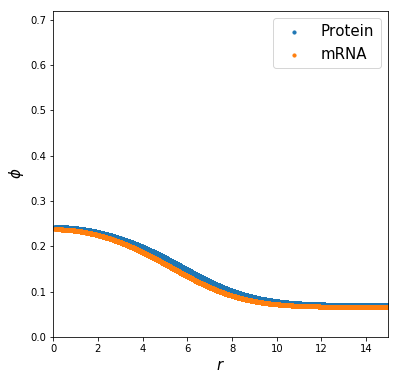

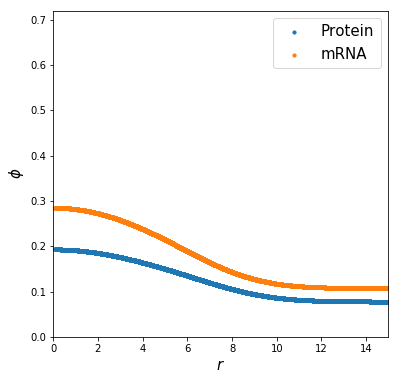

In [47]:
activity_no_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/LINEAR_0.0/"
kp_list = [0.005,0.01,0.015, 0.02, 0.03] 
gray_colors = cm.get_cmap('Greys', len(kp_list)+2)
color_values = np.linspace(0.2,1,len(kp_list))
fig, axs = plt.subplots(2,4,figsize=(40,15))

for i in range(len(kp_list)):
    for root, dirs, files in os.walk(activity_no_lncrna_directory):
        regex = re.compile(r'.*_k_p_{}_reactiontype_.*_thresh_.*_FE_.*_rhoc_.*_Mmrna_0.01$'.format(kp_list[i]))
        match = re.search(regex, root)
        if match != None:
            with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                
                axs[0,0].plot(sp_f['t'],sp_f['average_protein_in_condensate'], '-o', c=gray_colors(color_values[i]))
                axs[0,0].set_xlabel('Time', fontsize=20)
                axs[0,0].set_ylabel(r'<$\phi_p$> in condensate', fontsize=20)
                
                axs[0,1].plot(sp_f['t'],sp_f['average_mrna_in_condensate'], '-o', c=gray_colors(color_values[i]))
                axs[0,1].set_xlabel('Time', fontsize=20)
                axs[0,1].set_ylabel(r'<$\phi_m$> in condensate', fontsize=20)
                
                axs[1,1].plot(sp_f['t'],sp_f['molar_rate_of_mrna_production'], '-o', c=gray_colors(color_values[i]))
                axs[1,1].set_xlabel('Time', fontsize=20)
                axs[1,1].set_ylabel(r'Molar production rate of mRNA', fontsize=20)
                
                axs[1,2].plot(sp_f['t'],sp_f['net_rate_of_mrna_increase'], '-o', c=gray_colors(color_values[i]), label="kp="+str(kp_list[i]))
                axs[1,2].set_xlabel('Time', fontsize=20)
                axs[1,2].set_ylabel(r'Net molar rate of change of mRNA', fontsize=20)  
                axs[1,2].legend(fontsize=20) 
                
                axs[0,3].plot(sp_f['t'],sp_f['condensate_area'], '-o', c=gray_colors(color_values[i]))
                axs[0,3].set_xlabel('Time', fontsize=20)
                axs[0,3].set_ylabel(r'Condensate area (A)', fontsize=15)
                
                axs[0,2].plot(sp_f['t'],sp_f['total_amount_of_mrna'], '-o', c=gray_colors(color_values[i]))
                axs[0,2].set_xlabel('Time', fontsize=20)
                axs[0,2].set_ylabel(r'Amount of mRNA in system', fontsize=20)
                
                conc_growth_rate = (sp_f['average_protein_in_condensate'][1:]-sp_f['average_protein_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                conc_growth_rate[conc_growth_rate > 0.05] = 0.0
                axs[1,0].plot(sp_f['t'][:-1], conc_growth_rate, '-o', c=gray_colors(color_values[i]))
                axs[1,0].set_xlabel('Time', fontsize=20)
                axs[1,0].set_ylabel(r'$d<\phi_p>/dt$ in condensate', fontsize=20)
                
                area_growth_rate = (sp_f['condensate_area'][1:]-sp_f['condensate_area'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                # area_growth_rate[area_growth_rate > 0.0]
                axs[1,3].plot(sp_f['t'][:-1], area_growth_rate, '-o', c=gray_colors(color_values[i]))
                axs[1,3].set_xlabel('Time', fontsize=20)
                axs[1,3].set_ylabel(r'$dA/dt$ of condensate', fontsize=20)

# plt.savefig('20210604-CORRECT_FE/Only_activity_linear_0.0_dynamical_trajectories.png', format='png', dpi=1200)
plt.savefig('20210625-CORRECT_FE-ONLYACTIVITY/Only_activity_linear_0.0_dynamical_trajectories.svg', format='svg', dpi=1200)
plt.show()
plt.close()

for i in range(len(kp_list)):
    for root, dirs, files in os.walk(activity_no_lncrna_directory):
        regex = re.compile(r'.*_k_p_{}_reactiontype_.*_thresh_.*_FE_.*_rhoc_.*_Mmrna_0.01$'.format(kp_list[i]))
        match = re.search(regex, root)
        if match != None:
            df = pd.read_csv(root + '/Mesh/mesh_725.txt', '\t')
            x = df.values[:,0]
            y = df.values[:,1]
            phi_p = df.values[:,2]
            phi_r = df.values[:,4]

            r = np.sqrt(x**2 + y**2)

            fig,ax = plt.subplots(1,1,figsize=(6,6))
            ax.scatter(r, phi_p, s=10, label='Protein')
            ax.scatter(r, phi_r, s=10, label='mRNA')
            ax.set_xlim([0.0,np.max(r)])
            ax.set_ylim([0,0.72])
            ax.set_xlabel(r'$r$',fontsize=15)
            ax.set_ylabel(r'$\phi$',fontsize=15)
            ax.legend(fontsize=15)
            
            plt.savefig('20210625-CORRECT_FE-ONLYACTIVITY/Only_activity_linear_0.0_ssprofile_{}.png'.format(kp_list[i]), format='png', dpi=1200)
            plt.show()
            plt.close()

## Rate = $k_p*(\phi_p-0.2)$ 

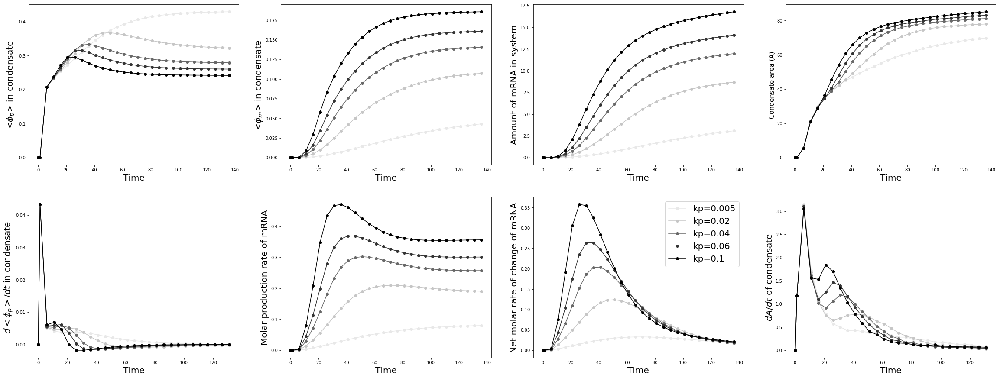

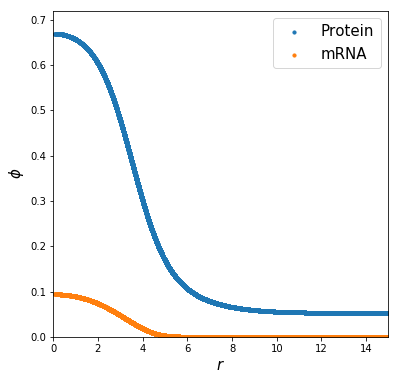

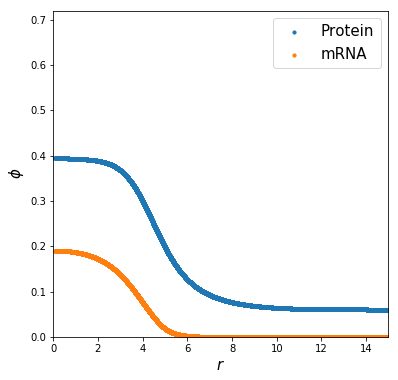

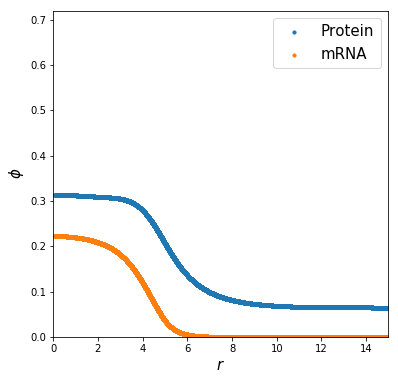

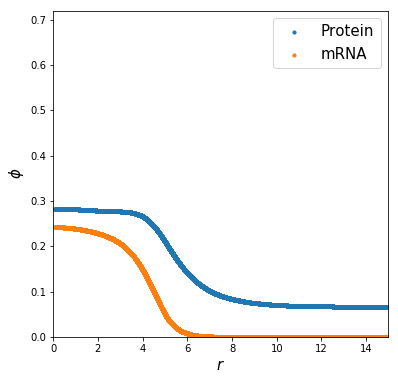

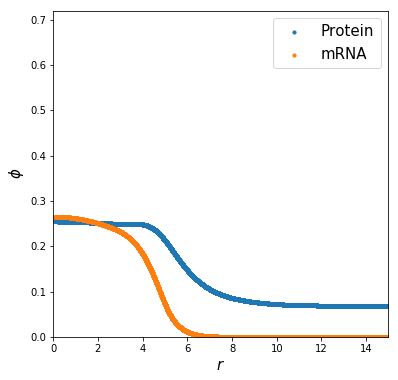

In [49]:
activity_no_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/LINEAR_0.2/"
kp_list = [0.005,0.02,0.04, 0.06, 0.1] 
gray_colors = cm.get_cmap('Greys', len(kp_list)+2)
color_values = np.linspace(0.2,1,len(kp_list))
fig, axs = plt.subplots(2,4,figsize=(40,15))

for i in range(len(kp_list)):
    for root, dirs, files in os.walk(activity_no_lncrna_directory):
        regex = re.compile(r'.*_k_p_{}_reactiontype_.*_thresh_.*_FE_.*_rhoc_.*_Mmrna_0.01$'.format(kp_list[i]))
        match = re.search(regex, root)
        if match != None:
            with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                
                axs[0,0].plot(sp_f['t'],sp_f['average_protein_in_condensate'], '-o', c=gray_colors(color_values[i]))
                axs[0,0].set_xlabel('Time', fontsize=20)
                axs[0,0].set_ylabel(r'<$\phi_p$> in condensate', fontsize=20)
                
                axs[0,1].plot(sp_f['t'],sp_f['average_mrna_in_condensate'], '-o', c=gray_colors(color_values[i]))
                axs[0,1].set_xlabel('Time', fontsize=20)
                axs[0,1].set_ylabel(r'<$\phi_m$> in condensate', fontsize=20)
                
                axs[1,1].plot(sp_f['t'],sp_f['molar_rate_of_mrna_production'], '-o', c=gray_colors(color_values[i]))
                axs[1,1].set_xlabel('Time', fontsize=20)
                axs[1,1].set_ylabel(r'Molar production rate of mRNA', fontsize=20)
                
                axs[1,2].plot(sp_f['t'],sp_f['net_rate_of_mrna_increase'], '-o', c=gray_colors(color_values[i]), label="kp="+str(kp_list[i]))
                axs[1,2].set_xlabel('Time', fontsize=20)
                axs[1,2].set_ylabel(r'Net molar rate of change of mRNA', fontsize=20)  
                axs[1,2].legend(fontsize=20) 
                
                axs[0,3].plot(sp_f['t'],sp_f['condensate_area'], '-o', c=gray_colors(color_values[i]))
                axs[0,3].set_xlabel('Time', fontsize=20)
                axs[0,3].set_ylabel(r'Condensate area (A)', fontsize=15)
                
                axs[0,2].plot(sp_f['t'],sp_f['total_amount_of_mrna'], '-o', c=gray_colors(color_values[i]))
                axs[0,2].set_xlabel('Time', fontsize=20)
                axs[0,2].set_ylabel(r'Amount of mRNA in system', fontsize=20)
                
                conc_growth_rate = (sp_f['average_protein_in_condensate'][1:]-sp_f['average_protein_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                conc_growth_rate[conc_growth_rate > 0.05] = 0.0
                axs[1,0].plot(sp_f['t'][:-1], conc_growth_rate, '-o', c=gray_colors(color_values[i]))
                axs[1,0].set_xlabel('Time', fontsize=20)
                axs[1,0].set_ylabel(r'$d<\phi_p>/dt$ in condensate', fontsize=20)
                
                area_growth_rate = (sp_f['condensate_area'][1:]-sp_f['condensate_area'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                # area_growth_rate[area_growth_rate > 0.0]
                axs[1,3].plot(sp_f['t'][:-1], area_growth_rate, '-o', c=gray_colors(color_values[i]))
                axs[1,3].set_xlabel('Time', fontsize=20)
                axs[1,3].set_ylabel(r'$dA/dt$ of condensate', fontsize=20)

# plt.savefig('20210604-CORRECT_FE/Only_activity_linear_0.0_dynamical_trajectories.png', format='png', dpi=1200)
plt.savefig('20210625-CORRECT_FE-ONLYACTIVITY/Only_activity_linear_0.2_dynamical_trajectories.svg', format='svg', dpi=1200)
plt.show()
plt.close()

for i in range(len(kp_list)):
    for root, dirs, files in os.walk(activity_no_lncrna_directory):
        regex = re.compile(r'.*_k_p_{}_reactiontype_.*_thresh_.*_FE_.*_rhoc_.*_Mmrna_0.01$'.format(kp_list[i]))
        match = re.search(regex, root)
        if match != None:
            df = pd.read_csv(root + '/Mesh/mesh_725.txt', '\t')
            x = df.values[:,0]
            y = df.values[:,1]
            phi_p = df.values[:,2]
            phi_r = df.values[:,4]

            r = np.sqrt(x**2 + y**2)

            fig,ax = plt.subplots(1,1,figsize=(6,6))
            ax.scatter(r, phi_p, s=10, label='Protein')
            ax.scatter(r, phi_r, s=10, label='mRNA')
            ax.set_xlim([0.0,np.max(r)])
            ax.set_ylim([0,0.72])
            ax.set_xlabel(r'$r$',fontsize=15)
            ax.set_ylabel(r'$\phi$',fontsize=15)
            ax.legend(fontsize=15)
            
            plt.savefig('20210625-CORRECT_FE-ONLYACTIVITY/Only_activity_linear_0.2_ssprofile_{}.png'.format(kp_list[i]), format='png', dpi=1200)
            plt.show()
            plt.close()

## Rate = $k_p*(\phi_p-0.4)$

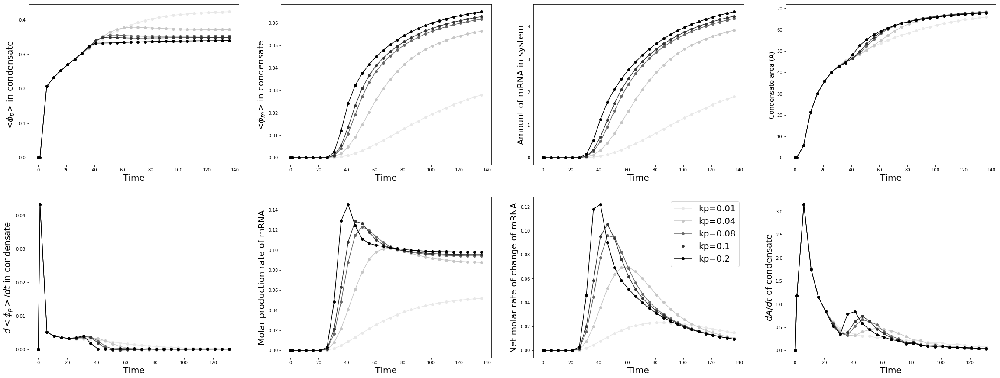

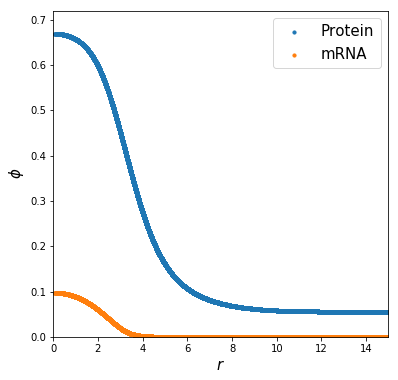

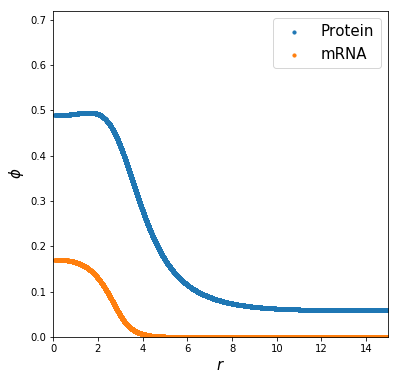

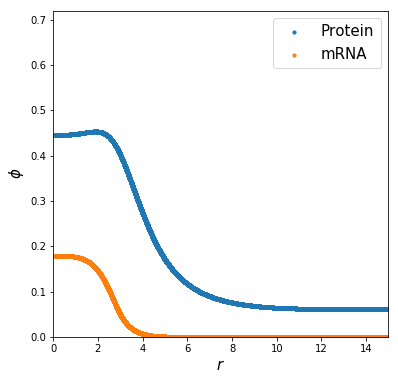

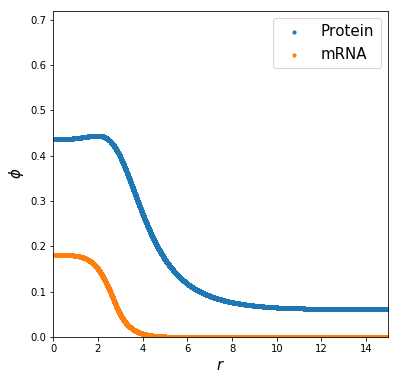

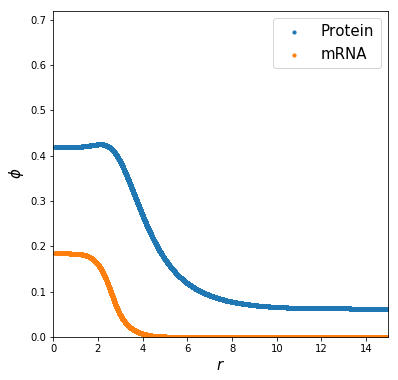

In [50]:
activity_no_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/LINEAR_0.4/"
kp_list = [0.01,0.04,0.08, 0.1, 0.2] 
gray_colors = cm.get_cmap('Greys', len(kp_list)+2)
color_values = np.linspace(0.2,1,len(kp_list))
fig, axs = plt.subplots(2,4,figsize=(40,15))

for i in range(len(kp_list)):
    for root, dirs, files in os.walk(activity_no_lncrna_directory):
        regex = re.compile(r'.*_k_p_{}_reactiontype_.*_thresh_.*_FE_.*_rhoc_.*_Mmrna_0.01$'.format(kp_list[i]))
        match = re.search(regex, root)
        if match != None:
            with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                
                axs[0,0].plot(sp_f['t'],sp_f['average_protein_in_condensate'], '-o', c=gray_colors(color_values[i]))
                axs[0,0].set_xlabel('Time', fontsize=20)
                axs[0,0].set_ylabel(r'<$\phi_p$> in condensate', fontsize=20)
                
                axs[0,1].plot(sp_f['t'],sp_f['average_mrna_in_condensate'], '-o', c=gray_colors(color_values[i]))
                axs[0,1].set_xlabel('Time', fontsize=20)
                axs[0,1].set_ylabel(r'<$\phi_m$> in condensate', fontsize=20)
                
                axs[1,1].plot(sp_f['t'],sp_f['molar_rate_of_mrna_production'], '-o', c=gray_colors(color_values[i]))
                axs[1,1].set_xlabel('Time', fontsize=20)
                axs[1,1].set_ylabel(r'Molar production rate of mRNA', fontsize=20)
                
                axs[1,2].plot(sp_f['t'],sp_f['net_rate_of_mrna_increase'], '-o', c=gray_colors(color_values[i]), label="kp="+str(kp_list[i]))
                axs[1,2].set_xlabel('Time', fontsize=20)
                axs[1,2].set_ylabel(r'Net molar rate of change of mRNA', fontsize=20)  
                axs[1,2].legend(fontsize=20) 
                
                axs[0,3].plot(sp_f['t'],sp_f['condensate_area'], '-o', c=gray_colors(color_values[i]))
                axs[0,3].set_xlabel('Time', fontsize=20)
                axs[0,3].set_ylabel(r'Condensate area (A)', fontsize=15)
                
                axs[0,2].plot(sp_f['t'],sp_f['total_amount_of_mrna'], '-o', c=gray_colors(color_values[i]))
                axs[0,2].set_xlabel('Time', fontsize=20)
                axs[0,2].set_ylabel(r'Amount of mRNA in system', fontsize=20)
                
                conc_growth_rate = (sp_f['average_protein_in_condensate'][1:]-sp_f['average_protein_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                conc_growth_rate[conc_growth_rate > 0.05] = 0.0
                axs[1,0].plot(sp_f['t'][:-1], conc_growth_rate, '-o', c=gray_colors(color_values[i]))
                axs[1,0].set_xlabel('Time', fontsize=20)
                axs[1,0].set_ylabel(r'$d<\phi_p>/dt$ in condensate', fontsize=20)
                
                area_growth_rate = (sp_f['condensate_area'][1:]-sp_f['condensate_area'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                # area_growth_rate[area_growth_rate > 0.0]
                axs[1,3].plot(sp_f['t'][:-1], area_growth_rate, '-o', c=gray_colors(color_values[i]))
                axs[1,3].set_xlabel('Time', fontsize=20)
                axs[1,3].set_ylabel(r'$dA/dt$ of condensate', fontsize=20)

# plt.savefig('20210604-CORRECT_FE/Only_activity_linear_0.0_dynamical_trajectories.png', format='png', dpi=1200)
plt.savefig('20210625-CORRECT_FE-ONLYACTIVITY/Only_activity_linear_0.4_dynamical_trajectories.svg', format='svg', dpi=1200)
plt.show()
plt.close()

for i in range(len(kp_list)):
    for root, dirs, files in os.walk(activity_no_lncrna_directory):
        regex = re.compile(r'.*_k_p_{}_reactiontype_.*_thresh_.*_FE_.*_rhoc_.*_Mmrna_0.01$'.format(kp_list[i]))
        match = re.search(regex, root)
        if match != None:
            df = pd.read_csv(root + '/Mesh/mesh_725.txt', '\t')
            x = df.values[:,0]
            y = df.values[:,1]
            phi_p = df.values[:,2]
            phi_r = df.values[:,4]

            r = np.sqrt(x**2 + y**2)

            fig,ax = plt.subplots(1,1,figsize=(6,6))
            ax.scatter(r, phi_p, s=10, label='Protein')
            ax.scatter(r, phi_r, s=10, label='mRNA')
            ax.set_xlim([0.0,np.max(r)])
            ax.set_ylim([0,0.72])
            ax.set_xlabel(r'$r$',fontsize=15)
            ax.set_ylabel(r'$\phi$',fontsize=15)
            ax.legend(fontsize=15)
            
            plt.savefig('20210625-CORRECT_FE-ONLYACTIVITY/Only_activity_linear_0.4_ssprofile_{}.png'.format(kp_list[i]), format='png', dpi=1200)
            plt.show()
            plt.close()

## Rate = $k_p*H(\phi_p-0.2)$

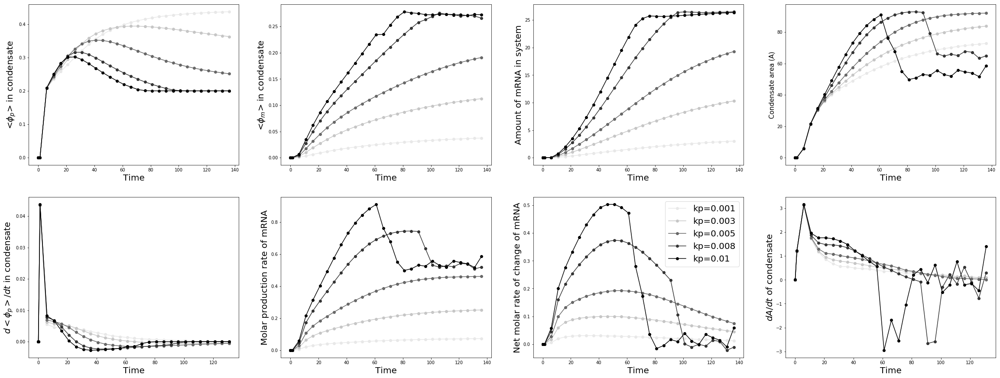

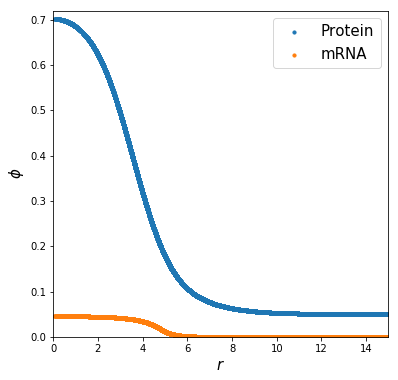

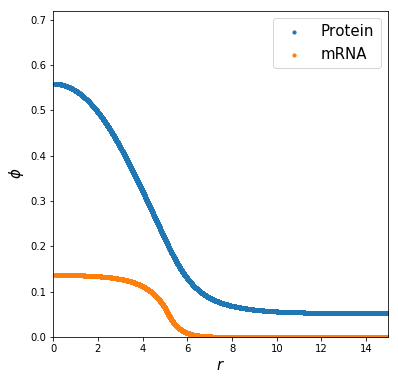

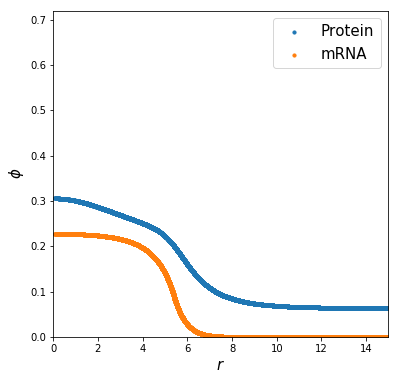

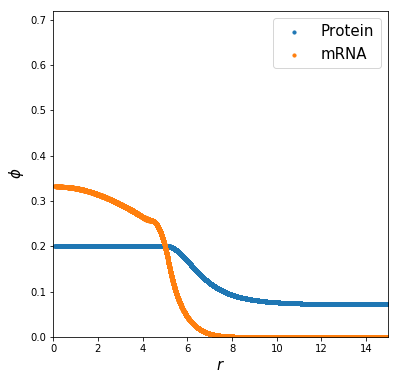

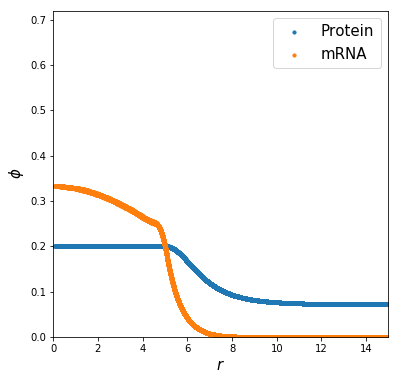

In [51]:
activity_no_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/STEP_0.2/"
kp_list = [0.001,0.003,0.005, 0.008, 0.01] 
gray_colors = cm.get_cmap('Greys', len(kp_list)+2)
color_values = np.linspace(0.2,1,len(kp_list))
fig, axs = plt.subplots(2,4,figsize=(40,15))

for i in range(len(kp_list)):
    for root, dirs, files in os.walk(activity_no_lncrna_directory):
        regex = re.compile(r'.*_k_p_{}_reactiontype_.*_thresh_.*_FE_.*_rhoc_.*_Mmrna_0.01$'.format(kp_list[i]))
        match = re.search(regex, root)
        if match != None:
            with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                
                axs[0,0].plot(sp_f['t'],sp_f['average_protein_in_condensate'], '-o', c=gray_colors(color_values[i]))
                axs[0,0].set_xlabel('Time', fontsize=20)
                axs[0,0].set_ylabel(r'<$\phi_p$> in condensate', fontsize=20)
                
                axs[0,1].plot(sp_f['t'],sp_f['average_mrna_in_condensate'], '-o', c=gray_colors(color_values[i]))
                axs[0,1].set_xlabel('Time', fontsize=20)
                axs[0,1].set_ylabel(r'<$\phi_m$> in condensate', fontsize=20)
                
                axs[1,1].plot(sp_f['t'],sp_f['molar_rate_of_mrna_production'], '-o', c=gray_colors(color_values[i]))
                axs[1,1].set_xlabel('Time', fontsize=20)
                axs[1,1].set_ylabel(r'Molar production rate of mRNA', fontsize=20)
                
                axs[1,2].plot(sp_f['t'],sp_f['net_rate_of_mrna_increase'], '-o', c=gray_colors(color_values[i]), label="kp="+str(kp_list[i]))
                axs[1,2].set_xlabel('Time', fontsize=20)
                axs[1,2].set_ylabel(r'Net molar rate of change of mRNA', fontsize=20)  
                axs[1,2].legend(fontsize=20) 
                
                axs[0,3].plot(sp_f['t'],sp_f['condensate_area'], '-o', c=gray_colors(color_values[i]))
                axs[0,3].set_xlabel('Time', fontsize=20)
                axs[0,3].set_ylabel(r'Condensate area (A)', fontsize=15)
                
                axs[0,2].plot(sp_f['t'],sp_f['total_amount_of_mrna'], '-o', c=gray_colors(color_values[i]))
                axs[0,2].set_xlabel('Time', fontsize=20)
                axs[0,2].set_ylabel(r'Amount of mRNA in system', fontsize=20)
                
                conc_growth_rate = (sp_f['average_protein_in_condensate'][1:]-sp_f['average_protein_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                conc_growth_rate[conc_growth_rate > 0.05] = 0.0
                axs[1,0].plot(sp_f['t'][:-1], conc_growth_rate, '-o', c=gray_colors(color_values[i]))
                axs[1,0].set_xlabel('Time', fontsize=20)
                axs[1,0].set_ylabel(r'$d<\phi_p>/dt$ in condensate', fontsize=20)
                
                area_growth_rate = (sp_f['condensate_area'][1:]-sp_f['condensate_area'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                # area_growth_rate[area_growth_rate > 0.0]
                axs[1,3].plot(sp_f['t'][:-1], area_growth_rate, '-o', c=gray_colors(color_values[i]))
                axs[1,3].set_xlabel('Time', fontsize=20)
                axs[1,3].set_ylabel(r'$dA/dt$ of condensate', fontsize=20)

# plt.savefig('20210604-CORRECT_FE/Only_activity_linear_0.0_dynamical_trajectories.png', format='png', dpi=1200)
plt.savefig('20210625-CORRECT_FE-ONLYACTIVITY/Only_activity_step_0.2_dynamical_trajectories.svg', format='svg', dpi=1200)
plt.show()
plt.close()

for i in range(len(kp_list)):
    for root, dirs, files in os.walk(activity_no_lncrna_directory):
        regex = re.compile(r'.*_k_p_{}_reactiontype_.*_thresh_.*_FE_.*_rhoc_.*_Mmrna_0.01$'.format(kp_list[i]))
        match = re.search(regex, root)
        if match != None:
            df = pd.read_csv(root + '/Mesh/mesh_725.txt', '\t')
            x = df.values[:,0]
            y = df.values[:,1]
            phi_p = df.values[:,2]
            phi_r = df.values[:,4]

            r = np.sqrt(x**2 + y**2)

            fig,ax = plt.subplots(1,1,figsize=(6,6))
            ax.scatter(r, phi_p, s=10, label='Protein')
            ax.scatter(r, phi_r, s=10, label='mRNA')
            ax.set_xlim([0.0,np.max(r)])
            ax.set_ylim([0,0.72])
            ax.set_xlabel(r'$r$',fontsize=15)
            ax.set_ylabel(r'$\phi$',fontsize=15)
            ax.legend(fontsize=15)
            
            plt.savefig('20210625-CORRECT_FE-ONLYACTIVITY/Only_activity_step_0.2_ssprofile_{}.png'.format(kp_list[i]), format='png', dpi=1200)
            plt.show()
            plt.close()

### Rate = $k_p*H(\phi_p - 0.4)$

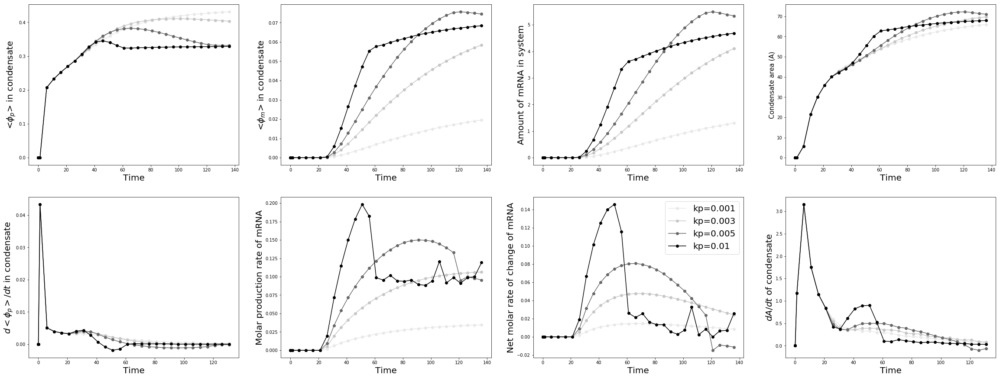

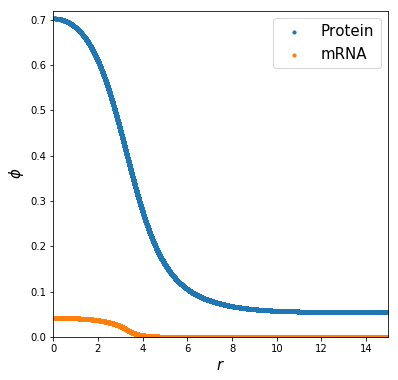

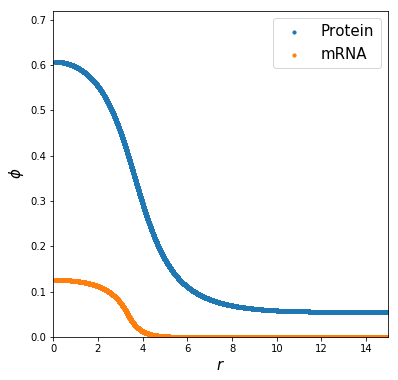

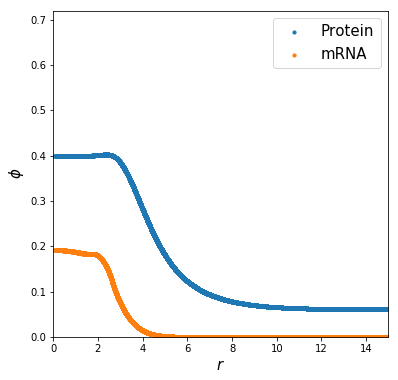

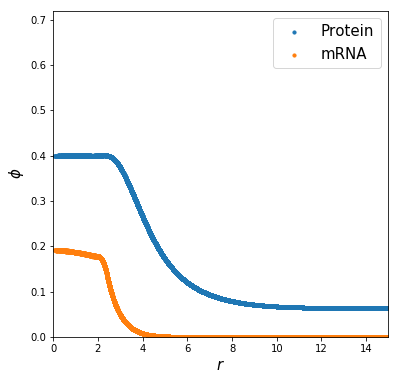

In [53]:
activity_no_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/STEP_0.4/"
kp_list = [0.001,0.003,0.005, 0.008, 0.01] # , 0.01, 0.015]

gray_colors = cm.get_cmap('Greys', len(kp_list)+2)
color_values = np.linspace(0.2,1,len(kp_list))
fig, axs = plt.subplots(2,4,figsize=(40,15))

for i in range(len(kp_list)):
    for root, dirs, files in os.walk(activity_no_lncrna_directory):
        regex = re.compile(r'.*_k_p_{}_reactiontype_.*_thresh_.*_FE_.*_rhoc_.*_Mmrna_0.01$'.format(kp_list[i]))
        match = re.search(regex, root)
        if match != None:
            with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                
                axs[0,0].plot(sp_f['t'],sp_f['average_protein_in_condensate'], '-o', c=gray_colors(color_values[i]))
                axs[0,0].set_xlabel('Time', fontsize=20)
                axs[0,0].set_ylabel(r'<$\phi_p$> in condensate', fontsize=20)
                
                axs[0,1].plot(sp_f['t'],sp_f['average_mrna_in_condensate'], '-o', c=gray_colors(color_values[i]))
                axs[0,1].set_xlabel('Time', fontsize=20)
                axs[0,1].set_ylabel(r'<$\phi_m$> in condensate', fontsize=20)
                
                axs[1,1].plot(sp_f['t'],sp_f['molar_rate_of_mrna_production'], '-o', c=gray_colors(color_values[i]))
                axs[1,1].set_xlabel('Time', fontsize=20)
                axs[1,1].set_ylabel(r'Molar production rate of mRNA', fontsize=20)
                
                axs[1,2].plot(sp_f['t'],sp_f['net_rate_of_mrna_increase'], '-o', c=gray_colors(color_values[i]), label="kp="+str(kp_list[i]))
                axs[1,2].set_xlabel('Time', fontsize=20)
                axs[1,2].set_ylabel(r'Net molar rate of change of mRNA', fontsize=20)  
                axs[1,2].legend(fontsize=20) 
                
                axs[0,3].plot(sp_f['t'],sp_f['condensate_area'], '-o', c=gray_colors(color_values[i]))
                axs[0,3].set_xlabel('Time', fontsize=20)
                axs[0,3].set_ylabel(r'Condensate area (A)', fontsize=15)
                
                axs[0,2].plot(sp_f['t'],sp_f['total_amount_of_mrna'], '-o', c=gray_colors(color_values[i]))
                axs[0,2].set_xlabel('Time', fontsize=20)
                axs[0,2].set_ylabel(r'Amount of mRNA in system', fontsize=20)
                
                conc_growth_rate = (sp_f['average_protein_in_condensate'][1:]-sp_f['average_protein_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                conc_growth_rate[conc_growth_rate > 0.05] = 0.0
                axs[1,0].plot(sp_f['t'][:-1], conc_growth_rate, '-o', c=gray_colors(color_values[i]))
                axs[1,0].set_xlabel('Time', fontsize=20)
                axs[1,0].set_ylabel(r'$d<\phi_p>/dt$ in condensate', fontsize=20)
                
                area_growth_rate = (sp_f['condensate_area'][1:]-sp_f['condensate_area'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                # area_growth_rate[area_growth_rate > 0.0]
                axs[1,3].plot(sp_f['t'][:-1], area_growth_rate, '-o', c=gray_colors(color_values[i]))
                axs[1,3].set_xlabel('Time', fontsize=20)
                axs[1,3].set_ylabel(r'$dA/dt$ of condensate', fontsize=20)

# plt.savefig('20210604-CORRECT_FE/Only_activity_step_0.4_dynamical_trajectories.png', format='png', dpi=1200)
plt.savefig('20210625-CORRECT_FE-ONLYACTIVITY/Only_activity_step_0.4_dynamical_trajectories.svg', format='svg', dpi=1200)
plt.show()
plt.close()

for i in range(len(kp_list)):
    for root, dirs, files in os.walk(activity_no_lncrna_directory):
        regex = re.compile(r'.*_k_p_{}_reactiontype_.*_thresh_.*_FE_.*_rhoc_.*_Mmrna_0.01$'.format(kp_list[i]))
        match = re.search(regex, root)
        if match != None:
            df = pd.read_csv(root + '/Mesh/mesh_725.txt', '\t')
            x = df.values[:,0]
            y = df.values[:,1]
            phi_p = df.values[:,2]
            phi_r = df.values[:,4]

            r = np.sqrt(x**2 + y**2)

            fig,ax = plt.subplots(1,1,figsize=(6,6))
            ax.scatter(r, phi_p, s=10, label='Protein')
            ax.scatter(r, phi_r, s=10, label='mRNA')
            ax.set_xlim([0.0,np.max(r)])
            ax.set_ylim([0,0.72])
            ax.set_xlabel(r'$r$',fontsize=15)
            ax.set_ylabel(r'$\phi$',fontsize=15)
            ax.legend(fontsize=15)
            
            plt.savefig('20210625-CORRECT_FE-ONLYACTIVITY/Only_activity_step_0.4_ssprofile_{}.png'.format(kp_list[i]), format='png', dpi=1200)
            plt.show()
            plt.close()

## Localized mRNA production

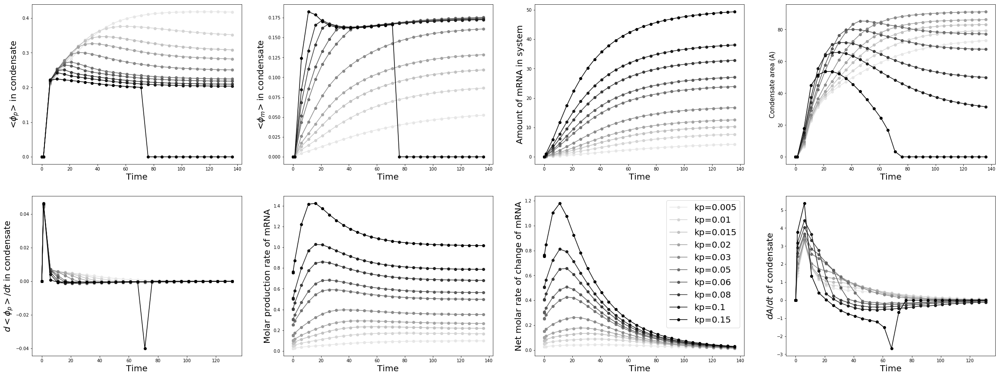

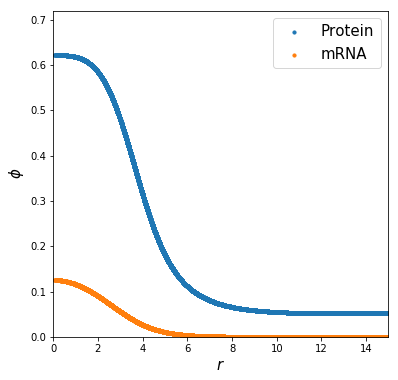

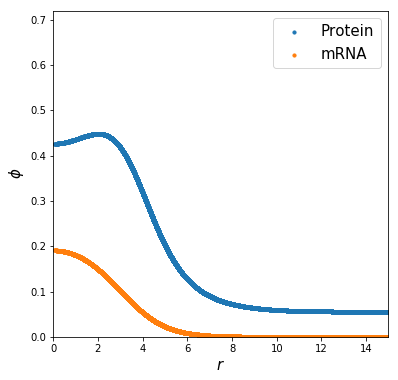

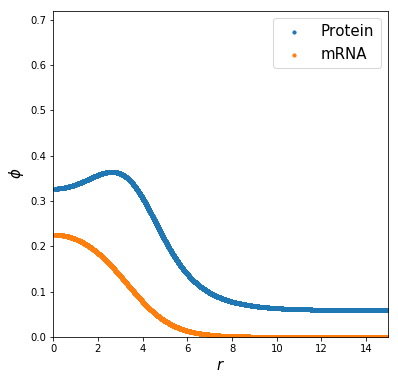

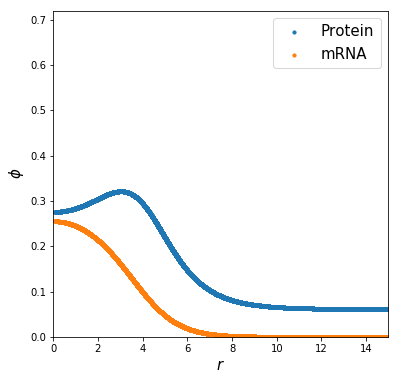

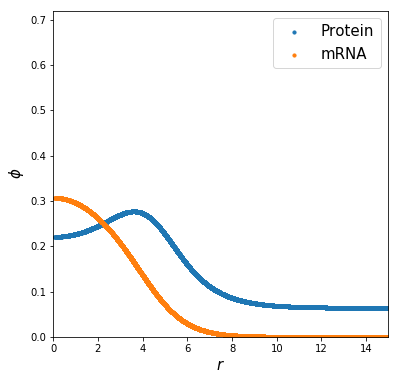

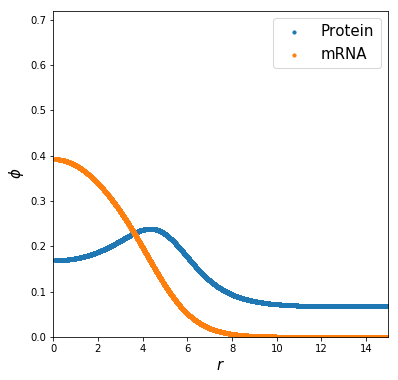

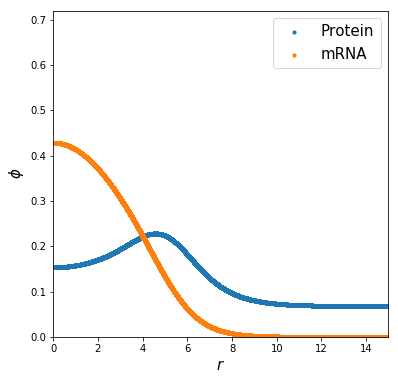

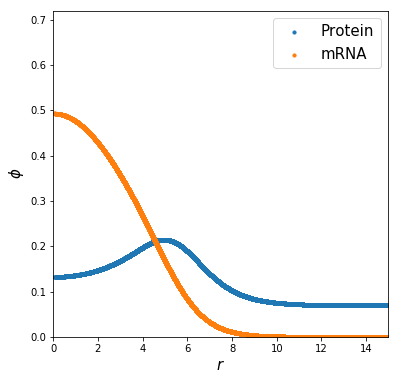

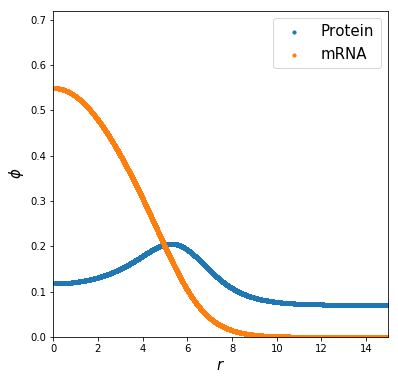

In [ ]:
activity_no_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/LOCALIZED_MRNA_PRODUCTION/phi_p_0_0.1_kappa_0.5_sigma_5.0_T_150/"
kp_list = [0.005,0.01,0.015,0.02,0.03,0.05,0.06,0.08,0.1,0.15] 
gray_colors = cm.get_cmap('Greys', len(kp_list)+2)
color_values = np.linspace(0.2,1,len(kp_list))
fig, axs = plt.subplots(2,4,figsize=(40,15))

for i in range(len(kp_list)):
    for root, dirs, files in os.walk(activity_no_lncrna_directory):
        regex = re.compile(r'.*k_p_{}_reactiontype_.*_thresh_.*_FE_.*_rhoc_.*_Mmrna_0.01$'.format(kp_list[i]))
        match = re.search(regex, root)
        if match != None:
            with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                
                axs[0,0].plot(sp_f['t'],sp_f['average_protein_in_condensate'], '-o', c=gray_colors(color_values[i]))
                axs[0,0].set_xlabel('Time', fontsize=20)
                axs[0,0].set_ylabel(r'<$\phi_p$> in condensate', fontsize=20)
                
                axs[0,1].plot(sp_f['t'],sp_f['average_mrna_in_condensate'], '-o', c=gray_colors(color_values[i]))
                axs[0,1].set_xlabel('Time', fontsize=20)
                axs[0,1].set_ylabel(r'<$\phi_m$> in condensate', fontsize=20)
                
                axs[1,1].plot(sp_f['t'],sp_f['molar_rate_of_mrna_production'], '-o', c=gray_colors(color_values[i]))
                axs[1,1].set_xlabel('Time', fontsize=20)
                axs[1,1].set_ylabel(r'Molar production rate of mRNA', fontsize=20)
                
                axs[1,2].plot(sp_f['t'],sp_f['net_rate_of_mrna_increase'], '-o', c=gray_colors(color_values[i]), label="kp="+str(kp_list[i]))
                axs[1,2].set_xlabel('Time', fontsize=20)
                axs[1,2].set_ylabel(r'Net molar rate of change of mRNA', fontsize=20)  
                axs[1,2].legend(fontsize=20) 
                
                axs[0,3].plot(sp_f['t'],sp_f['condensate_area'], '-o', c=gray_colors(color_values[i]))
                axs[0,3].set_xlabel('Time', fontsize=20)
                axs[0,3].set_ylabel(r'Condensate area (A)', fontsize=15)
                
                axs[0,2].plot(sp_f['t'],sp_f['total_amount_of_mrna'], '-o', c=gray_colors(color_values[i]))
                axs[0,2].set_xlabel('Time', fontsize=20)
                axs[0,2].set_ylabel(r'Amount of mRNA in system', fontsize=20)
                
                conc_growth_rate = (sp_f['average_protein_in_condensate'][1:]-sp_f['average_protein_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                conc_growth_rate[conc_growth_rate > 0.05] = 0.0
                axs[1,0].plot(sp_f['t'][:-1], conc_growth_rate, '-o', c=gray_colors(color_values[i]))
                axs[1,0].set_xlabel('Time', fontsize=20)
                axs[1,0].set_ylabel(r'$d<\phi_p>/dt$ in condensate', fontsize=20)
                
                area_growth_rate = (sp_f['condensate_area'][1:]-sp_f['condensate_area'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                # area_growth_rate[area_growth_rate > 0.0]
                axs[1,3].plot(sp_f['t'][:-1], area_growth_rate, '-o', c=gray_colors(color_values[i]))
                axs[1,3].set_xlabel('Time', fontsize=20)
                axs[1,3].set_ylabel(r'$dA/dt$ of condensate', fontsize=20)


# plt.savefig('20210604-CORRECT_FE/Only_activity_linear_0.0_dynamical_trajectories.png', format='png', dpi=1200)
plt.savefig('20210625-CORRECT_FE-ONLYACTIVITY/Only_activity_localized_dynamical_trajectories.svg', format='svg', dpi=1200)
plt.show()
plt.close()

for i in range(len(kp_list)):
    for root, dirs, files in os.walk(activity_no_lncrna_directory):
        regex = re.compile(r'.*k_p_{}_reactiontype_.*_thresh_.*_FE_.*_rhoc_.*_Mmrna_0.01$'.format(kp_list[i]))
        match = re.search(regex, root)
        if match != None:
            df = pd.read_csv(root + '/Mesh/mesh_725.txt', '\t')
            x = df.values[:,0]
            y = df.values[:,1]
            phi_p = df.values[:,2]
            phi_r = df.values[:,4]

            r = np.sqrt(x**2 + y**2)

            fig,ax = plt.subplots(1,1,figsize=(6,6))
            ax.scatter(r, phi_p, s=10, label='Protein')
            ax.scatter(r, phi_r, s=10, label='mRNA')
            ax.set_xlim([0.0,np.max(r)])
            ax.set_ylim([0,0.72])
            ax.set_xlabel(r'$r$',fontsize=15)
            ax.set_ylabel(r'$\phi$',fontsize=15)
            ax.legend(fontsize=15)
            
            plt.savefig('20210625-CORRECT_FE-ONLYACTIVITY/Only_activity_localized_ssprofile_{}.png'.format(kp_list[i]), format='png', dpi=1200)
            plt.show()
            plt.close()

## Dynamics of condensate in the presence of lncRNA but no activity

#### Note: Have plots for only condensate with the above plots to help compare dynamics

## Dynamics of condensate in the presence of lncRNA and activity

#### Note: 
1. Have plots for only condensate, condensate + lncRNA, condensate + activity along with the above plots to help compare dynamics
2. Also have a few comparisons on what happens when we have symmetric free energy vs. asymmetric free energy for some particular subset of the parameter space in this study

In [1]:
activity_and_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/LINEAR_0.0/"
activity_no_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/LINEAR_0.0/"
kp_list = [0.005,0.01,0.015,0.02,0.03]
L_P_list = [3.0,4.0,5.0,7.0,10.0]
phi_r_list = [1.0,5.0,10.0]

gray_colors = cm.get_cmap('Greys', len(L_P_list))
color_values = np.linspace(0.2,1,len(L_P_list))

for i in range(len(phi_r_list)):
    for j in range(len(kp_list)):
        
        fig, axs = plt.subplots(2,5,figsize=(48,15))
        
        if kp_list[j] == 0.0:
            only_activity_dynamics_file = activity_no_lncrna_directory + "phi_r_0.0_L_P_0.0_k_p_0.0_reactiontype_0.0_thresh_0.0_FE_5.0_rhoc_20.0_MP_1.0_Mmrna_0.01/dynamical_trajectories.hdf5"
        else:
            only_activity_dynamics_file = activity_no_lncrna_directory + "phi_r_0.0_L_P_0.0_k_p_{}_reactiontype_0.0_thresh_0.0_FE_5.0_rhoc_20.0_MP_1.0_Mmrna_0.01/dynamical_trajectories.hdf5".format(kp_list[j])
        
        with h5py.File(only_activity_dynamics_file) as sp_f: 

            axs[0,0].plot(sp_f['t'],sp_f['average_protein_in_condensate'], '-o', c='brown')
            axs[0,0].set_xlabel('Time', fontsize=20)
            axs[0,0].set_ylabel(r'<$\phi_p$> in condensate', fontsize=20)
            # axs[0,0].set_ylim([0.4,0.6])

            axs[0,1].plot(sp_f['t'],sp_f['average_lncrna_in_condensate'], '-o', c='brown')
            axs[0,1].set_xlabel('Time', fontsize=20)
            axs[0,1].set_ylabel(r'<$\phi_r$> in condensate', fontsize=20)

            axs[0,2].plot(sp_f['t'],sp_f['average_mrna_in_condensate'], '-o', c='brown')
            axs[0,2].set_xlabel('Time', fontsize=20)
            axs[0,2].set_ylabel(r'<$\phi_m$> in condensate', fontsize=20)

            axs[0,3].plot(sp_f['t'],sp_f['total_amount_of_mrna'], '-o', c='brown')
            axs[0,3].set_xlabel('Time', fontsize=20)
            axs[0,3].set_ylabel(r'Amount of mRNA in system', fontsize=20)

            axs[0,4].plot(sp_f['t'],sp_f['condensate_area'], '-o', c='brown')
            axs[0,4].set_xlabel('Time', fontsize=20)
            axs[0,4].set_ylabel(r'Condensate area (A)', fontsize=15)

            p_conc_growth_rate = (sp_f['average_protein_in_condensate'][1:]-sp_f['average_protein_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
            p_conc_growth_rate[p_conc_growth_rate > 0.05] = 0.0
            axs[1,0].plot(sp_f['t'][:-1], p_conc_growth_rate, '-o', c='brown')
            axs[1,0].set_xlabel('Time', fontsize=20)
            axs[1,0].set_ylabel(r'$d<\phi_p>/dt$ in condensate', fontsize=20)

            l_conc_growth_rate = (sp_f['average_lncrna_in_condensate'][1:]-sp_f['average_lncrna_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
            # p_conc_growth_rate[conc_growth_rate > 0.02] = 0.0
            axs[1,1].plot(sp_f['t'][:-1], l_conc_growth_rate, '-o', c='brown')
            axs[1,1].set_xlabel('Time', fontsize=20)
            axs[1,1].set_ylabel(r'$d<\phi_r>/dt$ in condensate', fontsize=20)

            axs[1,2].plot(sp_f['t'],sp_f['molar_rate_of_mrna_production'], '-o', c='brown')
            axs[1,2].set_xlabel('Time', fontsize=20)
            axs[1,2].set_ylabel(r'Molar production rate of mRNA', fontsize=20)

            axs[1,3].plot(sp_f['t'],sp_f['net_rate_of_mrna_increase'], '-o', c='brown', label="No lncRNA")
            axs[1,3].set_xlabel('Time', fontsize=20)
            axs[1,3].set_ylabel(r'Net molar rate of change of mRNA', fontsize=20)  
            axs[1,3].legend(fontsize=20) 

            area_growth_rate = (sp_f['condensate_area'][1:]-sp_f['condensate_area'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
            axs[1,4].plot(sp_f['t'][:-1], area_growth_rate, '-o', c='brown')
            axs[1,4].set_xlabel('Time', fontsize=20)
            axs[1,4].set_ylabel(r'$dA/dt$ of condensate', fontsize=20)

        for k in range(len(L_P_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[i],L_P_list[k],kp_list[j]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 

                        axs[0,0].plot(sp_f['t'],sp_f['average_protein_in_condensate'], '-o', c=gray_colors(color_values[k]))
                        axs[0,0].set_xlabel('Time', fontsize=20)
                        axs[0,0].set_ylabel(r'<$\phi_p$> in condensate', fontsize=20)
                        # axs[0,0].set_ylim([0.4,0.7])

                        axs[0,1].plot(sp_f['t'],sp_f['average_lncrna_in_condensate'], '-o', c=gray_colors(color_values[k]))
                        axs[0,1].set_xlabel('Time', fontsize=20)
                        axs[0,1].set_ylabel(r'<$\phi_r$> in condensate', fontsize=20)
                        
                        axs[0,2].plot(sp_f['t'],sp_f['average_mrna_in_condensate'], '-o', c=gray_colors(color_values[k]))
                        axs[0,2].set_xlabel('Time', fontsize=20)
                        axs[0,2].set_ylabel(r'<$\phi_m$> in condensate', fontsize=20)
                        
                        axs[0,3].plot(sp_f['t'],sp_f['total_amount_of_mrna'], '-o', c=gray_colors(color_values[k]))
                        axs[0,3].set_xlabel('Time', fontsize=20)
                        axs[0,3].set_ylabel(r'Amount of mRNA in system', fontsize=20)
                        
                        axs[0,4].plot(sp_f['t'],sp_f['condensate_area'], '-o', c=gray_colors(color_values[k]))
                        axs[0,4].set_xlabel('Time', fontsize=20)
                        axs[0,4].set_ylabel(r'Condensate area (A)', fontsize=15)
                        
                        p_conc_growth_rate = (sp_f['average_protein_in_condensate'][1:]-sp_f['average_protein_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                        p_conc_growth_rate[p_conc_growth_rate > 0.05] = 0.0
                        axs[1,0].plot(sp_f['t'][:-1], p_conc_growth_rate, '-o', c=gray_colors(color_values[k]))
                        axs[1,0].set_xlabel('Time', fontsize=20)
                        axs[1,0].set_ylabel(r'$d<\phi_p>/dt$ in condensate', fontsize=20)
                        
                        l_conc_growth_rate = (sp_f['average_lncrna_in_condensate'][1:]-sp_f['average_lncrna_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                        # p_conc_growth_rate[conc_growth_rate > 0.02] = 0.0
                        axs[1,1].plot(sp_f['t'][:-1], l_conc_growth_rate, '-o', c=gray_colors(color_values[k]))
                        axs[1,1].set_xlabel('Time', fontsize=20)
                        axs[1,1].set_ylabel(r'$d<\phi_r>/dt$ in condensate', fontsize=20)
                        
                        axs[1,2].plot(sp_f['t'],sp_f['molar_rate_of_mrna_production'], '-o', c=gray_colors(color_values[k]))
                        axs[1,2].set_xlabel('Time', fontsize=20)
                        axs[1,2].set_ylabel(r'Molar production rate of mRNA', fontsize=20)

                        axs[1,3].plot(sp_f['t'],sp_f['net_rate_of_mrna_increase'], '-o', c=gray_colors(color_values[k]), label="$L_P$="+str(L_P_list[k]))
                        axs[1,3].set_xlabel('Time', fontsize=20)
                        axs[1,3].set_ylabel(r'Net molar rate of change of mRNA', fontsize=20)  
                        axs[1,3].legend(fontsize=20) 

                        area_growth_rate = (sp_f['condensate_area'][1:]-sp_f['condensate_area'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                        axs[1,4].plot(sp_f['t'][:-1], area_growth_rate, '-o', c=gray_colors(color_values[k]))
                        axs[1,4].set_xlabel('Time', fontsize=20)
                        axs[1,4].set_ylabel(r'$dA/dt$ of condensate', fontsize=20)

        # plt.savefig('20210604-CORRECT_FE/Only_activity_linear_0.4_dynamical_trajectories.png', format='png', dpi=1200)
        plt.savefig('20210709-CORRECT_FE_LINEAR_MRNA_PRODUCTION/lncrna_and_activity_linear_0_kp_{}_phir_{}_dynamical_trajectories.svg'.format(kp_list[j],phi_r_list[i]), format='svg', dpi=1200)
        plt.show()
        plt.close()

NameError: name 'cm' is not defined

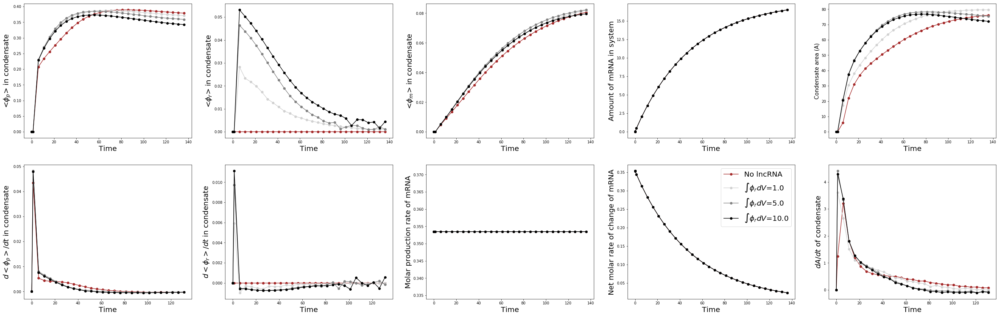

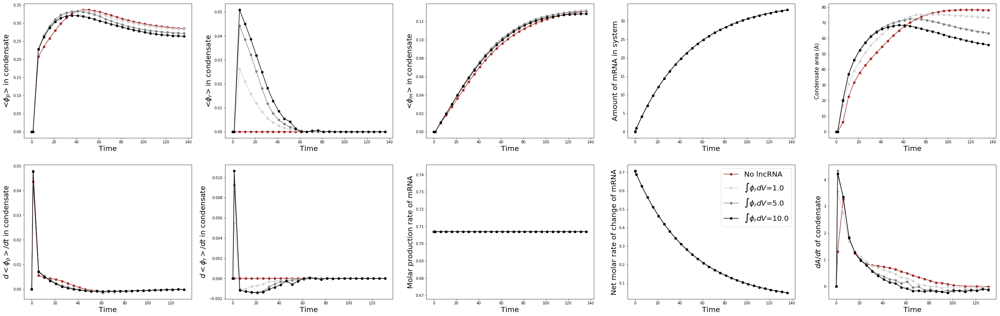

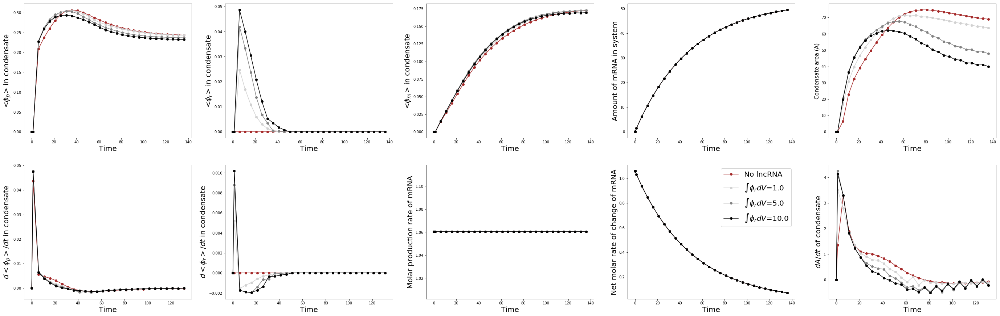

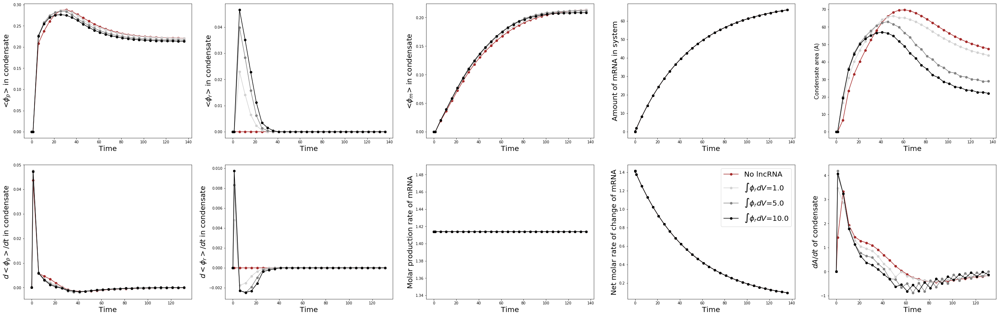

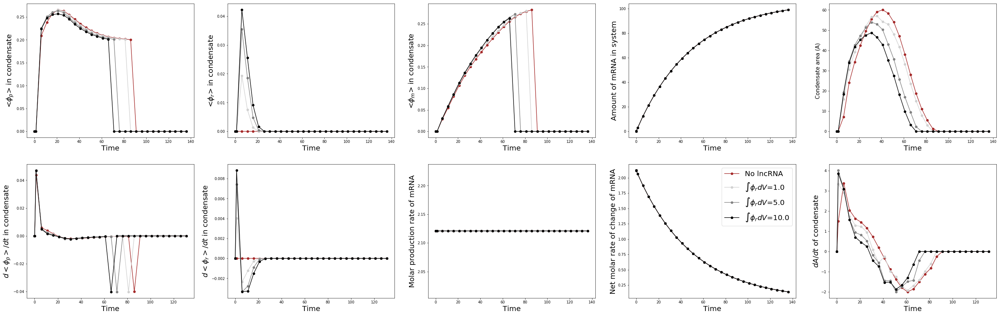

...

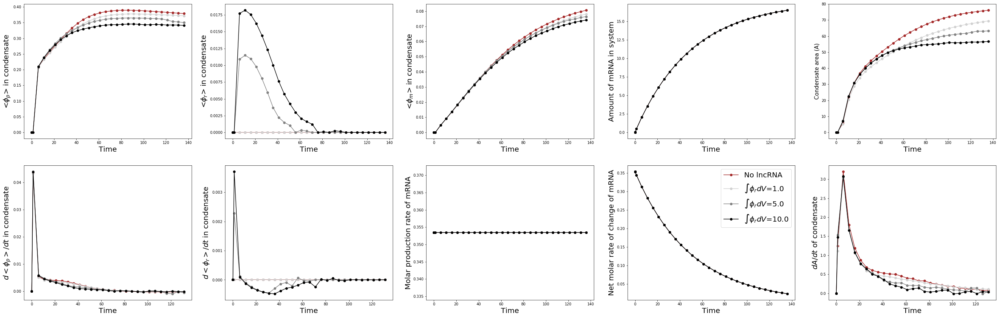

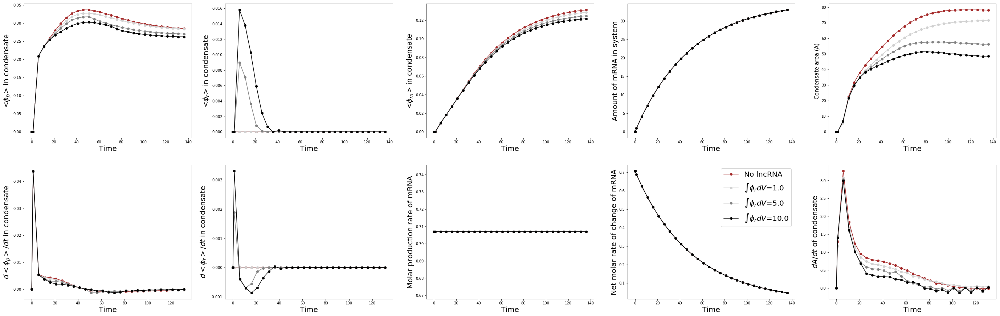

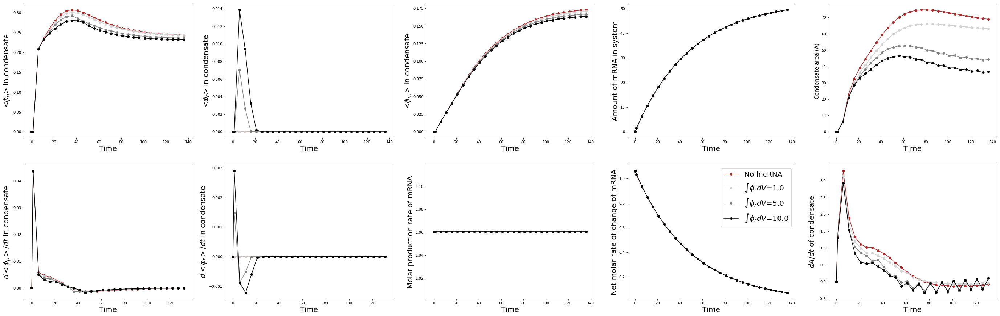

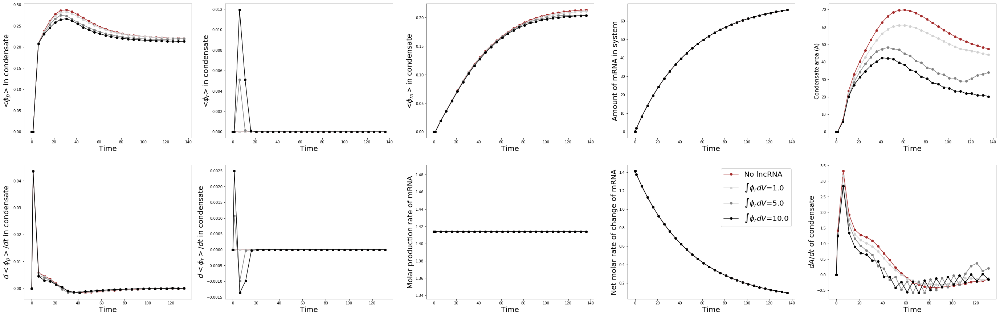

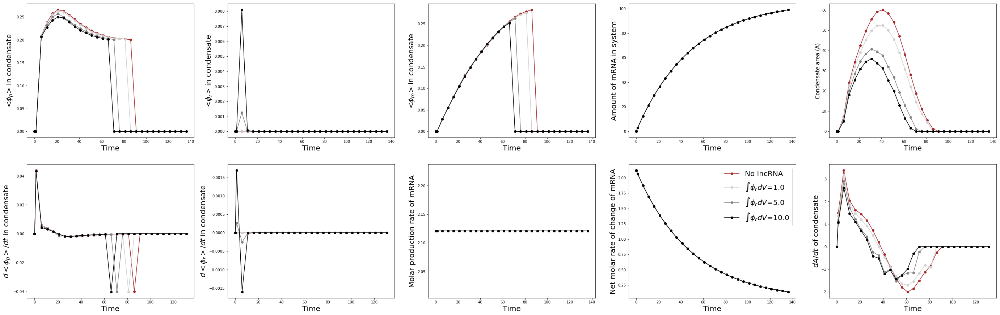

In [63]:
# Plot the same thing but for variations in phi_r

activity_and_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/LINEAR_0.0/"
activity_no_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/LINEAR_0.0/"
kp_list = [0.005,0.01,0.015,0.02,0.03]
L_P_list = [3.0,4.0,5.0,7.0,10.0]
phi_r_list = [1.0,5.0,10.0]

gray_colors = cm.get_cmap('Greys', len(phi_r_list)+5)
color_values = np.linspace(0.3,0.9,len(phi_r_list))

for k in range(len(L_P_list)):
    for j in range(len(kp_list)):
        
        fig, axs = plt.subplots(2,5,figsize=(48,15))
        
        if kp_list[j] == 0.0:
            only_activity_dynamics_file = activity_no_lncrna_directory + "phi_r_0.0_L_P_0.0_k_p_0.0_reactiontype_0.0_thresh_0.0_FE_5.0_rhoc_20.0_MP_1.0_Mmrna_0.01/dynamical_trajectories.hdf5"
        else:
            only_activity_dynamics_file = activity_no_lncrna_directory + "phi_r_0.0_L_P_0.0_k_p_{}_reactiontype_0.0_thresh_0.0_FE_5.0_rhoc_20.0_MP_1.0_Mmrna_0.01/dynamical_trajectories.hdf5".format(kp_list[j])
        
        with h5py.File(only_activity_dynamics_file) as sp_f: 

            axs[0,0].plot(sp_f['t'],sp_f['average_protein_in_condensate'], '-o', c='brown')
            axs[0,0].set_xlabel('Time', fontsize=20)
            axs[0,0].set_ylabel(r'<$\phi_p$> in condensate', fontsize=20)
            # axs[0,0].set_ylim([0.4,0.6])

            axs[0,1].plot(sp_f['t'],sp_f['average_lncrna_in_condensate'], '-o', c='brown')
            axs[0,1].set_xlabel('Time', fontsize=20)
            axs[0,1].set_ylabel(r'<$\phi_r$> in condensate', fontsize=20)

            axs[0,2].plot(sp_f['t'],sp_f['average_mrna_in_condensate'], '-o', c='brown')
            axs[0,2].set_xlabel('Time', fontsize=20)
            axs[0,2].set_ylabel(r'<$\phi_m$> in condensate', fontsize=20)

            axs[0,3].plot(sp_f['t'],sp_f['total_amount_of_mrna'], '-o', c='brown')
            axs[0,3].set_xlabel('Time', fontsize=20)
            axs[0,3].set_ylabel(r'Amount of mRNA in system', fontsize=20)

            axs[0,4].plot(sp_f['t'],sp_f['condensate_area'], '-o', c='brown')
            axs[0,4].set_xlabel('Time', fontsize=20)
            axs[0,4].set_ylabel(r'Condensate area (A)', fontsize=15)

            p_conc_growth_rate = (sp_f['average_protein_in_condensate'][1:]-sp_f['average_protein_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
            p_conc_growth_rate[p_conc_growth_rate > 0.05] = 0.0
            axs[1,0].plot(sp_f['t'][:-1], p_conc_growth_rate, '-o', c='brown')
            axs[1,0].set_xlabel('Time', fontsize=20)
            axs[1,0].set_ylabel(r'$d<\phi_p>/dt$ in condensate', fontsize=20)

            l_conc_growth_rate = (sp_f['average_lncrna_in_condensate'][1:]-sp_f['average_lncrna_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
            # p_conc_growth_rate[conc_growth_rate > 0.02] = 0.0
            axs[1,1].plot(sp_f['t'][:-1], l_conc_growth_rate, '-o', c='brown')
            axs[1,1].set_xlabel('Time', fontsize=20)
            axs[1,1].set_ylabel(r'$d<\phi_r>/dt$ in condensate', fontsize=20)

            axs[1,2].plot(sp_f['t'],sp_f['molar_rate_of_mrna_production'], '-o', c='brown')
            axs[1,2].set_xlabel('Time', fontsize=20)
            axs[1,2].set_ylabel(r'Molar production rate of mRNA', fontsize=20)

            axs[1,3].plot(sp_f['t'],sp_f['net_rate_of_mrna_increase'], '-o', c='brown', label="No lncRNA")
            axs[1,3].set_xlabel('Time', fontsize=20)
            axs[1,3].set_ylabel(r'Net molar rate of change of mRNA', fontsize=20)  
            axs[1,3].legend(fontsize=20) 

            area_growth_rate = (sp_f['condensate_area'][1:]-sp_f['condensate_area'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
            axs[1,4].plot(sp_f['t'][:-1], area_growth_rate, '-o', c='brown')
            axs[1,4].set_xlabel('Time', fontsize=20)
            axs[1,4].set_ylabel(r'$dA/dt$ of condensate', fontsize=20)

        for i in range(len(phi_r_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[i],L_P_list[k],kp_list[j]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 

                        axs[0,0].plot(sp_f['t'],sp_f['average_protein_in_condensate'], '-o', c=gray_colors(color_values[i]))
                        axs[0,0].set_xlabel('Time', fontsize=20)
                        axs[0,0].set_ylabel(r'<$\phi_p$> in condensate', fontsize=20)
                        # axs[0,0].set_ylim([0.4,0.7])

                        axs[0,1].plot(sp_f['t'],sp_f['average_lncrna_in_condensate'], '-o', c=gray_colors(color_values[i]))
                        axs[0,1].set_xlabel('Time', fontsize=20)
                        axs[0,1].set_ylabel(r'<$\phi_r$> in condensate', fontsize=20)
                        
                        axs[0,2].plot(sp_f['t'],sp_f['average_mrna_in_condensate'], '-o', c=gray_colors(color_values[i]))
                        axs[0,2].set_xlabel('Time', fontsize=20)
                        axs[0,2].set_ylabel(r'<$\phi_m$> in condensate', fontsize=20)
                        
                        axs[0,3].plot(sp_f['t'],sp_f['total_amount_of_mrna'], '-o', c=gray_colors(color_values[i]))
                        axs[0,3].set_xlabel('Time', fontsize=20)
                        axs[0,3].set_ylabel(r'Amount of mRNA in system', fontsize=20)
                        
                        axs[0,4].plot(sp_f['t'],sp_f['condensate_area'], '-o', c=gray_colors(color_values[i]))
                        axs[0,4].set_xlabel('Time', fontsize=20)
                        axs[0,4].set_ylabel(r'Condensate area (A)', fontsize=15)
                        
                        p_conc_growth_rate = (sp_f['average_protein_in_condensate'][1:]-sp_f['average_protein_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                        p_conc_growth_rate[p_conc_growth_rate > 0.05] = 0.0
                        axs[1,0].plot(sp_f['t'][:-1], p_conc_growth_rate, '-o', c=gray_colors(color_values[i]))
                        axs[1,0].set_xlabel('Time', fontsize=20)
                        axs[1,0].set_ylabel(r'$d<\phi_p>/dt$ in condensate', fontsize=20)
                        
                        l_conc_growth_rate = (sp_f['average_lncrna_in_condensate'][1:]-sp_f['average_lncrna_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                        # p_conc_growth_rate[conc_growth_rate > 0.02] = 0.0
                        axs[1,1].plot(sp_f['t'][:-1], l_conc_growth_rate, '-o', c=gray_colors(color_values[i]))
                        axs[1,1].set_xlabel('Time', fontsize=20)
                        axs[1,1].set_ylabel(r'$d<\phi_r>/dt$ in condensate', fontsize=20)
                        
                        axs[1,2].plot(sp_f['t'],sp_f['molar_rate_of_mrna_production'], '-o', c=gray_colors(color_values[i]))
                        axs[1,2].set_xlabel('Time', fontsize=20)
                        axs[1,2].set_ylabel(r'Molar production rate of mRNA', fontsize=20)

                        axs[1,3].plot(sp_f['t'],sp_f['net_rate_of_mrna_increase'], '-o', c=gray_colors(color_values[i]), label="$\int\phi_rdV$="+str(phi_r_list[i]))
                        axs[1,3].set_xlabel('Time', fontsize=20)
                        axs[1,3].set_ylabel(r'Net molar rate of change of mRNA', fontsize=20)  
                        axs[1,3].legend(fontsize=20) 

                        area_growth_rate = (sp_f['condensate_area'][1:]-sp_f['condensate_area'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                        axs[1,4].plot(sp_f['t'][:-1], area_growth_rate, '-o', c=gray_colors(color_values[i]))
                        axs[1,4].set_xlabel('Time', fontsize=20)
                        axs[1,4].set_ylabel(r'$dA/dt$ of condensate', fontsize=20)

        # plt.savefig('20210604-CORRECT_FE/Only_activity_linear_0.4_dynamical_trajectories.png', format='png', dpi=1200)
        plt.savefig('20210709-CORRECT_FE_LINEAR_MRNA_PRODUCTION/lncrna_and_activity_linear_0_kp_{}_LP_{}_dynamical_trajectories.svg'.format(kp_list[j],L_P_list[k]), format='svg', dpi=1200)
        plt.show()
        plt.close()

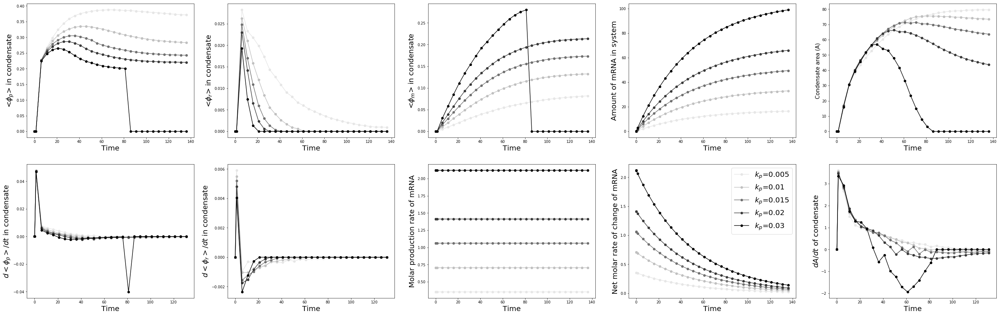

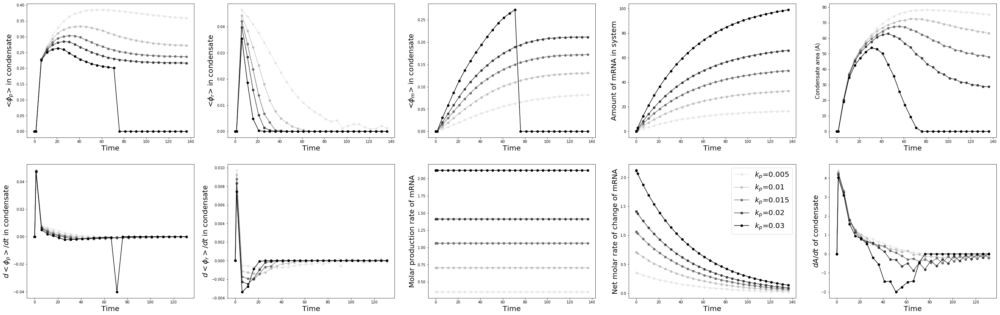

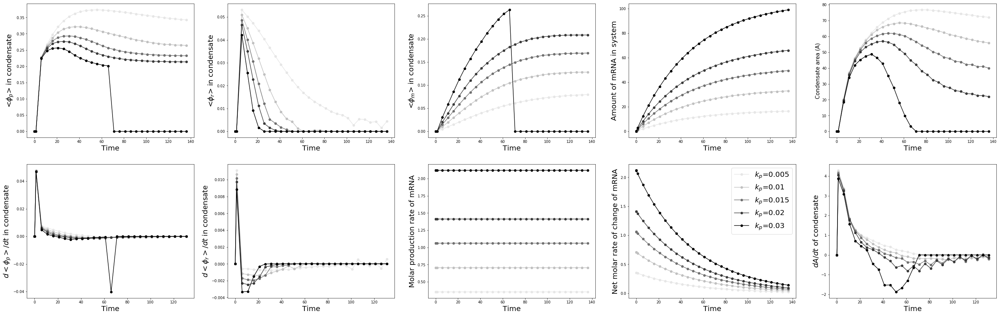

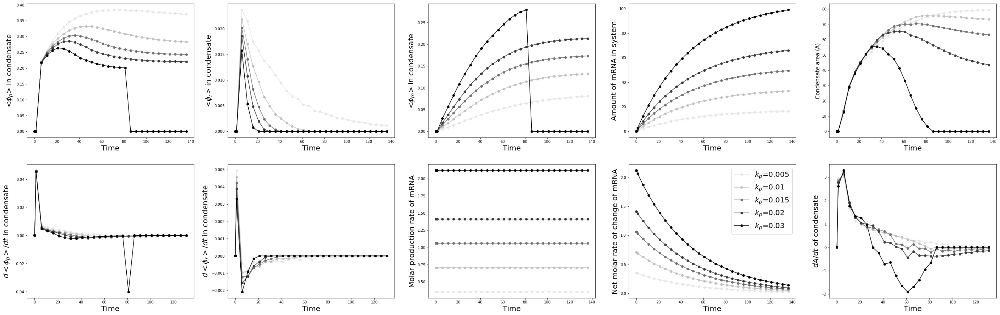

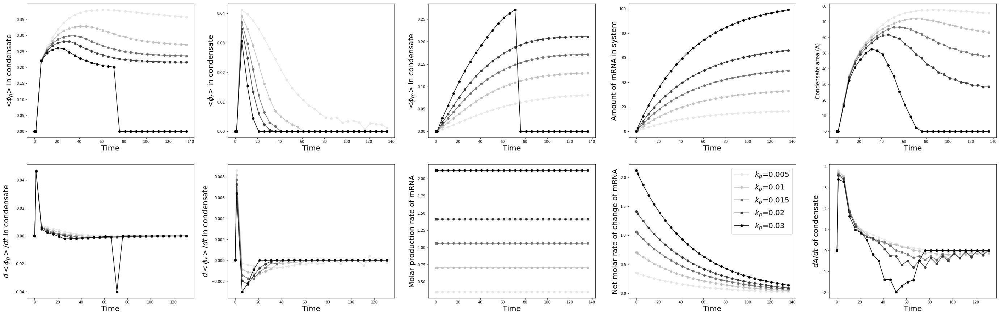

...

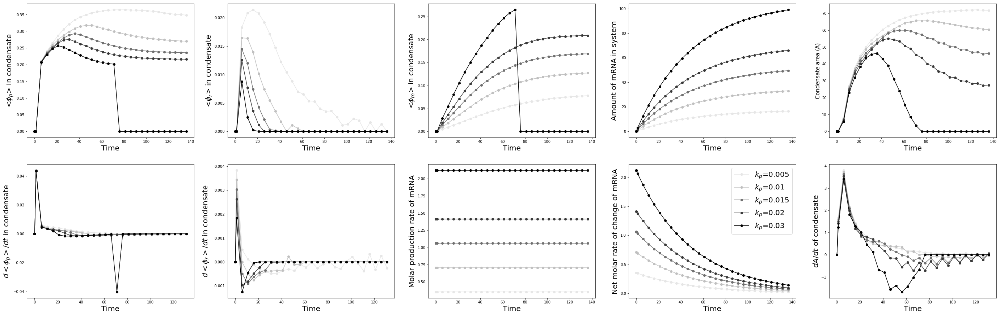

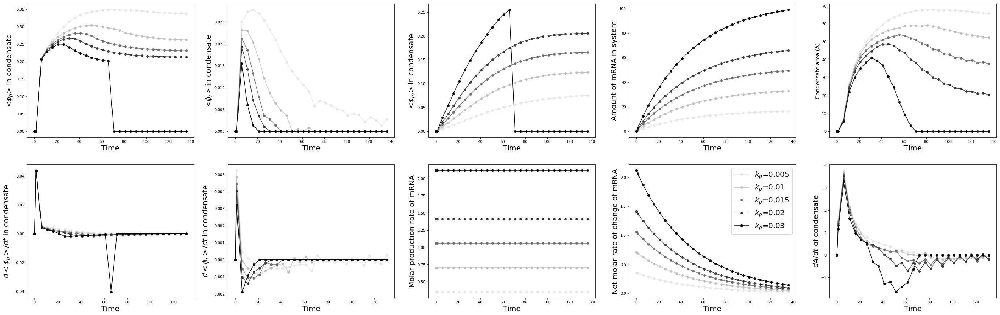

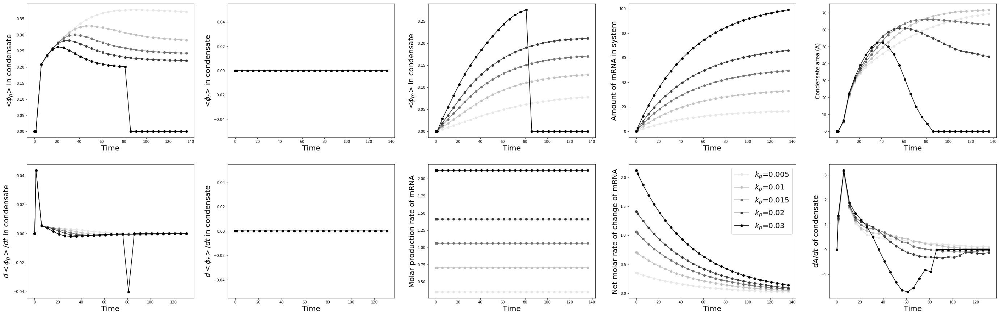

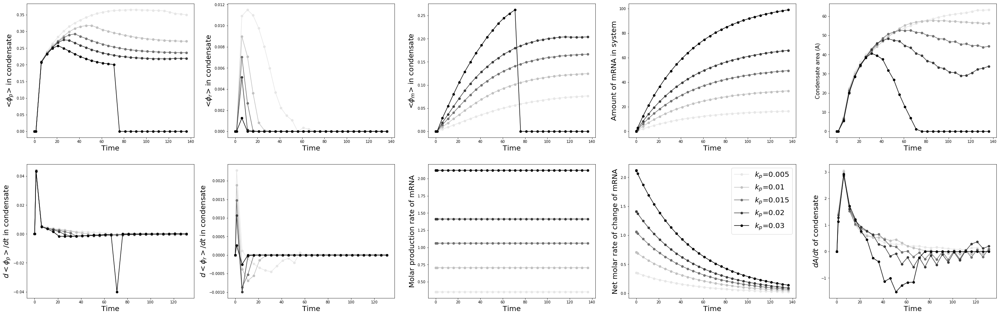

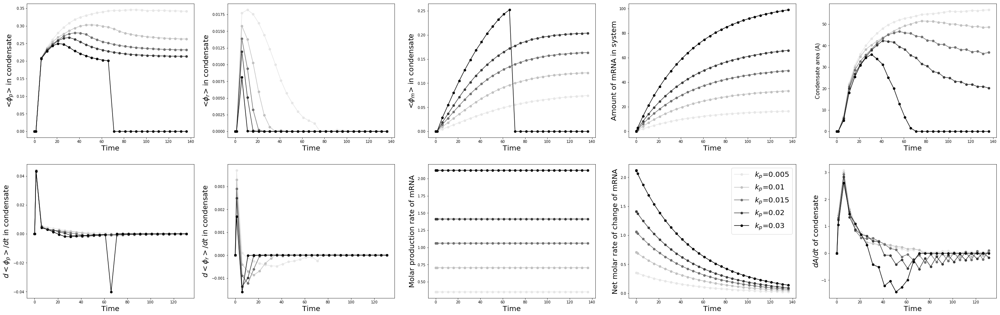

In [64]:
# Plot the same thing but for variations in phi_r

activity_and_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/LINEAR_0.0/"
activity_no_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/LINEAR_0.0/"
kp_list = [0.005,0.01,0.015,0.02,0.03]
L_P_list = [3.0,4.0,5.0,7.0,10.0]
phi_r_list = [1.0,5.0,10.0]

gray_colors = cm.get_cmap('Greys', len(kp_list)+7)
color_values = np.linspace(0.2,1.0,len(kp_list))

for k in range(len(L_P_list)):
    for i in range(len(phi_r_list)):
        
        fig, axs = plt.subplots(2,5,figsize=(48,15))
        
        for j in range(len(kp_list)):

#             if kp_list[j] == 0.0:
#                 only_activity_dynamics_file = activity_no_lncrna_directory + "phi_r_0.0_L_P_0.0_k_p_0.0_reactiontype_2.0_thresh_0.0_FE_5.0_rhoc_20.0_MP_1.0_Mmrna_0.01/dynamical_trajectories.hdf5"
#             else:
#                 only_activity_dynamics_file = activity_no_lncrna_directory + "phi_r_0.0_L_P_0.0_k_p_{}_reactiontype_2.0_thresh_0.0_FE_5.0_rhoc_20.0_MP_1.0_Mmrna_0.01/dynamical_trajectories.hdf5".format(kp_list[j])
            
#             with h5py.File(only_activity_dynamics_file) as sp_f: 

#                 axs[0,0].plot(sp_f['t'],sp_f['average_protein_in_condensate'], '-o', c='brown')
#                 axs[0,0].set_xlabel('Time', fontsize=20)
#                 axs[0,0].set_ylabel(r'<$\phi_p$> in condensate', fontsize=20)
#                 # axs[0,0].set_ylim([0.4,0.6])

#                 axs[0,1].plot(sp_f['t'],sp_f['average_lncrna_in_condensate'], '-o', c='brown')
#                 axs[0,1].set_xlabel('Time', fontsize=20)
#                 axs[0,1].set_ylabel(r'<$\phi_r$> in condensate', fontsize=20)

#                 axs[0,2].plot(sp_f['t'],sp_f['average_mrna_in_condensate'], '-o', c='brown')
#                 axs[0,2].set_xlabel('Time', fontsize=20)
#                 axs[0,2].set_ylabel(r'<$\phi_m$> in condensate', fontsize=20)

#                 axs[0,3].plot(sp_f['t'],sp_f['total_amount_of_mrna'], '-o', c='brown')
#                 axs[0,3].set_xlabel('Time', fontsize=20)
#                 axs[0,3].set_ylabel(r'Amount of mRNA in system', fontsize=20)

#                 axs[0,4].plot(sp_f['t'],sp_f['condensate_area'], '-o', c='brown')
#                 axs[0,4].set_xlabel('Time', fontsize=20)
#                 axs[0,4].set_ylabel(r'Condensate area (A)', fontsize=15)

#                 p_conc_growth_rate = (sp_f['average_protein_in_condensate'][1:]-sp_f['average_protein_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
#                 p_conc_growth_rate[p_conc_growth_rate > 0.05] = 0.0
#                 axs[1,0].plot(sp_f['t'][:-1], p_conc_growth_rate, '-o', c='brown')
#                 axs[1,0].set_xlabel('Time', fontsize=20)
#                 axs[1,0].set_ylabel(r'$d<\phi_p>/dt$ in condensate', fontsize=20)

#                 l_conc_growth_rate = (sp_f['average_lncrna_in_condensate'][1:]-sp_f['average_lncrna_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
#                 # p_conc_growth_rate[conc_growth_rate > 0.02] = 0.0
#                 axs[1,1].plot(sp_f['t'][:-1], l_conc_growth_rate, '-o', c='brown')
#                 axs[1,1].set_xlabel('Time', fontsize=20)
#                 axs[1,1].set_ylabel(r'$d<\phi_r>/dt$ in condensate', fontsize=20)

#                 axs[1,2].plot(sp_f['t'],sp_f['molar_rate_of_mrna_production'], '-o', c='brown')
#                 axs[1,2].set_xlabel('Time', fontsize=20)
#                 axs[1,2].set_ylabel(r'Molar production rate of mRNA', fontsize=20)

#                 axs[1,3].plot(sp_f['t'],sp_f['net_rate_of_mrna_increase'], '-o', c='brown', label="No lncRNA")
#                 axs[1,3].set_xlabel('Time', fontsize=20)
#                 axs[1,3].set_ylabel(r'Net molar rate of change of mRNA', fontsize=20)  
#                 axs[1,3].legend(fontsize=20) 

#                 area_growth_rate = (sp_f['condensate_area'][1:]-sp_f['condensate_area'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
#                 axs[1,4].plot(sp_f['t'][:-1], area_growth_rate, '-o', c='brown')
#                 axs[1,4].set_xlabel('Time', fontsize=20)
#                 axs[1,4].set_ylabel(r'$dA/dt$ of condensate', fontsize=20)

            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[i],L_P_list[k],kp_list[j]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 

                        axs[0,0].plot(sp_f['t'],sp_f['average_protein_in_condensate'], '-o', c=gray_colors(color_values[j]))
                        axs[0,0].set_xlabel('Time', fontsize=20)
                        axs[0,0].set_ylabel(r'<$\phi_p$> in condensate', fontsize=20)
                        # axs[0,0].set_ylim([0.4,0.7])

                        axs[0,1].plot(sp_f['t'],sp_f['average_lncrna_in_condensate'], '-o', c=gray_colors(color_values[j]))
                        axs[0,1].set_xlabel('Time', fontsize=20)
                        axs[0,1].set_ylabel(r'<$\phi_r$> in condensate', fontsize=20)

                        axs[0,2].plot(sp_f['t'],sp_f['average_mrna_in_condensate'], '-o', c=gray_colors(color_values[j]))
                        axs[0,2].set_xlabel('Time', fontsize=20)
                        axs[0,2].set_ylabel(r'<$\phi_m$> in condensate', fontsize=20)

                        axs[0,3].plot(sp_f['t'],sp_f['total_amount_of_mrna'], '-o', c=gray_colors(color_values[j]))
                        axs[0,3].set_xlabel('Time', fontsize=20)
                        axs[0,3].set_ylabel(r'Amount of mRNA in system', fontsize=20)

                        axs[0,4].plot(sp_f['t'],sp_f['condensate_area'], '-o', c=gray_colors(color_values[j]))
                        axs[0,4].set_xlabel('Time', fontsize=20)
                        axs[0,4].set_ylabel(r'Condensate area (A)', fontsize=15)

                        p_conc_growth_rate = (sp_f['average_protein_in_condensate'][1:]-sp_f['average_protein_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                        p_conc_growth_rate[p_conc_growth_rate > 0.05] = 0.0
                        axs[1,0].plot(sp_f['t'][:-1], p_conc_growth_rate, '-o', c=gray_colors(color_values[j]))
                        axs[1,0].set_xlabel('Time', fontsize=20)
                        axs[1,0].set_ylabel(r'$d<\phi_p>/dt$ in condensate', fontsize=20)

                        l_conc_growth_rate = (sp_f['average_lncrna_in_condensate'][1:]-sp_f['average_lncrna_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                        # p_conc_growth_rate[conc_growth_rate > 0.02] = 0.0
                        axs[1,1].plot(sp_f['t'][:-1], l_conc_growth_rate, '-o', c=gray_colors(color_values[j]))
                        axs[1,1].set_xlabel('Time', fontsize=20)
                        axs[1,1].set_ylabel(r'$d<\phi_r>/dt$ in condensate', fontsize=20)

                        axs[1,2].plot(sp_f['t'],sp_f['molar_rate_of_mrna_production'], '-o', c=gray_colors(color_values[j]))
                        axs[1,2].set_xlabel('Time', fontsize=20)
                        axs[1,2].set_ylabel(r'Molar production rate of mRNA', fontsize=20)

                        axs[1,3].plot(sp_f['t'],sp_f['net_rate_of_mrna_increase'], '-o', c=gray_colors(color_values[j]), label="$k_p$="+str(kp_list[j]))
                        axs[1,3].set_xlabel('Time', fontsize=20)
                        axs[1,3].set_ylabel(r'Net molar rate of change of mRNA', fontsize=20)  
                        axs[1,3].legend(fontsize=20) 

                        area_growth_rate = (sp_f['condensate_area'][1:]-sp_f['condensate_area'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                        axs[1,4].plot(sp_f['t'][:-1], area_growth_rate, '-o', c=gray_colors(color_values[j]))
                        axs[1,4].set_xlabel('Time', fontsize=20)
                        axs[1,4].set_ylabel(r'$dA/dt$ of condensate', fontsize=20)

        # plt.savefig('20210604-CORRECT_FE/Only_activity_linear_0.4_dynamical_trajectories.png', format='png', dpi=1200)
        plt.savefig('20210709-CORRECT_FE_LINEAR_MRNA_PRODUCTION/lncrna_and_activity_linear_0.0_phir_{}_LP_{}_dynamical_trajectories.svg'.format(phi_r_list[i],L_P_list[k]), format='svg', dpi=1200)
        plt.show()
        plt.close()

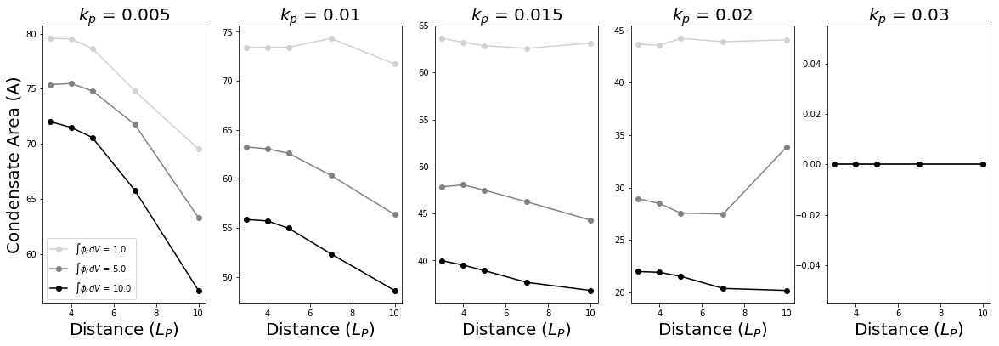

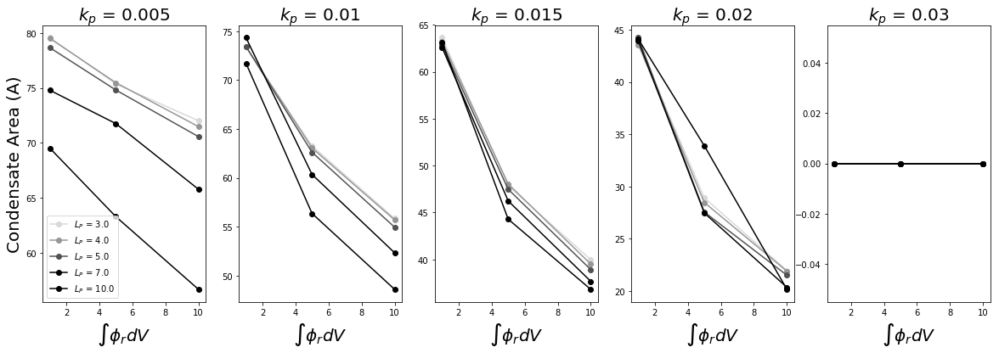

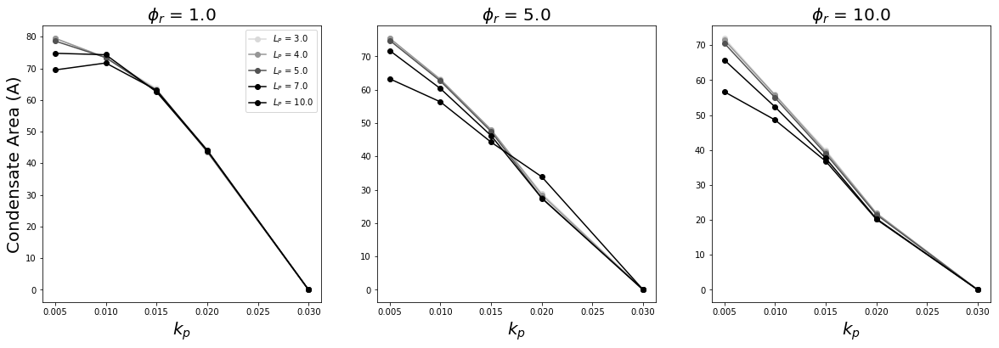

In [66]:
activity_and_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/LINEAR_0.0/"
activity_no_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/LINEAR_0.0/"
kp_list = [0.005,0.01,0.015,0.02,0.03]
L_P_list = [3.0,4.0,5.0,7.0,10.0]
phi_r_list = [1.0,5.0,10.0]

#################################

dynamical_variable_name = 'condensate_area'
gray_colors = cm.get_cmap('Greys', len(phi_r_list)+5)
color_values = np.linspace(0.3,0.9,len(phi_r_list))

fig, axs = plt.subplots(1,len(kp_list),figsize=(20,6))
for i in range(len(kp_list)):
    for k in range(len(phi_r_list)):
        ss_values = np.zeros(len(L_P_list))
        for j in range(len(L_P_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[j] = sp_f[dynamical_variable_name][-1]
        axs[i].plot(L_P_list, ss_values, '-o', label='$\int\phi_rdV$ = '+str(phi_r_list[k]), c=gray_colors(color_values[k]))
    axs[i].set_xlabel('Distance ($L_P$)',fontsize=20)
    axs[0].set_ylabel('Condensate Area (A)',fontsize=20)
    axs[i].set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=20)
    axs[0].legend()

plt.savefig('20210709-CORRECT_FE_LINEAR_MRNA_PRODUCTION/lncrna_and_activity_linear_0_steady_state_vs_LP_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

dynamical_variable_name = 'condensate_area'
gray_colors = cm.get_cmap('Greys', len(L_P_list))
color_values = np.linspace(0.2,1,len(L_P_list))

fig, axs = plt.subplots(1,len(kp_list),figsize=(20,6))
for i in range(len(kp_list)):
    for j in range(len(L_P_list)):
        ss_values = np.zeros(len(phi_r_list))
        for k in range(len(phi_r_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[k] = sp_f[dynamical_variable_name][-1]
        axs[i].plot(phi_r_list, ss_values, '-o', label=r'$L_P$ = '+str(L_P_list[j]), c=gray_colors(color_values[j]))
    axs[i].set_xlabel('$\int\phi_rdV$',fontsize=20)
    axs[0].set_ylabel('Condensate Area (A)',fontsize=20)
    axs[i].set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=20)
    axs[0].legend()

plt.savefig('20210709-CORRECT_FE_LINEAR_MRNA_PRODUCTION/lncrna_and_activity_linear_0_steady_state_vs_phir_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

dynamical_variable_name = 'condensate_area'
gray_colors = cm.get_cmap('Greys', len(L_P_list))
color_values = np.linspace(0.2,1,len(L_P_list))

fig, axs = plt.subplots(1,len(phi_r_list),figsize=(20,6))
for k in range(len(phi_r_list)):
    for j in range(len(L_P_list)):
        ss_values = np.zeros(len(kp_list))
        for i in range(len(kp_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[i] = sp_f[dynamical_variable_name][-1]
        axs[k].plot(kp_list, ss_values, '-o', label=r'$L_P$ = '+str(L_P_list[j]), c=gray_colors(color_values[j]))
    axs[k].set_xlabel('$k_p$',fontsize=20)
    axs[0].set_ylabel('Condensate Area (A)',fontsize=20)
    axs[k].set_title(r'$\phi_r$ = ' + str(phi_r_list[k]), fontsize=20)
    axs[0].legend()

plt.savefig('20210709-CORRECT_FE_LINEAR_MRNA_PRODUCTION/lncrna_and_activity_linear_0_steady_state_vs_kp_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

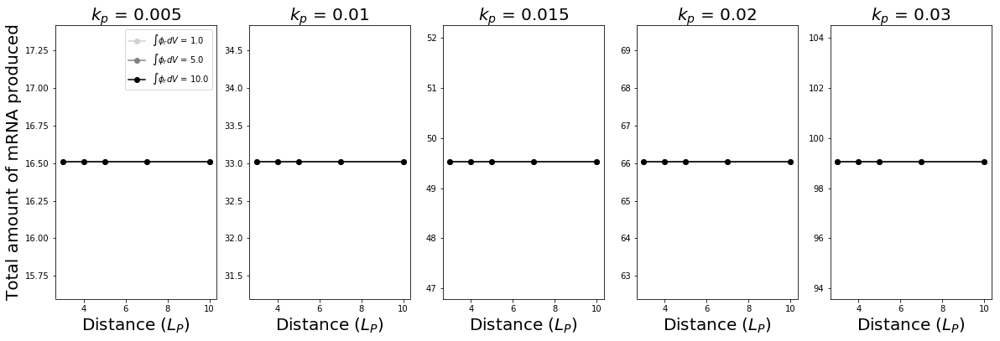

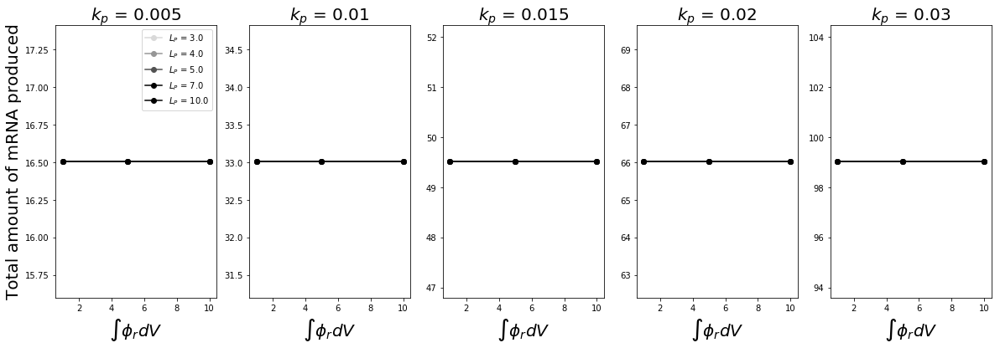

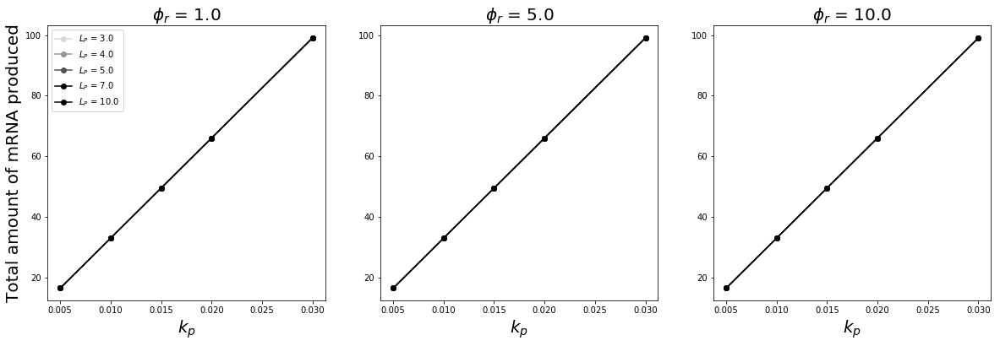

In [67]:
dynamical_variable_name = 'total_amount_of_mrna'
gray_colors = cm.get_cmap('Greys', len(phi_r_list)+5)
color_values = np.linspace(0.3,0.9,len(phi_r_list))

fig, axs = plt.subplots(1,len(kp_list),figsize=(20,6))
for i in range(len(kp_list)):
    for k in range(len(phi_r_list)):
        ss_values = np.zeros(len(L_P_list))
        for j in range(len(L_P_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[j] = sp_f[dynamical_variable_name][-1]
        axs[i].plot(L_P_list, ss_values, '-o', label='$\int\phi_rdV$ = '+str(phi_r_list[k]), c=gray_colors(color_values[k]))
    axs[i].set_xlabel('Distance ($L_P$)',fontsize=20)
    axs[0].set_ylabel('Total amount of mRNA produced',fontsize=20)
    axs[i].set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=20)
    axs[0].legend()

plt.savefig('20210709-CORRECT_FE_LINEAR_MRNA_PRODUCTION/lncrna_and_activity_linear_0_steady_state_vs_LP_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

gray_colors = cm.get_cmap('Greys', len(L_P_list))
color_values = np.linspace(0.2,1,len(L_P_list))

fig, axs = plt.subplots(1,len(kp_list),figsize=(20,6))
for i in range(len(kp_list)):
    for j in range(len(L_P_list)):
        ss_values = np.zeros(len(phi_r_list))
        for k in range(len(phi_r_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[k] = sp_f[dynamical_variable_name][-1]
        axs[i].plot(phi_r_list, ss_values, '-o', label=r'$L_P$ = '+str(L_P_list[j]), c=gray_colors(color_values[j]))
    axs[i].set_xlabel('$\int\phi_rdV$',fontsize=20)
    axs[0].set_ylabel('Total amount of mRNA produced',fontsize=20)
    axs[i].set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=20)
    axs[0].legend()

plt.savefig('20210709-CORRECT_FE_LINEAR_MRNA_PRODUCTION/lncrna_and_activity_linear_0_steady_state_vs_phir_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

fig, axs = plt.subplots(1,len(phi_r_list),figsize=(20,6))
for k in range(len(phi_r_list)):
    for j in range(len(L_P_list)):
        ss_values = np.zeros(len(kp_list))
        for i in range(len(kp_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[i] = sp_f[dynamical_variable_name][-1]
        axs[k].plot(kp_list, ss_values, '-o', label=r'$L_P$ = '+str(L_P_list[j]), c=gray_colors(color_values[j]))
    axs[k].set_xlabel('$k_p$',fontsize=20)
    axs[0].set_ylabel('Total amount of mRNA produced',fontsize=20)
    axs[k].set_title(r'$\phi_r$ = ' + str(phi_r_list[k]), fontsize=20)
    axs[0].legend()

plt.savefig('20210709-CORRECT_FE_LINEAR_MRNA_PRODUCTION/lncrna_and_activity_linear_0_steady_state_vs_kp_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

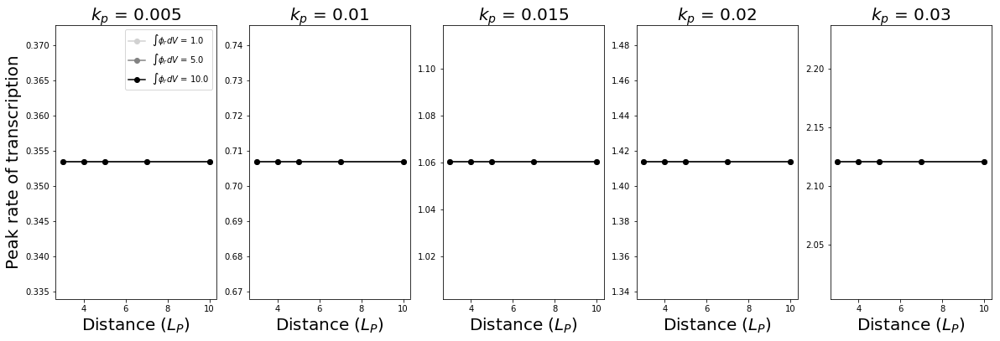

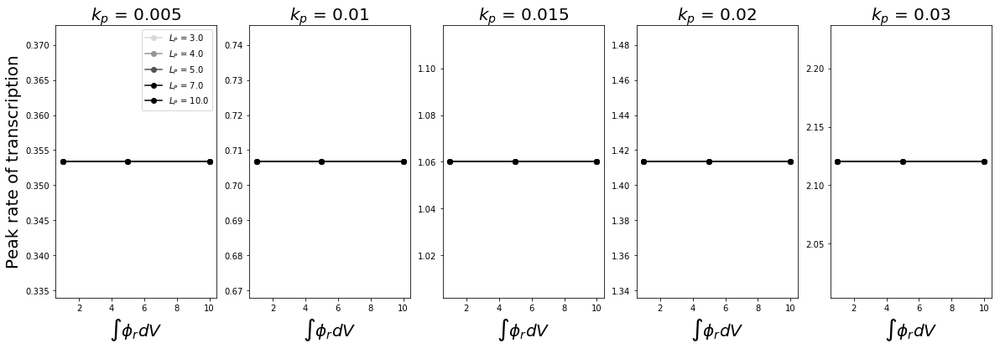

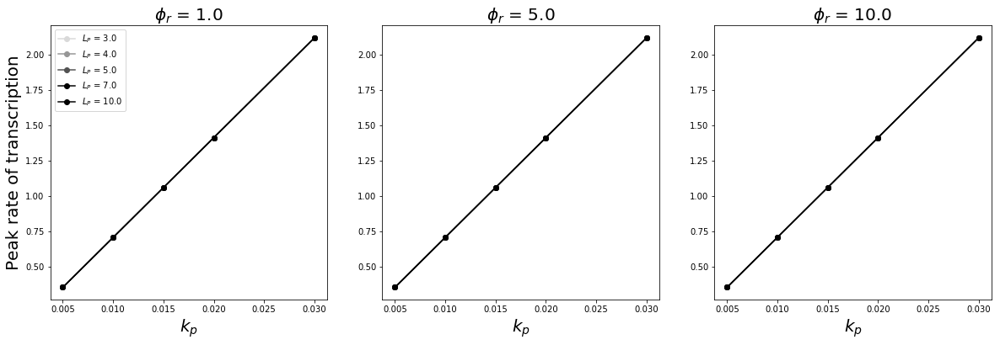

In [69]:
dynamical_variable_name = 'net_rate_of_mrna_increase'
gray_colors = cm.get_cmap('Greys', len(phi_r_list)+5)
color_values = np.linspace(0.3,0.9,len(phi_r_list))

fig, axs = plt.subplots(1,len(kp_list),figsize=(20,6))
for i in range(len(kp_list)):
    for k in range(len(phi_r_list)):
        ss_values = np.zeros(len(L_P_list))
        for j in range(len(L_P_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[j] = np.max(sp_f[dynamical_variable_name])
        axs[i].plot(L_P_list, ss_values, '-o', label='$\int\phi_rdV$ = '+str(phi_r_list[k]), c=gray_colors(color_values[k]))
    axs[i].set_xlabel('Distance ($L_P$)',fontsize=20)
    axs[0].set_ylabel('Peak rate of transcription',fontsize=20)
    axs[i].set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=20)
    axs[0].legend()

plt.savefig('20210709-CORRECT_FE_LINEAR_MRNA_PRODUCTION/lncrna_and_activity_linear_0_steady_state_vs_LP_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

gray_colors = cm.get_cmap('Greys', len(L_P_list))
color_values = np.linspace(0.2,1,len(L_P_list))

fig, axs = plt.subplots(1,len(kp_list),figsize=(20,6))
for i in range(len(kp_list)):
    for j in range(len(L_P_list)):
        ss_values = np.zeros(len(phi_r_list))
        for k in range(len(phi_r_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[k] = np.max(sp_f[dynamical_variable_name])
        axs[i].plot(phi_r_list, ss_values, '-o', label=r'$L_P$ = '+str(L_P_list[j]), c=gray_colors(color_values[j]))
    axs[i].set_xlabel('$\int\phi_rdV$',fontsize=20)
    axs[0].set_ylabel('Peak rate of transcription',fontsize=20)
    axs[i].set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=20)
    axs[0].legend()

plt.savefig('20210709-CORRECT_FE_LINEAR_MRNA_PRODUCTION/lncrna_and_activity_linear_0_steady_state_vs_phir_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

fig, axs = plt.subplots(1,len(phi_r_list),figsize=(20,6))
for k in range(len(phi_r_list)):
    for j in range(len(L_P_list)):
        ss_values = np.zeros(len(kp_list))
        for i in range(len(kp_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[i] = np.max(sp_f[dynamical_variable_name])
        axs[k].plot(kp_list, ss_values, '-o', label=r'$L_P$ = '+str(L_P_list[j]), c=gray_colors(color_values[j]))
    axs[k].set_xlabel('$k_p$',fontsize=20)
    axs[0].set_ylabel('Peak rate of transcription',fontsize=20)
    axs[k].set_title(r'$\phi_r$ = ' + str(phi_r_list[k]), fontsize=20)
    axs[0].legend()

plt.savefig('20210709-CORRECT_FE_LINEAR_MRNA_PRODUCTION/lncrna_and_activity_linear_0_steady_state_vs_kp_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

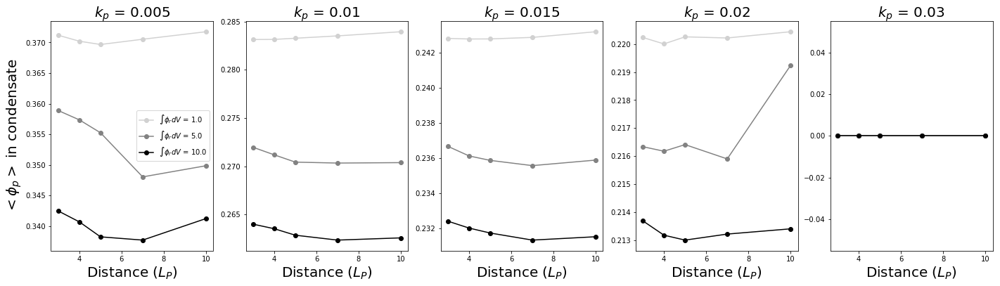

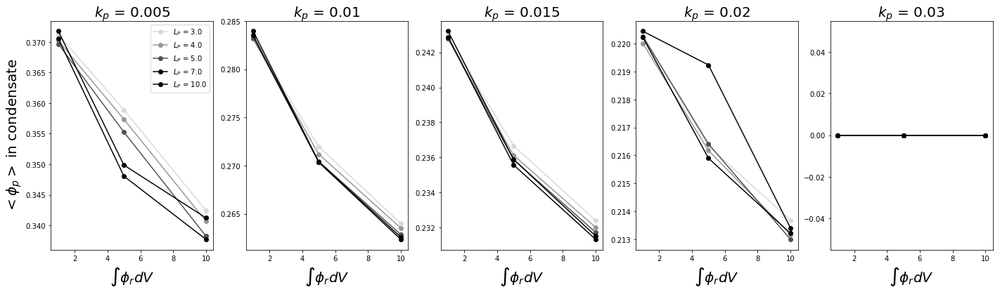

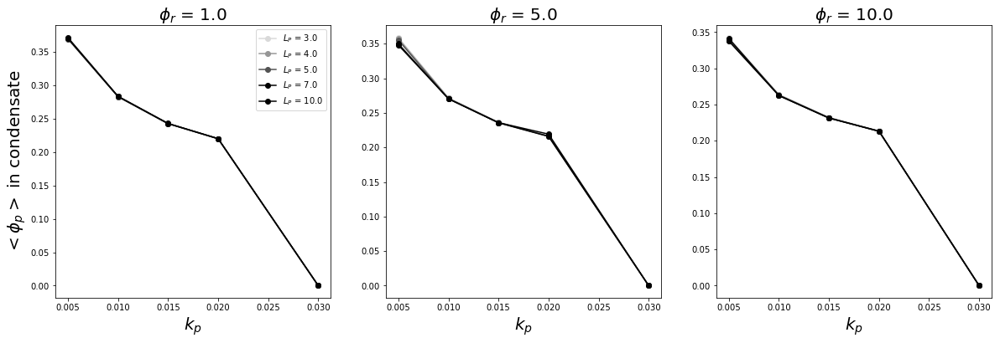

In [70]:
dynamical_variable_name = 'average_protein_in_condensate'
gray_colors = cm.get_cmap('Greys', len(phi_r_list)+5)
color_values = np.linspace(0.3,0.9,len(phi_r_list))

fig, axs = plt.subplots(1,len(kp_list),figsize=(24,6))
for i in range(len(kp_list)):
    for k in range(len(phi_r_list)):
        ss_values = np.zeros(len(L_P_list))
        for j in range(len(L_P_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[j] = sp_f[dynamical_variable_name][-1]
        axs[i].plot(L_P_list, ss_values, '-o', label='$\int\phi_rdV$ = '+str(phi_r_list[k]), c=gray_colors(color_values[k]))
    axs[i].set_xlabel('Distance ($L_P$)',fontsize=20)
    axs[0].set_ylabel('$<\phi_p>$ in condensate',fontsize=20)
    axs[i].set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=20)
    axs[0].legend()

plt.savefig('20210709-CORRECT_FE_LINEAR_MRNA_PRODUCTION/lncrna_and_activity_linear_0_steady_state_vs_LP_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

gray_colors = cm.get_cmap('Greys', len(L_P_list))
color_values = np.linspace(0.2,1,len(L_P_list))

fig, axs = plt.subplots(1,len(kp_list),figsize=(24,6))
for i in range(len(kp_list)):
    for j in range(len(L_P_list)):
        ss_values = np.zeros(len(phi_r_list))
        for k in range(len(phi_r_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}.*_L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[k] = sp_f[dynamical_variable_name][-1]
        axs[i].plot(phi_r_list, ss_values, '-o', label='$L_P$ = '+str(L_P_list[j]), c=gray_colors(color_values[j]))
    axs[i].set_xlabel('$\int\phi_rdV$',fontsize=20)
    axs[0].set_ylabel('$<\phi_p>$ in condensate',fontsize=20)
    axs[i].set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=20)
    axs[0].legend()

plt.savefig('20210709-CORRECT_FE_LINEAR_MRNA_PRODUCTION/lncrna_and_activity_linear_0_steady_state_vs_phir_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

fig, axs = plt.subplots(1,len(phi_r_list),figsize=(20,6))
for k in range(len(phi_r_list)):
    for j in range(len(L_P_list)):
        ss_values = np.zeros(len(kp_list))
        for i in range(len(kp_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}.*_L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[i] = sp_f[dynamical_variable_name][-1]
        axs[k].plot(kp_list, ss_values, '-o', label=r'$L_P$ = '+str(L_P_list[j]), c=gray_colors(color_values[j]))
    axs[k].set_xlabel('$k_p$',fontsize=20)
    axs[0].set_ylabel('$<\phi_p>$ in condensate',fontsize=20)
    axs[k].set_title(r'$\phi_r$ = ' + str(phi_r_list[k]), fontsize=20)
    axs[0].legend()

plt.savefig('20210709-CORRECT_FE_LINEAR_MRNA_PRODUCTION/lncrna_and_activity_linear_0_steady_state_vs_kp_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

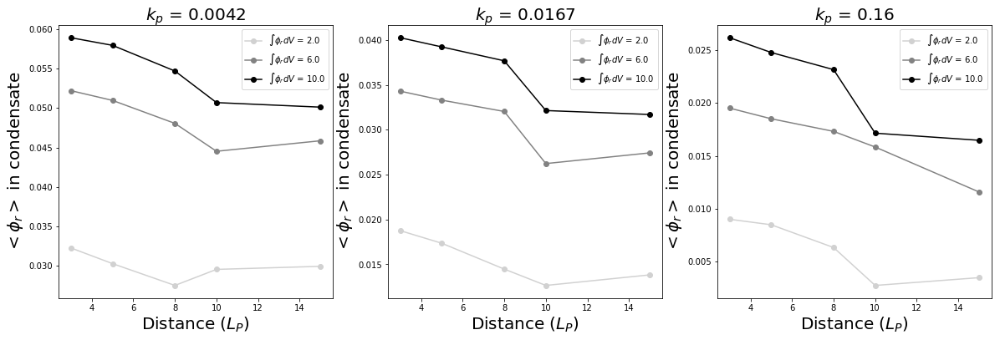

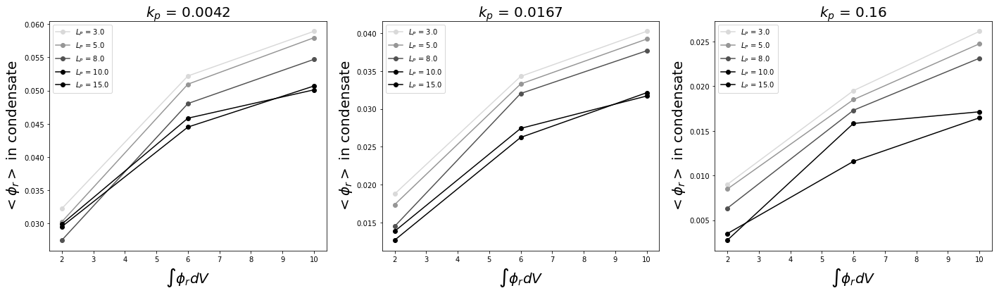

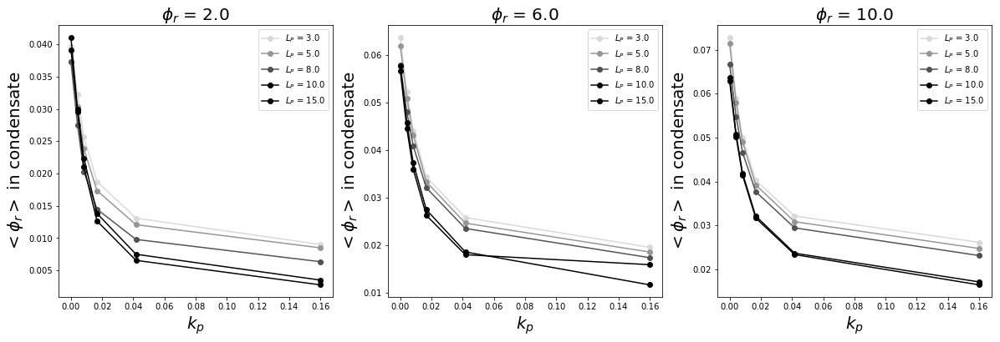

In [109]:
dynamical_variable_name = 'average_lncrna_in_condensate'
gray_colors = cm.get_cmap('Greys', len(phi_r_list)+5)
color_values = np.linspace(0.3,0.9,len(phi_r_list))

fig, axs = plt.subplots(1,len(kp_list),figsize=(20,6))
for i in range(len(kp_list)):
    for k in range(len(phi_r_list)):
        ss_values = np.zeros(len(L_P_list))
        for j in range(len(L_P_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.4_FE_7.0_rhoc_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[j] = sp_f[dynamical_variable_name][-1]
        axs[i].plot(L_P_list, ss_values, '-o', label='$\int\phi_rdV$ = '+str(phi_r_list[k]), c=gray_colors(color_values[k]))
    axs[i].set_xlabel('Distance ($L_P$)',fontsize=20)
    axs[0].set_ylabel('$<\phi_r>$ in condensate',fontsize=20)
    axs[i].set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=20)
    axs[0].legend()

plt.savefig('20210604-CORRECT_FE/lncrna_and_activity_linear_0.4_steady_state_vs_LP_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

gray_colors = cm.get_cmap('Greys', len(L_P_list))
color_values = np.linspace(0.2,1,len(L_P_list))

fig, axs = plt.subplots(1,len(kp_list),figsize=(24,6))
for i in range(len(kp_list)):
    for j in range(len(L_P_list)):
        ss_values = np.zeros(len(phi_r_list))
        for k in range(len(phi_r_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.4_FE_7.0_rhoc_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[k] = sp_f[dynamical_variable_name][-1]
        axs[i].plot(phi_r_list, ss_values, '-o', label='$L_P$ = '+str(L_P_list[j]), c=gray_colors(color_values[j]))
    axs[i].set_xlabel('$\int\phi_rdV$',fontsize=20)
    axs[0].set_ylabel('$<\phi_r>$ in condensate',fontsize=20)
    axs[i].set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=20)
    axs[0].legend()

plt.savefig('20210604-CORRECT_FE/lncrna_and_activity_linear_0.4_steady_state_vs_phir_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

fig, axs = plt.subplots(1,len(phi_r_list),figsize=(20,6))
for k in range(len(phi_r_list)):
    for j in range(len(L_P_list)):
        ss_values = np.zeros(len(kp_extended_list))
        for i in range(len(kp_extended_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.4_FE_7.0_rhoc_2.0$'.format(phi_r_list[k],L_P_list[j],kp_extended_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[i] = sp_f[dynamical_variable_name][-1]
        axs[k].plot(kp_extended_list, ss_values, '-o', label=r'$L_P$ = '+str(L_P_list[j]), c=gray_colors(color_values[j]))
    axs[k].set_xlabel('$k_p$',fontsize=20)
    axs[0].set_ylabel('$<\phi_r>$ in condensate',fontsize=20)
    axs[k].set_title(r'$\phi_r$ = ' + str(phi_r_list[k]), fontsize=20)
    axs[0].legend()

    plt.savefig('20210604-CORRECT_FE/lncrna_and_activity_linear_0.4_steady_state_vs_kp_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

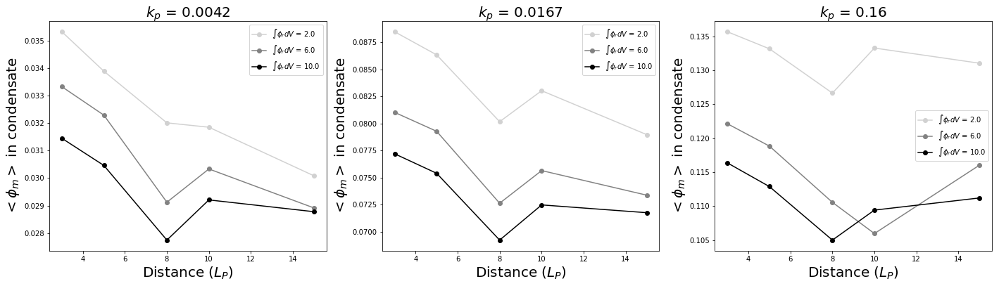

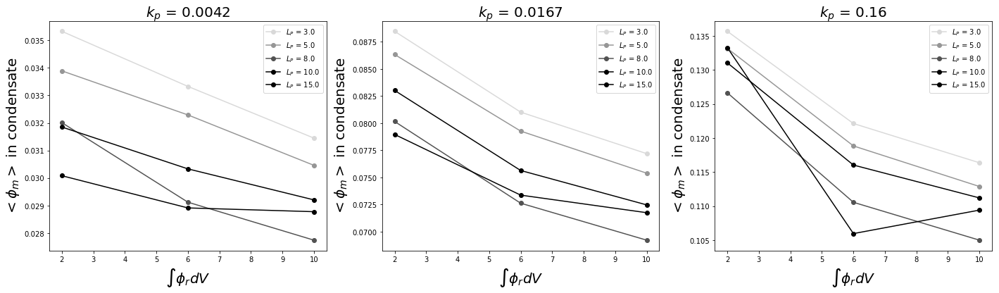

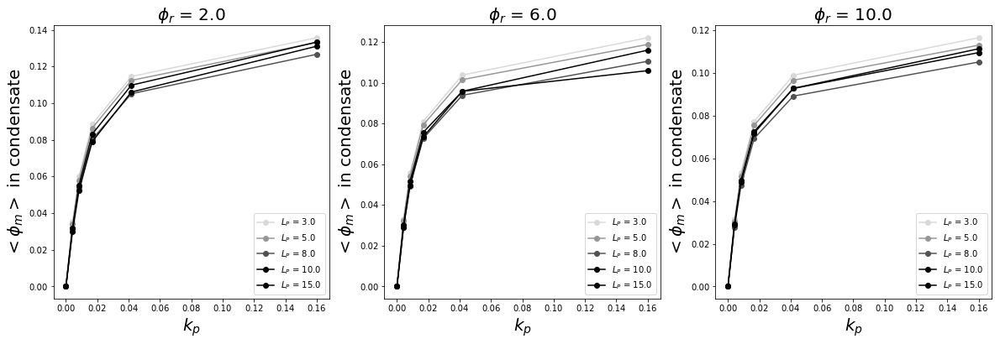

In [114]:
dynamical_variable_name = 'average_mrna_in_condensate'
gray_colors = cm.get_cmap('Greys', len(phi_r_list)+5)
color_values = np.linspace(0.3,0.9,len(phi_r_list))

fig, axs = plt.subplots(1,len(kp_list),figsize=(24,6))
for i in range(len(kp_list)):
    for k in range(len(phi_r_list)):
        ss_values = np.zeros(len(L_P_list))
        for j in range(len(L_P_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.4_FE_7.0_rhoc_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[j] = sp_f[dynamical_variable_name][-1]
        axs[i].plot(L_P_list, ss_values, '-o', label='$\int\phi_rdV$ = '+str(phi_r_list[k]), c=gray_colors(color_values[k]))
    axs[i].set_xlabel('Distance ($L_P$)',fontsize=20)
    axs[i].set_ylabel('$<\phi_m>$ in condensate',fontsize=20)
    axs[i].set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=20)
    axs[i].legend()

plt.savefig('20210604-CORRECT_FE/lncrna_and_activity_linear_0.4_steady_state_vs_LP_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

gray_colors = cm.get_cmap('Greys', len(L_P_list))
color_values = np.linspace(0.2,1,len(L_P_list))

fig, axs = plt.subplots(1,len(kp_list),figsize=(24,6))
for i in range(len(kp_list)):
    for j in range(len(L_P_list)):
        ss_values = np.zeros(len(phi_r_list))
        for k in range(len(phi_r_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.4_FE_7.0_rhoc_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[k] = sp_f[dynamical_variable_name][-1]
        axs[i].plot(phi_r_list, ss_values, '-o', label='$L_P$ = '+str(L_P_list[j]), c=gray_colors(color_values[j]))
    axs[i].set_xlabel('$\int\phi_rdV$',fontsize=20)
    axs[i].set_ylabel('$<\phi_m>$ in condensate',fontsize=20)
    axs[i].set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=20)
    axs[i].legend()

plt.savefig('20210604-CORRECT_FE/lncrna_and_activity_linear_0.4_steady_state_vs_phir_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

fig, axs = plt.subplots(1,len(phi_r_list),figsize=(20,6))
for k in range(len(phi_r_list)):
    for j in range(len(L_P_list)):
        ss_values = np.zeros(len(kp_extended_list))
        for i in range(len(kp_extended_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.4_FE_7.0_rhoc_2.0$'.format(phi_r_list[k],L_P_list[j],kp_extended_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[i] = sp_f[dynamical_variable_name][-1]
        axs[k].plot(kp_extended_list, ss_values, '-o', label=r'$L_P$ = '+str(L_P_list[j]), c=gray_colors(color_values[j]))
    axs[k].set_xlabel('$k_p$',fontsize=20)
    axs[k].set_ylabel('$<\phi_m>$ in condensate',fontsize=20)
    axs[k].set_title(r'$\phi_r$ = ' + str(phi_r_list[k]), fontsize=20)
    axs[k].legend()

plt.savefig('20210604-CORRECT_FE/lncrna_and_activity_linear_0.4_steady_state_vs_kp_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

### Symmetric vs Asymmetric expression for free energy

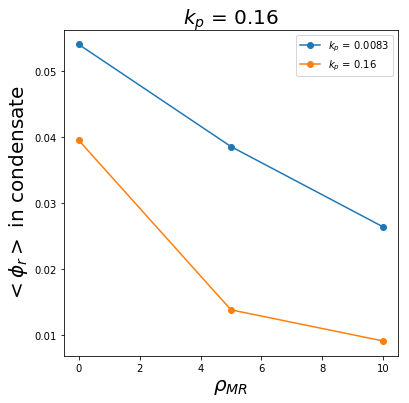

In [46]:
L_P = 7.0
rho_c_list = [0.0,5.0,10.0]
kp_list = [0.0083,0.16]

dynamical_variable_name = 'average_lncrna_in_condensate'
gray_colors = cm.get_cmap('winter', len(kp_list))

fig, axs = plt.subplots(1,1,figsize=(6,6))
for i in range(len(kp_list)):
    ss_values = np.zeros(len(rho_c_list))
    for j in range(len(rho_c_list)):
        for root, dirs, files in os.walk(activity_and_lncrna_directory):
            regex = re.compile(r'.*phi_r_10.0_L_P_7.0_k_p_{}_reactiontype_0.0_thresh_0.4_FE_7.0_rhoc_{}$'.format(kp_list[i],rho_c_list[j]))
            match = re.search(regex, root)
            if match != None:
                with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                    ss_values[j] = sp_f[dynamical_variable_name][-1]
    axs.plot(rho_c_list, ss_values, '-o', label='$k_p$ = '+str(kp_list[i]))
    axs.set_xlabel(r'$\rho_{MR}$',fontsize=20)
    axs.set_ylabel('$<\phi_r>$ in condensate',fontsize=20)
    axs.set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=20)
    axs.legend()

plt.savefig('SYMMTERIC_VS_ASYMMTERIC_FE/lncrna_and_activity_linear_0.4_phi_r_vs_rho_c_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

## Analysis for larger range of kp values beyond 0.16

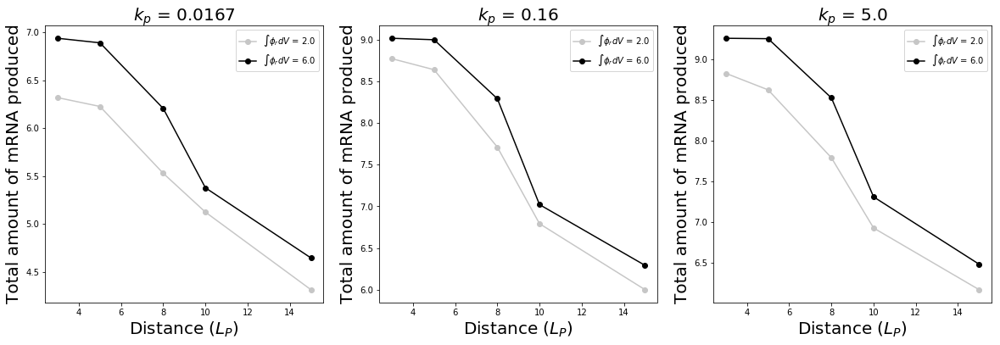

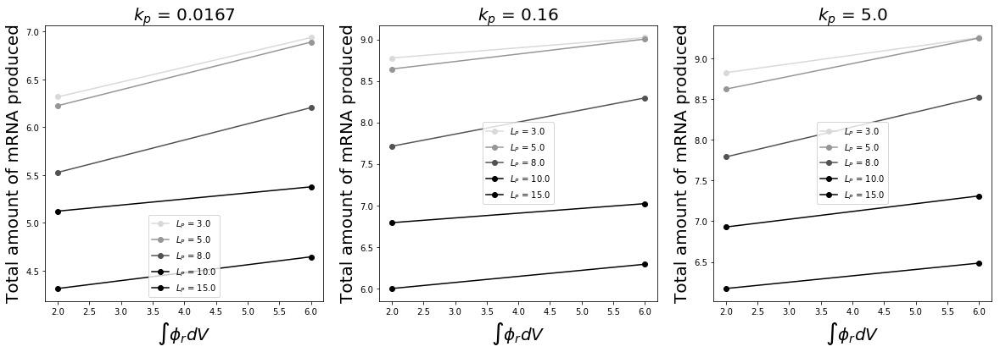

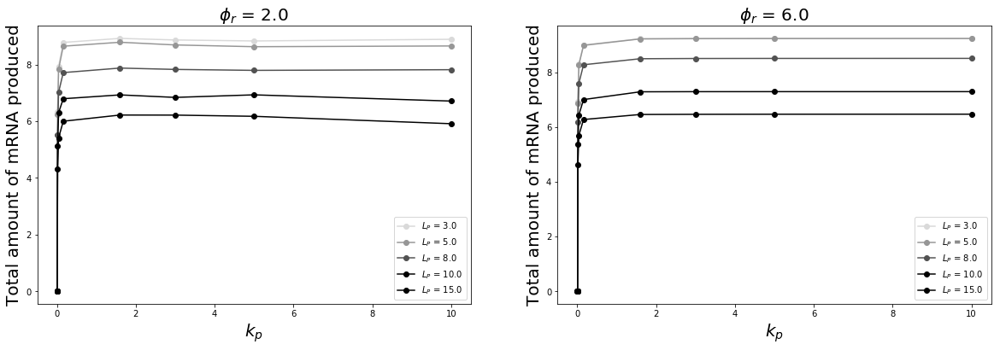

In [133]:
activity_and_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/K_RNA_1_LR_RNA_2.5/"
activity_no_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/LINEAR_0.4/"
kp_list = [0.0167,0.16,5.0]
kp_extended_list = [0.0,0.0042,0.0083,0.0167,0.0417,0.16,1.6,3.0,5.0,10.0]
L_P_list = [3.0,5.0,8.0,10.0,15.0]
phi_r_list = [2.0,6.0]

dynamical_variable_name = 'total_amount_of_mrna'
gray_colors = cm.get_cmap('Greys', len(phi_r_list)+5)
color_values = np.linspace(0.3,0.9,len(phi_r_list))

fig, axs = plt.subplots(1,len(kp_list),figsize=(20,6))
for i in range(len(kp_list)):
    for k in range(len(phi_r_list)):
        ss_values = np.zeros(len(L_P_list))
        for j in range(len(L_P_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.4_FE_7.0_rhoc_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[j] = sp_f[dynamical_variable_name][-1]
        axs[i].plot(L_P_list, ss_values, '-o', label='$\int\phi_rdV$ = '+str(phi_r_list[k]), c=gray_colors(color_values[k]))
    axs[i].set_xlabel('Distance ($L_P$)',fontsize=20)
    axs[i].set_ylabel('Total amount of mRNA produced',fontsize=20)
    axs[i].set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=20)
    axs[i].legend()

plt.savefig('20210604-CORRECT_FE/lncrna_and_activity_linear_0.4_steady_state_vs_LP_kplargerrange_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

gray_colors = cm.get_cmap('Greys', len(L_P_list))
color_values = np.linspace(0.2,1,len(L_P_list))

fig, axs = plt.subplots(1,len(kp_list),figsize=(20,6))
for i in range(len(kp_list)):
    for j in range(len(L_P_list)):
        ss_values = np.zeros(len(phi_r_list))
        for k in range(len(phi_r_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.4_FE_7.0_rhoc_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[k] = sp_f[dynamical_variable_name][-1]
        axs[i].plot(phi_r_list, ss_values, '-o', label=r'$L_P$ = '+str(L_P_list[j]), c=gray_colors(color_values[j]))
    axs[i].set_xlabel('$\int\phi_rdV$',fontsize=20)
    axs[i].set_ylabel('Total amount of mRNA produced',fontsize=20)
    axs[i].set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=20)
    axs[i].legend()

plt.savefig('20210604-CORRECT_FE/lncrna_and_activity_linear_0.4_steady_state_vs_phir_kplargerrange_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

fig, axs = plt.subplots(1,len(phi_r_list),figsize=(20,6))
for k in range(len(phi_r_list)):
    for j in range(len(L_P_list)):
        ss_values = np.zeros(len(kp_extended_list))
        for i in range(len(kp_extended_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_L_P_{}_k_p_{}_reactiontype_0.0_thresh_0.4_FE_7.0_rhoc_2.0$'.format(phi_r_list[k],L_P_list[j],kp_extended_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[i] = sp_f[dynamical_variable_name][-1]
        axs[k].plot(kp_extended_list, ss_values, '-o', label=r'$L_P$ = '+str(L_P_list[j]), c=gray_colors(color_values[j]))
    axs[k].set_xlabel('$k_p$',fontsize=20)
    axs[k].set_ylabel('Total amount of mRNA produced',fontsize=20)
    axs[k].set_title(r'$\phi_r$ = ' + str(phi_r_list[k]), fontsize=20)
    axs[k].legend()

plt.savefig('20210604-CORRECT_FE/lncrna_and_activity_linear_0.4_steady_state_vs_kplargerrange_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

I think the above trend with kp is happening as a consequence of the mRNA production rate having the form - kp*(phi_p-0.4). This means that mRNA can be produced everywhere in space so long as the concentrations are in the appropriate range.

Modeling the trnascription rate to be spatially dependent instead I think will give the more expected trend, that the amount of mRNA produced will reduce beyond a particular transcription rate. 

It will also solve the problem that the condensate grows too large and sometimes engulfs the lncRNA site.

It also gives me some peace of mind so that I don't have to justify the kp(phi_p-0.4) rate law and why the 0.4 cutoff. All I need to do is to 

## Condensates with localized RNA production

In [3]:
import matplotlib as mpl
mpl.rcParams['xtick.major.size'] = 10
mpl.rcParams['ytick.major.size'] = 10
mpl.rcParams['xtick.labelsize'] = 30
mpl.rcParams['ytick.labelsize'] = 30
mpl.rcParams['legend.fontsize'] = 30
mpl.rcParams['legend.fontsize'] = 30
mpl.rcParams['axes.labelsize'] = 30
mpl.rcParams['axes.labelsize'] = 30

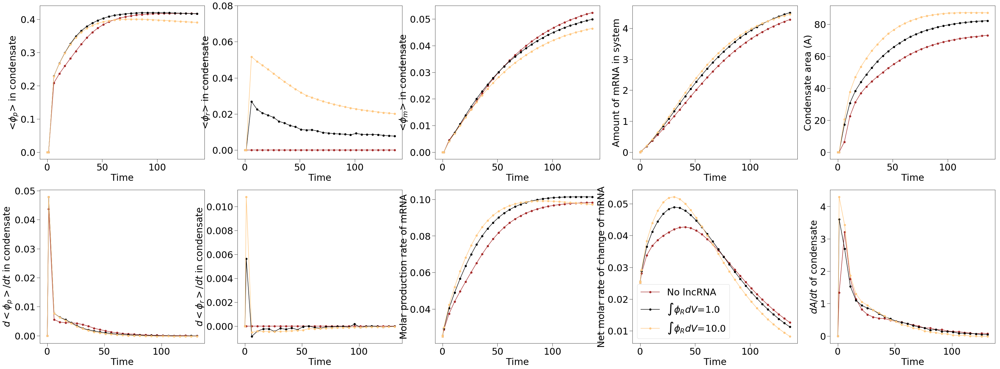

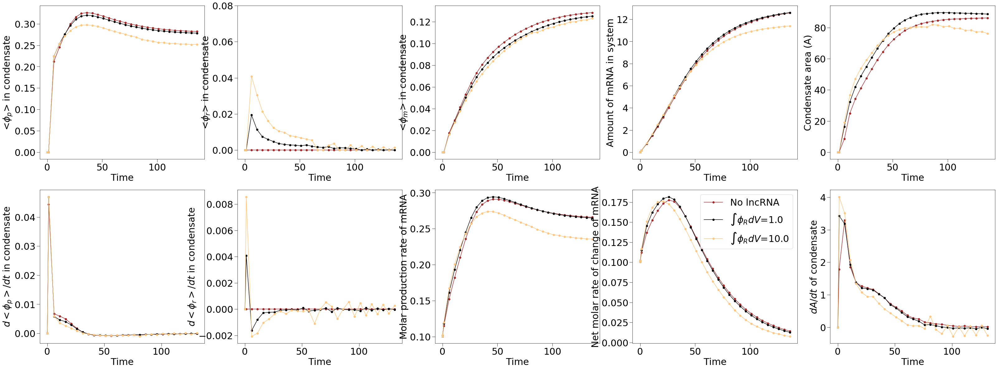

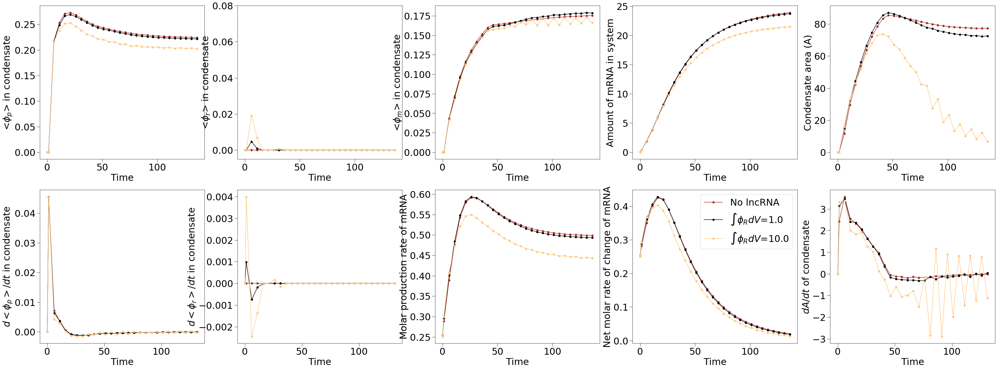

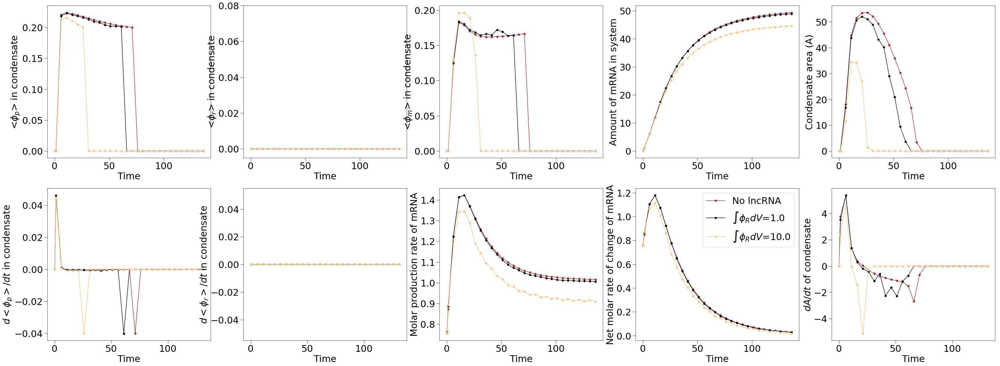

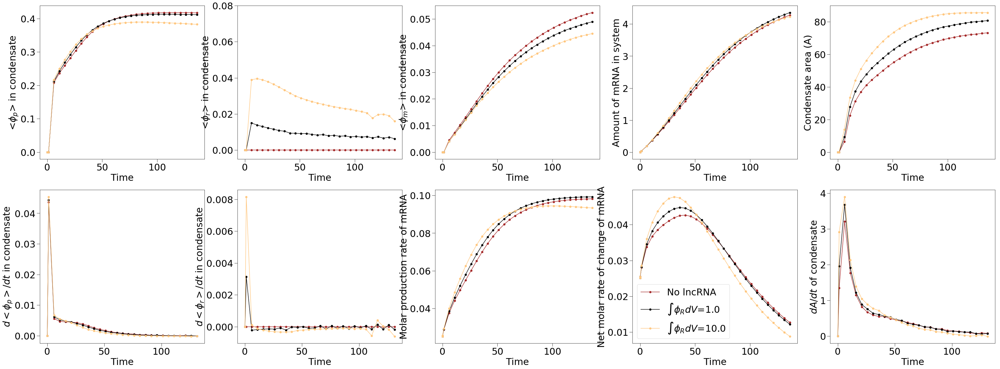

...

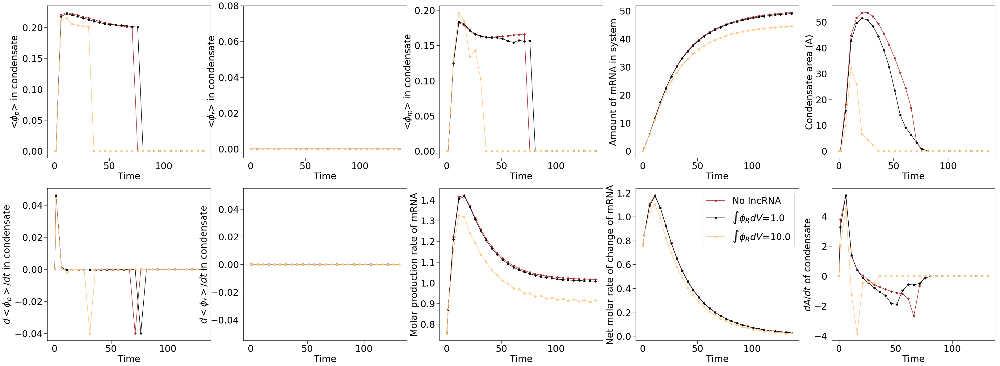

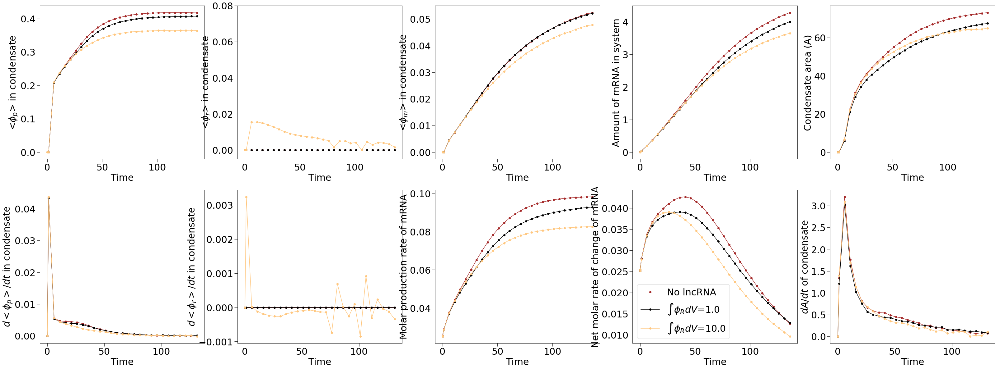

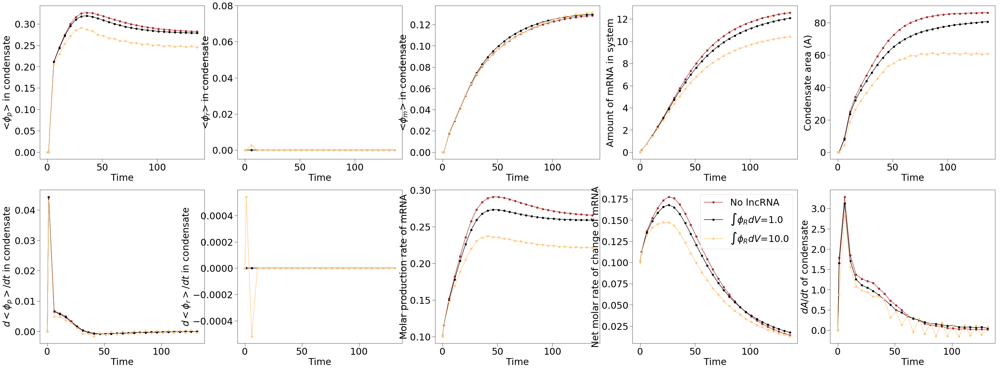

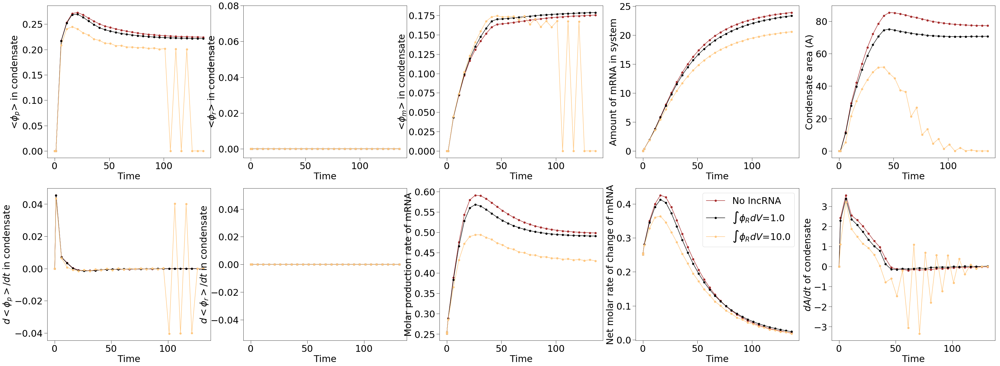

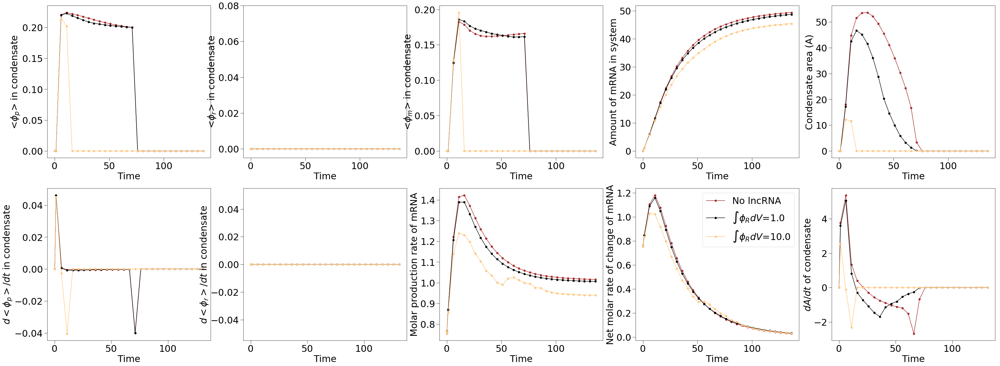

In [38]:
activity_and_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/LOCALIZED_MRNA_PRODUCTION//"
activity_no_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/LOCALIZED_MRNA_PRODUCTION/phi_p_0_0.1_kappa_0.5_sigma_5.0_T_150/"
kp_list = [0.005,0.02,0.05,0.15]
L_P_list = [3.0,5.0,10.0]
phi_r_list = [1.0,10.0]

gray_colors = cm.get_cmap('copper', len(phi_r_list))
color_values = [0.3,0.6]

for k in range(len(L_P_list)):
    for j in range(len(kp_list)):
        
        fig, axs = plt.subplots(2,5,figsize=(55,20))
        
        if kp_list[j] == 0.0:
            only_activity_dynamics_file = activity_no_lncrna_directory + "phi_r_0.0_L_P_0.0_k_p_0.0_reactiontype_2.0_thresh_0.0_FE_5.0_rhoc_20.0_MP_1.0_Mmrna_0.01/dynamical_trajectories.hdf5"
        else:
            only_activity_dynamics_file = activity_no_lncrna_directory + "phi_r_0.0_L_P_0.0_k_p_{}_reactiontype_2.0_thresh_0.0_FE_5.0_rhoc_20.0_MP_1.0_Mmrna_0.01/dynamical_trajectories.hdf5".format(kp_list[j])
        
        with h5py.File(only_activity_dynamics_file) as sp_f: 

            axs[0,0].plot(sp_f['t'],sp_f['average_protein_in_condensate'], '-o', c='brown')
            axs[0,0].set_xlabel('Time', fontsize=30)
            axs[0,0].set_ylabel(r'<$\phi_p$> in condensate', fontsize=30)
            # axs[0,0].set_ylim([0.4,0.6])

            axs[0,1].plot(sp_f['t'],sp_f['average_lncrna_in_condensate'], '-o', c='brown')
            axs[0,1].set_xlabel('Time', fontsize=30)
            axs[0,1].set_ylabel(r'<$\phi_r$> in condensate', fontsize=30)

            axs[0,2].plot(sp_f['t'],sp_f['average_mrna_in_condensate'], '-o', c='brown')
            axs[0,2].set_xlabel('Time', fontsize=30)
            axs[0,2].set_ylabel(r'<$\phi_m$> in condensate', fontsize=30)

            axs[0,3].plot(sp_f['t'],sp_f['total_amount_of_mrna'], '-o', c='brown')
            axs[0,3].set_xlabel('Time', fontsize=30)
            axs[0,3].set_ylabel(r'Amount of mRNA in system', fontsize=30)

            axs[0,4].plot(sp_f['t'],sp_f['condensate_area'], '-o', c='brown')
            axs[0,4].set_xlabel('Time', fontsize=30)
            axs[0,4].set_ylabel(r'Condensate area (A)', fontsize=30)

            p_conc_growth_rate = (sp_f['average_protein_in_condensate'][1:]-sp_f['average_protein_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
            p_conc_growth_rate[p_conc_growth_rate > 0.05] = 0.0
            axs[1,0].plot(sp_f['t'][:-1], p_conc_growth_rate, '-o', c='brown')
            axs[1,0].set_xlabel('Time', fontsize=30)
            axs[1,0].set_ylabel(r'$d<\phi_p>/dt$ in condensate', fontsize=30)

            l_conc_growth_rate = (sp_f['average_lncrna_in_condensate'][1:]-sp_f['average_lncrna_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
            # p_conc_growth_rate[conc_growth_rate > 0.02] = 0.0
            axs[1,1].plot(sp_f['t'][:-1], l_conc_growth_rate, '-o', c='brown')
            axs[1,1].set_xlabel('Time', fontsize=30)
            axs[1,1].set_ylabel(r'$d<\phi_r>/dt$ in condensate', fontsize=30)

            axs[1,2].plot(sp_f['t'],sp_f['molar_rate_of_mrna_production'], '-o', c='brown')
            axs[1,2].set_xlabel('Time', fontsize=30)
            axs[1,2].set_ylabel(r'Molar production rate of mRNA', fontsize=30)

            axs[1,3].plot(sp_f['t'],sp_f['net_rate_of_mrna_increase'], '-o', c='brown', label="No lncRNA")
            axs[1,3].set_xlabel('Time', fontsize=30)
            axs[1,3].set_ylabel(r'Net molar rate of change of mRNA', fontsize=30)  
            axs[1,3].legend(fontsize=30) 

            area_growth_rate = (sp_f['condensate_area'][1:]-sp_f['condensate_area'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
            axs[1,4].plot(sp_f['t'][:-1], area_growth_rate, '-o', c='brown')
            axs[1,4].set_xlabel('Time', fontsize=30)
            axs[1,4].set_ylabel(r'$dA/dt$ of condensate', fontsize=30)

        for i in range(len(phi_r_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_2.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[i],L_P_list[k],kp_list[j]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 

                        axs[0,0].plot(sp_f['t'],sp_f['average_protein_in_condensate'], '-o', c=gray_colors(color_values[i]))
                        axs[0,0].set_xlabel('Time', fontsize=30)
                        axs[0,0].set_ylabel(r'<$\phi_p$> in condensate', fontsize=30)
                        # axs[0,0].set_ylim([0.4,0.7])

                        axs[0,1].plot(sp_f['t'],sp_f['average_lncrna_in_condensate'], '-o', c=gray_colors(color_values[i]))
                        axs[0,1].set_xlabel('Time', fontsize=30)
                        axs[0,1].set_ylabel(r'<$\phi_r$> in condensate', fontsize=30)
                        axs[0,1].set_ylim([-0.005,0.08])
                        
                        axs[0,2].plot(sp_f['t'],sp_f['average_mrna_in_condensate'], '-o', c=gray_colors(color_values[i]))
                        axs[0,2].set_xlabel('Time', fontsize=30)
                        axs[0,2].set_ylabel(r'<$\phi_m$> in condensate', fontsize=30)
                        
                        axs[0,3].plot(sp_f['t'],sp_f['total_amount_of_mrna'], '-o', c=gray_colors(color_values[i]))
                        axs[0,3].set_xlabel('Time', fontsize=30)
                        axs[0,3].set_ylabel(r'Amount of mRNA in system', fontsize=30)
                        
                        axs[0,4].plot(sp_f['t'],sp_f['condensate_area'], '-o', c=gray_colors(color_values[i]))
                        axs[0,4].set_xlabel('Time', fontsize=30)
                        axs[0,4].set_ylabel(r'Condensate area (A)', fontsize=30)
                        
                        p_conc_growth_rate = (sp_f['average_protein_in_condensate'][1:]-sp_f['average_protein_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                        p_conc_growth_rate[p_conc_growth_rate > 0.05] = 0.0
                        axs[1,0].plot(sp_f['t'][:-1], p_conc_growth_rate, '-o', c=gray_colors(color_values[i]))
                        axs[1,0].set_xlabel('Time', fontsize=30)
                        axs[1,0].set_ylabel(r'$d<\phi_p>/dt$ in condensate', fontsize=30)
                        
                        l_conc_growth_rate = (sp_f['average_lncrna_in_condensate'][1:]-sp_f['average_lncrna_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                        # p_conc_growth_rate[conc_growth_rate > 0.02] = 0.0
                        axs[1,1].plot(sp_f['t'][:-1], l_conc_growth_rate, '-o', c=gray_colors(color_values[i]))
                        axs[1,1].set_xlabel('Time', fontsize=30)
                        axs[1,1].set_ylabel(r'$d<\phi_r>/dt$ in condensate', fontsize=30)
                        
                        axs[1,2].plot(sp_f['t'],sp_f['molar_rate_of_mrna_production'], '-o', c=gray_colors(color_values[i]))
                        axs[1,2].set_xlabel('Time', fontsize=30)
                        axs[1,2].set_ylabel(r'Molar production rate of mRNA', fontsize=30)

                        axs[1,3].plot(sp_f['t'],sp_f['net_rate_of_mrna_increase'], '-o', c=gray_colors(color_values[i]), label="$\int \phi_R dV$="+str(phi_r_list[i]))
                        axs[1,3].set_xlabel('Time', fontsize=30)
                        axs[1,3].set_ylabel(r'Net molar rate of change of mRNA', fontsize=30)  
                        axs[1,3].legend(fontsize=30) 

                        area_growth_rate = (sp_f['condensate_area'][1:]-sp_f['condensate_area'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                        axs[1,4].plot(sp_f['t'][:-1], area_growth_rate, '-o', c=gray_colors(color_values[i]))
                        axs[1,4].set_xlabel('Time', fontsize=30)
                        axs[1,4].set_ylabel(r'$dA/dt$ of condensate', fontsize=30)

        # plt.savefig('20210604-CORRECT_FE/Only_activity_linear_0.4_dynamical_trajectories.png', format='png', dpi=1200)
        plt.savefig('20210719-CORRECT_FE_LOCALIZED_MRNA_PRODUCTION/lncrna_and_activity_localized_kP_{}_LP_{}_dynamical_trajectories.svg'.format(kp_list[j],L_P_list[k]), format='svg', dpi=1200)
        plt.show()
        plt.close()

### Active lncRNA

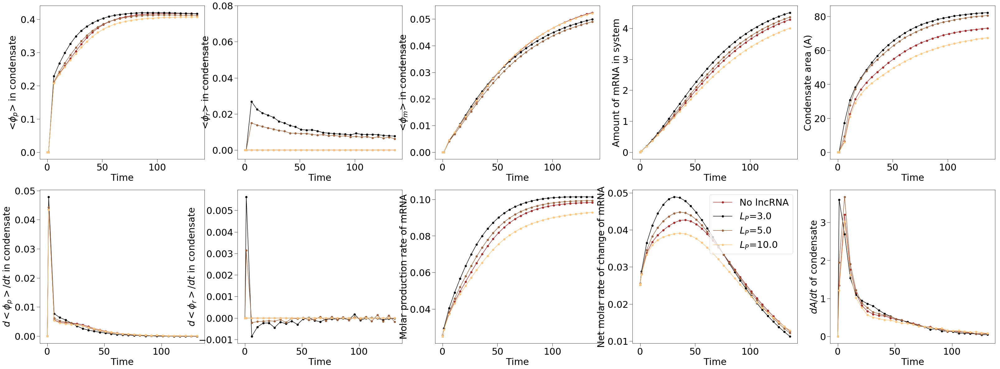

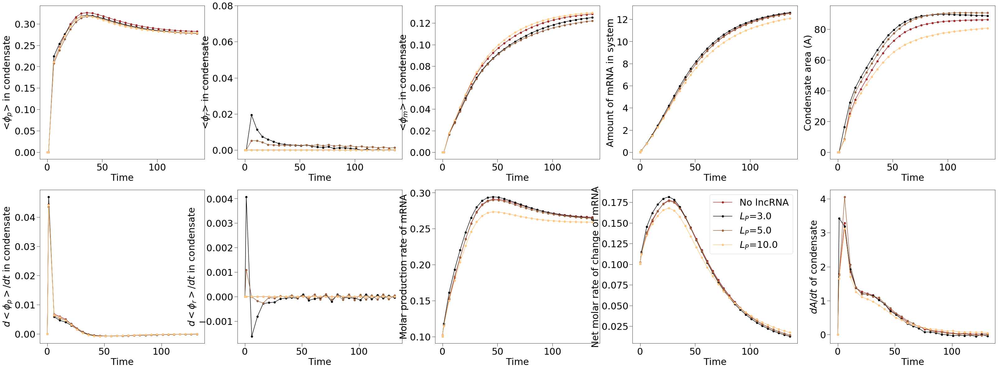

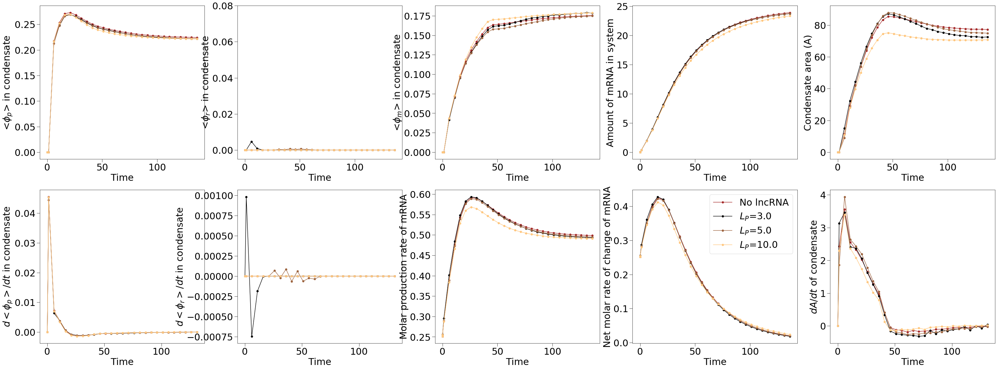

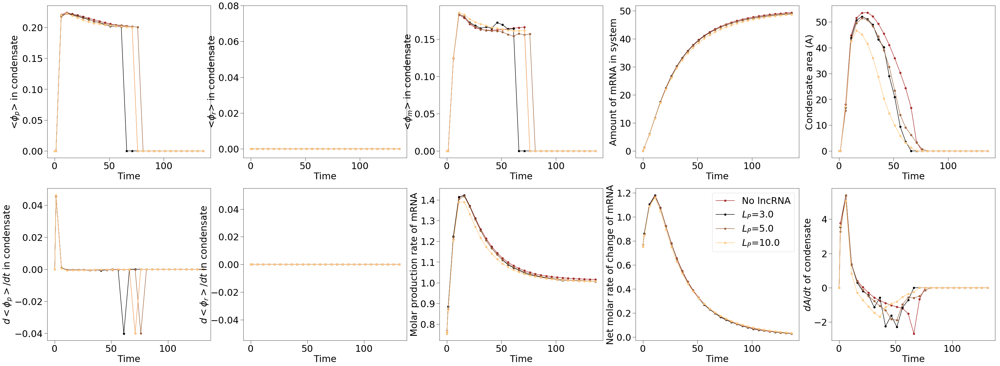

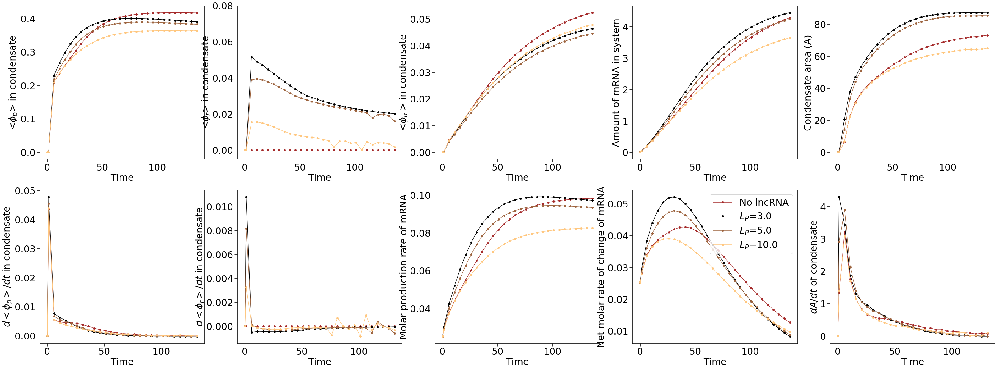

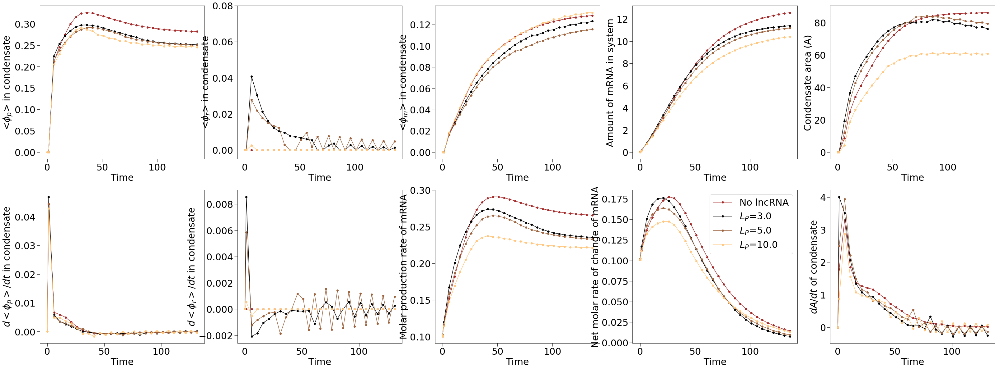

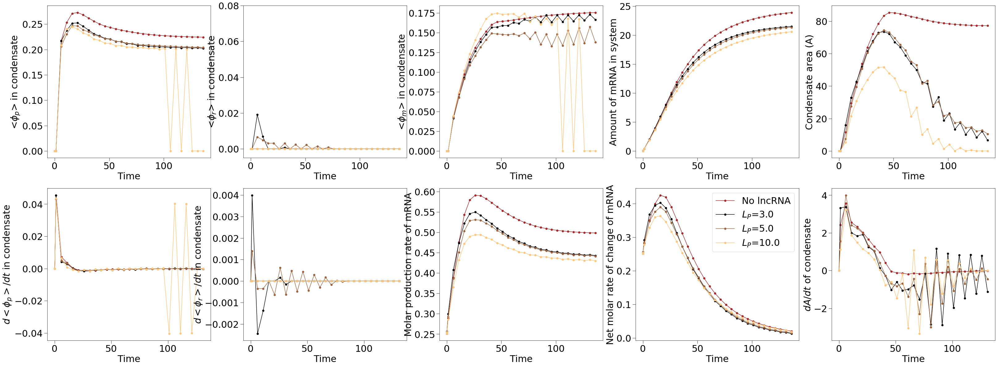

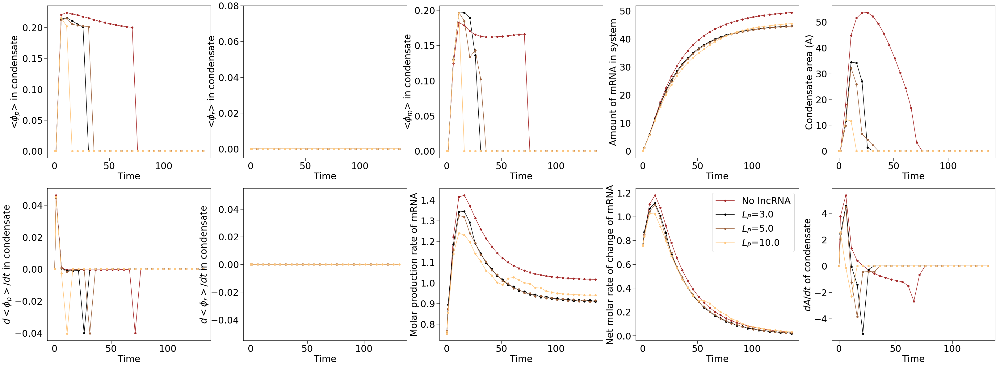

In [41]:
activity_and_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/LOCALIZED_MRNA_PRODUCTION//"
activity_no_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/LOCALIZED_MRNA_PRODUCTION/phi_p_0_0.1_kappa_0.5_sigma_5.0_T_150/"
kp_list = [0.005,0.02,0.05,0.15]
L_P_list = [3.0,5.0,10.0]
phi_r_list = [1.0,10.0]

gray_colors = cm.get_cmap('copper', len(L_P_list))
color_values = [0.3,0.6,0.9]

for i in range(len(phi_r_list)):
    for j in range(len(kp_list)):
        
        fig, axs = plt.subplots(2,5,figsize=(55,20))
        
        if kp_list[j] == 0.0:
            only_activity_dynamics_file = activity_no_lncrna_directory + "phi_r_0.0_L_P_0.0_k_p_0.0_reactiontype_2.0_thresh_0.0_FE_5.0_rhoc_20.0_MP_1.0_Mmrna_0.01/dynamical_trajectories.hdf5"
        else:
            only_activity_dynamics_file = activity_no_lncrna_directory + "phi_r_0.0_L_P_0.0_k_p_{}_reactiontype_2.0_thresh_0.0_FE_5.0_rhoc_20.0_MP_1.0_Mmrna_0.01/dynamical_trajectories.hdf5".format(kp_list[j])
        
        with h5py.File(only_activity_dynamics_file) as sp_f: 

            axs[0,0].plot(sp_f['t'],sp_f['average_protein_in_condensate'], '-o', c='brown')
            axs[0,0].set_xlabel('Time', fontsize=30)
            axs[0,0].set_ylabel(r'<$\phi_p$> in condensate', fontsize=30)
            # axs[0,0].set_ylim([0.4,0.6])

            axs[0,1].plot(sp_f['t'],sp_f['average_lncrna_in_condensate'], '-o', c='brown')
            axs[0,1].set_xlabel('Time', fontsize=30)
            axs[0,1].set_ylabel(r'<$\phi_r$> in condensate', fontsize=30)

            axs[0,2].plot(sp_f['t'],sp_f['average_mrna_in_condensate'], '-o', c='brown')
            axs[0,2].set_xlabel('Time', fontsize=30)
            axs[0,2].set_ylabel(r'<$\phi_m$> in condensate', fontsize=30)

            axs[0,3].plot(sp_f['t'],sp_f['total_amount_of_mrna'], '-o', c='brown')
            axs[0,3].set_xlabel('Time', fontsize=30)
            axs[0,3].set_ylabel(r'Amount of mRNA in system', fontsize=30)

            axs[0,4].plot(sp_f['t'],sp_f['condensate_area'], '-o', c='brown')
            axs[0,4].set_xlabel('Time', fontsize=30)
            axs[0,4].set_ylabel(r'Condensate area (A)', fontsize=30)

            p_conc_growth_rate = (sp_f['average_protein_in_condensate'][1:]-sp_f['average_protein_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
            p_conc_growth_rate[p_conc_growth_rate > 0.05] = 0.0
            axs[1,0].plot(sp_f['t'][:-1], p_conc_growth_rate, '-o', c='brown')
            axs[1,0].set_xlabel('Time', fontsize=30)
            axs[1,0].set_ylabel(r'$d<\phi_p>/dt$ in condensate', fontsize=30)

            l_conc_growth_rate = (sp_f['average_lncrna_in_condensate'][1:]-sp_f['average_lncrna_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
            # p_conc_growth_rate[conc_growth_rate > 0.02] = 0.0
            axs[1,1].plot(sp_f['t'][:-1], l_conc_growth_rate, '-o', c='brown')
            axs[1,1].set_xlabel('Time', fontsize=30)
            axs[1,1].set_ylabel(r'$d<\phi_r>/dt$ in condensate', fontsize=30)

            axs[1,2].plot(sp_f['t'],sp_f['molar_rate_of_mrna_production'], '-o', c='brown')
            axs[1,2].set_xlabel('Time', fontsize=30)
            axs[1,2].set_ylabel(r'Molar production rate of mRNA', fontsize=30)

            axs[1,3].plot(sp_f['t'],sp_f['net_rate_of_mrna_increase'], '-o', c='brown', label="No lncRNA")
            axs[1,3].set_xlabel('Time', fontsize=30)
            axs[1,3].set_ylabel(r'Net molar rate of change of mRNA', fontsize=30)  
            axs[1,3].legend(fontsize=30) 

            area_growth_rate = (sp_f['condensate_area'][1:]-sp_f['condensate_area'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
            axs[1,4].plot(sp_f['t'][:-1], area_growth_rate, '-o', c='brown')
            axs[1,4].set_xlabel('Time', fontsize=30)
            axs[1,4].set_ylabel(r'$dA/dt$ of condensate', fontsize=30)

        for k in range(len(L_P_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_2.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[i],L_P_list[k],kp_list[j]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 

                        axs[0,0].plot(sp_f['t'],sp_f['average_protein_in_condensate'], '-o', c=gray_colors(color_values[k]))
                        axs[0,0].set_xlabel('Time', fontsize=30)
                        axs[0,0].set_ylabel(r'<$\phi_p$> in condensate', fontsize=30)
                        # axs[0,0].set_ylim([0.4,0.7])

                        axs[0,1].plot(sp_f['t'],sp_f['average_lncrna_in_condensate'], '-o', c=gray_colors(color_values[k]))
                        axs[0,1].set_xlabel('Time', fontsize=30)
                        axs[0,1].set_ylabel(r'<$\phi_r$> in condensate', fontsize=30)
                        axs[0,1].set_ylim([-0.005,0.08])
                        
                        axs[0,2].plot(sp_f['t'],sp_f['average_mrna_in_condensate'], '-o', c=gray_colors(color_values[k]))
                        axs[0,2].set_xlabel('Time', fontsize=30)
                        axs[0,2].set_ylabel(r'<$\phi_m$> in condensate', fontsize=30)
                        
                        axs[0,3].plot(sp_f['t'],sp_f['total_amount_of_mrna'], '-o', c=gray_colors(color_values[k]))
                        axs[0,3].set_xlabel('Time', fontsize=30)
                        axs[0,3].set_ylabel(r'Amount of mRNA in system', fontsize=30)
                        
                        axs[0,4].plot(sp_f['t'],sp_f['condensate_area'], '-o', c=gray_colors(color_values[k]))
                        axs[0,4].set_xlabel('Time', fontsize=30)
                        axs[0,4].set_ylabel(r'Condensate area (A)', fontsize=30)
                        
                        p_conc_growth_rate = (sp_f['average_protein_in_condensate'][1:]-sp_f['average_protein_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                        p_conc_growth_rate[p_conc_growth_rate > 0.05] = 0.0
                        axs[1,0].plot(sp_f['t'][:-1], p_conc_growth_rate, '-o', c=gray_colors(color_values[k]))
                        axs[1,0].set_xlabel('Time', fontsize=30)
                        axs[1,0].set_ylabel(r'$d<\phi_p>/dt$ in condensate', fontsize=30)
                        
                        l_conc_growth_rate = (sp_f['average_lncrna_in_condensate'][1:]-sp_f['average_lncrna_in_condensate'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                        # p_conc_growth_rate[conc_growth_rate > 0.02] = 0.0
                        axs[1,1].plot(sp_f['t'][:-1], l_conc_growth_rate, '-o', c=gray_colors(color_values[k]))
                        axs[1,1].set_xlabel('Time', fontsize=30)
                        axs[1,1].set_ylabel(r'$d<\phi_r>/dt$ in condensate', fontsize=30)
                        
                        axs[1,2].plot(sp_f['t'],sp_f['molar_rate_of_mrna_production'], '-o', c=gray_colors(color_values[k]))
                        axs[1,2].set_xlabel('Time', fontsize=30)
                        axs[1,2].set_ylabel(r'Molar production rate of mRNA', fontsize=30)

                        axs[1,3].plot(sp_f['t'],sp_f['net_rate_of_mrna_increase'], '-o', c=gray_colors(color_values[k]), label="$L_P$="+str(L_P_list[k]))
                        axs[1,3].set_xlabel('Time', fontsize=30)
                        axs[1,3].set_ylabel(r'Net molar rate of change of mRNA', fontsize=30)  
                        axs[1,3].legend(fontsize=30) 

                        area_growth_rate = (sp_f['condensate_area'][1:]-sp_f['condensate_area'][:-1])*(sp_f['t'][1:]-sp_f['t'][:-1])**(-1)
                        axs[1,4].plot(sp_f['t'][:-1], area_growth_rate, '-o', c=gray_colors(color_values[k]))
                        axs[1,4].set_xlabel('Time', fontsize=30)
                        axs[1,4].set_ylabel(r'$dA/dt$ of condensate', fontsize=30)

        # plt.savefig('20210604-CORRECT_FE/Only_activity_linear_0.4_dynamical_trajectories.png', format='png', dpi=1200)
        plt.savefig('20210719-CORRECT_FE_LOCALIZED_MRNA_PRODUCTION/lncrna_and_activity_localized_kP_{}_phir_{}_dynamical_trajectories.svg'.format(kp_list[j],phi_r_list[i]), format='svg', dpi=1200)
        plt.show()
        plt.close()

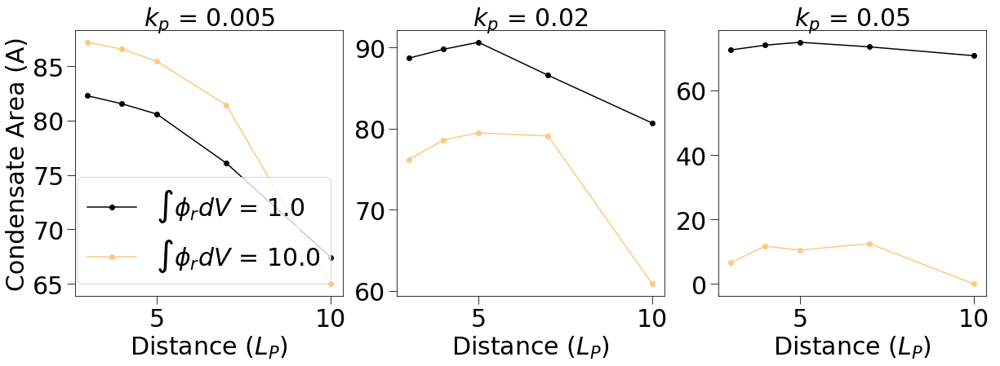

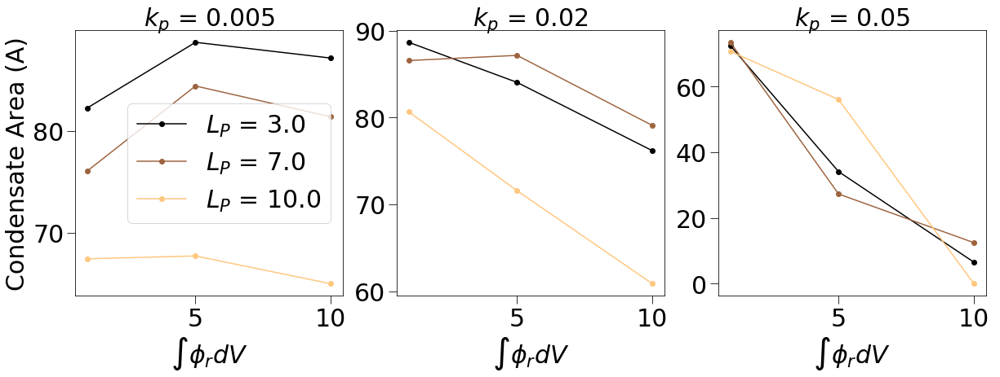

In [47]:
activity_and_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/LOCALIZED_MRNA_PRODUCTION//"
activity_no_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/LOCALIZED_MRNA_PRODUCTION/phi_p_0_0.1_kappa_0.5_sigma_5.0_T_150/"
kp_list = [0.005,0.02,0.05]
L_P_list = [3.0,4.0,5.0,7.0,10.0]
phi_r_list = [1.0,10.0]

dynamical_variable_name = 'condensate_area'
gray_colors = cm.get_cmap('copper', len(phi_r_list))
color_values = [0.4,0.8]

#################################

fig, axs = plt.subplots(1,len(kp_list),figsize=(20,6))
for i in range(len(kp_list)):
    for k in range(len(phi_r_list)):
        ss_values = np.zeros(len(L_P_list))
        for j in range(len(L_P_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_2.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[j] = sp_f[dynamical_variable_name][-1]
        axs[i].plot(L_P_list, ss_values, '-o', label='$\int\phi_rdV$ = '+str(phi_r_list[k]), c=gray_colors(color_values[k]))
    axs[i].set_xlabel('Distance ($L_P$)',fontsize=30)
    axs[0].set_ylabel('Condensate Area (A)',fontsize=30)
    axs[i].set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=30)
    axs[0].legend()

plt.savefig('20210719-CORRECT_FE_LOCALIZED_MRNA_PRODUCTION/lncrna_steady_state_vs_LP_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

L_P_list = [3.0,7.0,10.0]
phi_r_list = [1.0,5.0,10.0]

gray_colors = cm.get_cmap('copper', len(L_P_list))
color_values = [0.2,0.6,1.0]

fig, axs = plt.subplots(1,len(kp_list),figsize=(20,6))
for i in range(len(kp_list)):
    for j in range(len(L_P_list)):
        ss_values = np.zeros(len(phi_r_list))
        for k in range(len(phi_r_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_2.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[k] = sp_f[dynamical_variable_name][-1]
        axs[i].plot(phi_r_list, ss_values, '-o', label=r'$L_P$ = '+str(L_P_list[j]), c=gray_colors(color_values[j]))
    axs[i].set_xlabel('$\int\phi_rdV$',fontsize=30)
    axs[0].set_ylabel('Condensate Area (A)',fontsize=30)
    axs[i].set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=30)
    axs[0].legend()

plt.savefig('20210719-CORRECT_FE_LOCALIZED_MRNA_PRODUCTION/lncrna_steady_state_vs_phir_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

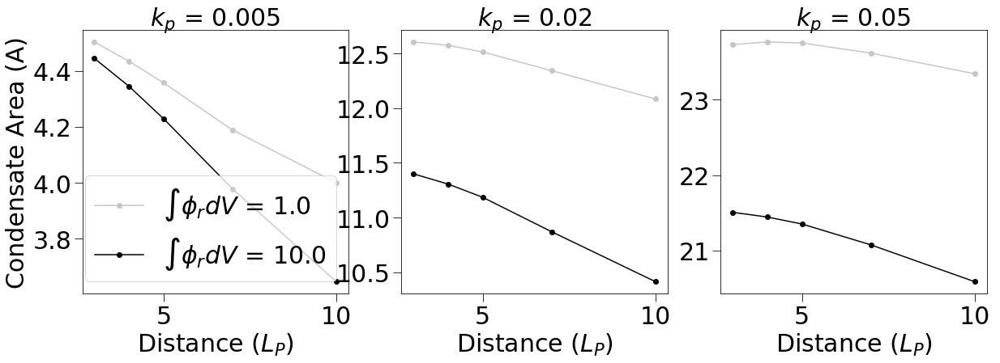

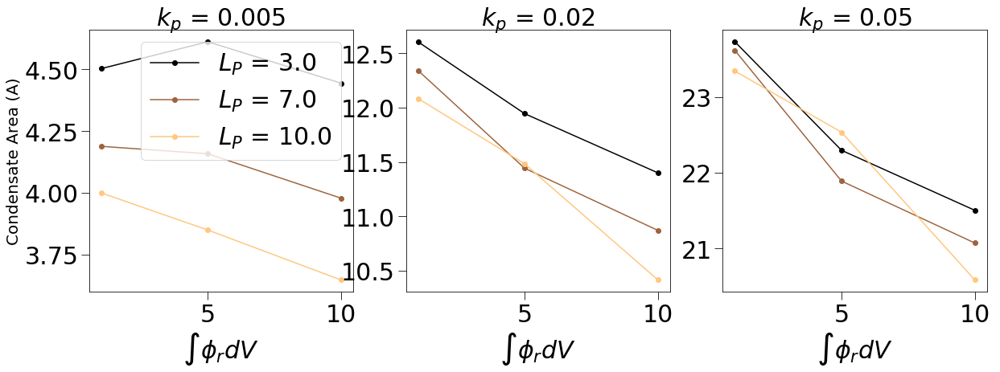

In [48]:
activity_and_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/LOCALIZED_MRNA_PRODUCTION//"
activity_no_lncrna_directory = "/nobackup1c/users/npradeep96/PhaseField/LNCRNA_AND_ACTIVITY/LNCRNA_COUPLED_WITH_ACTIVITY/ONLY_ACTIVITY/LOCALIZED_MRNA_PRODUCTION/phi_p_0_0.1_kappa_0.5_sigma_5.0_T_150/"
kp_list = [0.005,0.02,0.05]
L_P_list = [3.0,4.0,5.0,7.0,10.0]
phi_r_list = [1.0,10.0]

gray_colors = cm.get_cmap('copper', len(phi_r_list))
color_values = [0.4,0.8]

#################################

dynamical_variable_name = 'total_amount_of_mrna'
gray_colors = cm.get_cmap('Greys', len(phi_r_list)+5)
color_values = np.linspace(0.3,0.9,len(phi_r_list))

fig, axs = plt.subplots(1,len(kp_list),figsize=(20,6))
for i in range(len(kp_list)):
    for k in range(len(phi_r_list)):
        ss_values = np.zeros(len(L_P_list))
        for j in range(len(L_P_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_2.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[j] = sp_f[dynamical_variable_name][-1]
        axs[i].plot(L_P_list, ss_values, '-o', label='$\int\phi_rdV$ = '+str(phi_r_list[k]), c=gray_colors(color_values[k]))
    axs[i].set_xlabel('Distance ($L_P$)',fontsize=30)
    axs[0].set_ylabel('Condensate Area (A)',fontsize=30)
    axs[i].set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=30)
    axs[0].legend()

plt.savefig('20210719-CORRECT_FE_LOCALIZED_MRNA_PRODUCTION/lncrna_steady_state_vs_LP_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()

L_P_list = [3.0,7.0,10.0]
phi_r_list = [1.0,5.0,10.0]

gray_colors = cm.get_cmap('copper', len(L_P_list))
color_values = [0.2,0.6,1.0]

dynamical_variable_name = 'total_amount_of_mrna'

fig, axs = plt.subplots(1,len(kp_list),figsize=(20,6))
for i in range(len(kp_list)):
    for j in range(len(L_P_list)):
        ss_values = np.zeros(len(phi_r_list))
        for k in range(len(phi_r_list)):
            for root, dirs, files in os.walk(activity_and_lncrna_directory):
                regex = re.compile(r'.*phi_r_{}_.*L_P_{}_k_p_{}_reactiontype_2.0_thresh_0.0_FE_7.0_rhoc_10.0_MP_1.0_Mmrna_0.01_M_rna_2.0$'.format(phi_r_list[k],L_P_list[j],kp_list[i]))
                match = re.search(regex, root)
                if match != None:
                    with h5py.File(root + '/dynamical_trajectories.hdf5') as sp_f: 
                        ss_values[k] = sp_f[dynamical_variable_name][-1]
        axs[i].plot(phi_r_list, ss_values, '-o', label=r'$L_P$ = '+str(L_P_list[j]), c=gray_colors(color_values[j]))
    axs[i].set_xlabel('$\int\phi_rdV$',fontsize=30)
    axs[0].set_ylabel('Condensate Area (A)',fontsize=20)
    axs[i].set_title(r'$k_p$ = ' + str(kp_list[i]), fontsize=30)
    axs[0].legend()

plt.savefig('20210719-CORRECT_FE_LOCALIZED_MRNA_PRODUCTION/lncrna_steady_state_vs_phir_'+dynamical_variable_name+'.svg', format='svg', dpi=1200)
plt.show()
plt.close()